In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import scipy.stats as stats
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib import cm
import matplotlib.colors as colors
from matplotlib.patches import Rectangle
from matplotlib.patches import Polygon
from Bio.Seq import Seq

## Importing genotype frequency data

In [3]:
counts_all = pd.read_csv("SortSeq_data/counts_all_SortSeq_25-02.csv")
info_file = pd.read_csv("SortSeq_data/Libs_info_SortSeq_25-02-18_SA.csv")

counts_all = counts_all.drop(columns=['Mut_categories', 'n_mutated'])

## Computing expression scores and filtering genotypes

### Preparing dictionaries and functions to compute "expression scores" for all genotypes

In [6]:
# Getting lists of sample names, biological replicates and technical replicates
sample_names = list(info_file['Sample_name'].apply(lambda x: x.split('_')[0]).unique())
bio_reps = [f'b{x}' for x in list(info_file['Bio_rep'].unique())]
tech_reps = ['t1', 't2']

In [7]:
# Preparing dictionaries giving 'expression value' and number of sorted cells for each kind of sample
exp_dict = {'dead_N': 0, 'weak_N': 1, 'medweak_N': 2,
           'medstrong_N': 3, 'strong_N': 4}
cell_dict= {'dead_N': 10000, 'weak_N': 10000, 'medweak_N': 50000,
           'medstrong_N': 50000, 'strong_N': 10000}

In [8]:
# Defining functions to compute a weighted average of bins for each genotype, serving as an expression score

def calc_mean_bin(df, col_exp_dict, total_cols, freq_norm=False):
    """Calculate weighted average of bins, without normalizing by the number of sorted cells."""
    mean_num = 0
    mean_denom = 0
    for col in df.columns:
        if freq_norm:
            mean_term = df[col] / total_cols[f"{col.split('_')[0]}_Total"]
            mean_num += col_exp_dict[col] * mean_term
            mean_denom += mean_term

        else:
            mean_term = df[col]
            mean_num += mean_term * col_exp_dict[col]
            mean_denom += mean_term

    mean_bin = mean_num / mean_denom

    return mean_bin


def calc_bin_cell_norm(df, col_exp_dict, col_cell_dict, total_cols, freq_norm=False):
    """Calculate weighted average of bins, while normalizing by the number of sorted cells."""
    mean_num = 0
    mean_denom = 0
    cell_tot = np.sum(list(col_cell_dict.values()))
    for col in df.columns:
        cell_num = col_cell_dict[col]
        if freq_norm:
            mean_term = (df[col] / total_cols[f"{col.split('_')[0]}_Total"]) * (cell_num / cell_tot)
            mean_num += col_exp_dict[col] * mean_term
            mean_denom += mean_term

        else:
            mean_term = df[col] * (cell_num / cell_tot)
            mean_num += col_exp_dict[col] * mean_term
            mean_denom += mean_term

    mean_bin = mean_num / mean_denom

    return mean_bin
    

### Computing expression scores

In [10]:
sort_model = pd.DataFrame(columns=['Bio_rep', 'Tech_rep', 'Lib_code', 'Genotype', 'Mutation type', 'Position',
                                   'T0_N', 'T0_Total', 'dead_N', 'dead_Total', 'weak_N',
                                   'weak_Total', 'medweak_N', 'medweak_Total', 'medstrong_N', 
                                   'medstrong_Total', 'strong_N', 'strong_Total', 'Reads_all_bins',
                                   'Mean_bin', 'Mean_cell_norm', 'WT_bin', 'WT_cell_norm',
                                   'Diff_bin', 'Diff_bin_cell_norm'])

sort_all = sort_model.copy()

for bio_id in bio_reps:

    for tech_id in tech_reps:
        current_df = pd.DataFrame(columns=['Bio_rep', 'Tech_rep', 'Genotype', 'Mutation type', 'Position'])

        for samp_type in sample_names:
            if samp_type == 'T0':
                lib_name = f'{samp_type}_{bio_id}'

            else:
                lib_name = f'{samp_type}_{bio_id}_{tech_id}'

            lib_subset = counts_all[counts_all['Library'] == lib_name].copy().reset_index(drop=True)
            lib_subset = lib_subset[['Genotype', 'Mutation type', 'Position', 'N_reads', 'Total_reads']].copy()
            lib_subset = lib_subset.rename(columns={'N_reads': f'{samp_type}_N', 'Total_reads': f'{samp_type}_Total'})
            lib_subset['Bio_rep'] = bio_id[-1]
            lib_subset['Tech_rep'] = tech_id[-1]
            current_df = pd.merge(current_df, lib_subset, on=['Bio_rep', 'Tech_rep','Genotype', 'Mutation type', 'Position'], how='outer')

        # Filling in the na values
        for col_type in sample_names:
            mean_tofill = np.mean(current_df[f'{col_type}_Total'].dropna())
            current_df[f'{col_type}_Total'] = current_df[f'{col_type}_Total'].fillna(mean_tofill)

        current_df = current_df.fillna(0)
        
        current_df['Reads_all_bins'] = current_df[['dead_N', 'weak_N', 'medweak_N', 'medstrong_N', 'strong_N']].sum(axis=1)
        current_df['Mean_cell_norm'] = calc_bin_cell_norm(current_df[['dead_N', 'weak_N', 'medweak_N', 'medstrong_N', 'strong_N']],
                                                    exp_dict, cell_dict, current_df[['dead_Total', 'weak_Total', 'medweak_Total',
                                                                                     'medstrong_Total', 'strong_Total']], freq_norm=True)
        current_df['Mean_bin'] = calc_mean_bin(current_df[['dead_N', 'weak_N', 'medweak_N', 'medstrong_N', 'strong_N']],
                                                     exp_dict, current_df[['dead_Total', 'weak_Total', 'medweak_Total',
                                                                           'medstrong_Total', 'strong_Total']], freq_norm=True)
        wt_slice = current_df[current_df['Genotype'] == 'WT'].copy()
        wt_bin = wt_slice['Mean_bin'].values[0]
        wt_bin_norm = wt_slice['Mean_cell_norm'].values[0]

        current_df['WT_bin'] = wt_bin
        current_df['WT_cell_norm'] = wt_bin_norm
        current_df['Diff_bin'] = current_df['Mean_bin'] - current_df['WT_bin']
        current_df['Diff_bin_cell_norm'] = current_df['Mean_cell_norm'] - current_df['WT_cell_norm']

        sort_all = pd.concat([sort_all, current_df]).reset_index(drop=True)

sort_all['Lib_code'] = sort_all['Bio_rep'] + '-' + sort_all['Tech_rep']

C:\Users\tiger\AppData\Local\Temp\ipykernel_40172\3229865814.py:52: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  sort_all = pd.concat([sort_all, current_df]).reset_index(drop=True)


**'Diff_bin_cell_norm' is what is known as 'Delta_Ref' in the paper**

### Computing expression scores, but excluding reads from the 'dead' bin

The 'dead' bins may be outliers. Their sequencing coverage is about 3 M reads per library, while other samples are on the order of 700k reads per library. It it thus worthwhile to also compute expression scores without taking it into consideration, especially since these samples should mostly contain resistance-conferring secondary mutations in the first 42 bp of the FCY1 CDS.

In [14]:
# Computing the weighted means
sort_all['Mean_bin_NoDead'] = calc_mean_bin(sort_all[['weak_N', 'medweak_N', 'medstrong_N', 'strong_N']], exp_dict,
                                            sort_all[['weak_Total', 'medweak_Total', 'medstrong_Total', 'strong_Total']], freq_norm=True)

sort_all['Mean_norm_NoDead'] = calc_bin_cell_norm(sort_all[['weak_N', 'medweak_N', 'medstrong_N', 'strong_N']], exp_dict,
                                                  cell_dict, sort_all[['weak_Total', 'medweak_Total', 'medstrong_Total', 'strong_Total']], freq_norm=True)

# To add the WT columns
for row_num in range(sort_all.shape[0]):
    lib_id = sort_all.at[row_num, 'Lib_code']
    wt_subset = sort_all[(sort_all['Lib_code'] == lib_id) & (sort_all['Genotype'] == 'WT')]
    if wt_subset.shape[0] != 1:
        raise Exception("There should be only one WT")

    wt_bin = wt_subset['Mean_bin_NoDead'].values[0]
    sort_all.at[row_num, 'WT_bin_NoDead'] = wt_bin
    wt_norm = wt_subset['Mean_norm_NoDead'].values[0]
    sort_all.at[row_num, 'WT_norm_NoDead'] = wt_norm

# Adding the corresponding Delta scores
sort_all['Diff_NoDead'] = sort_all['Mean_bin_NoDead'] - sort_all['WT_bin_NoDead']
sort_all['Diff_norm_NoDead'] = sort_all['Mean_norm_NoDead'] - sort_all['WT_norm_NoDead']

### Filtering genotypes based on abundance

This is done at the end, so that expression scores are available for all detected genotypes (and not simply for the ones clearing the abundance threshold)

#### Looking at the distribution of total read counts (all bins) for each genotype, with and without the dead bin:

In [18]:
# Identifying mutations which are within the F3-F4 region
F3F4_300_coords = (52, 205)
sort_all['In_F3F4'] = sort_all['Position'].apply(lambda x: F3F4_300_coords[0] <= x <= F3F4_300_coords[1])

F:\Anaconda_SA\envs\FCY1prom_final\Lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
F:\Anaconda_SA\envs\FCY1prom_final\Lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Text(0.5, 1.0, "Without 'dead' bin")

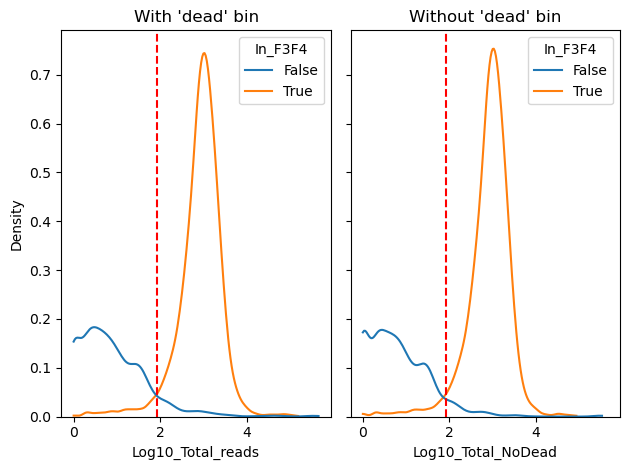

In [19]:
fig, axs = plt.subplots(1, 2, sharex=True, sharey=True, tight_layout=True)

# When the 'dead' bin is included
sort_all['Log10_Total_reads'] = np.log10(sort_all['Reads_all_bins'])
sns.kdeplot(data=sort_all, x='Log10_Total_reads', cut=0, ax=axs[0], hue='In_F3F4')
axs[0].axvline(x=np.log10(85), c='red', linestyle='--')
axs[0].set_title("With 'dead' bin")

# When the 'dead' bin is excluded
sort_all['Reads_all_NoDead'] = sort_all['Reads_all_bins'] - sort_all['dead_N']
sort_all['Log10_Total_NoDead'] = np.log10(sort_all['Reads_all_NoDead'])
sns.kdeplot(data=sort_all, x='Log10_Total_NoDead', cut=0, ax=axs[1], hue='In_F3F4')
axs[1].axvline(x=np.log10(85), c='red', linestyle='--')
axs[1].set_title("Without 'dead' bin")

In both cases, a threshold of 85 reads (total across all bins) seems very good at selecting the variants which were intended to be included in the library (F3-F4). This values will thus be used.

In [21]:
# Making dataframes containing only "filtered" genotypes
sort_all_filtered = sort_all[sort_all['Reads_all_bins'] >= 85].copy().reset_index(drop=True)
sort_NoDead_filtered = sort_all[sort_all['Reads_all_NoDead'] >= 85].copy().reset_index(drop=True)

In [22]:
# All variants which were called within the mEGFP sequence are also removed from these dataframes
sort_all_filtered = sort_all_filtered[sort_all_filtered['Position'] <= 247].copy().reset_index(drop=True)
sort_NoDead_filtered = sort_NoDead_filtered[sort_NoDead_filtered['Position'] <= 247].copy().reset_index(drop=True)

#### Assessing the coverage of F3-F4 variants following the abundance-based filtering

Defining a function to generate the F3-F4 sequence corresponding to any genotype code:

In [25]:
def get_mut_sequence(mut_code, ref_seq, ref_start):
    """The ref_start parameter should be the index of the first position of ref_seq, using the same referential
       as in the mut_code string."""

    # Extracting the important info from the mut_code
    mut_type = mut_code.split('-')[0]
    mut_pos = int(mut_code.split('-')[1].split('_')[0])
    mut_length = int(mut_code.split('-')[1].split('_')[1].split('nt')[0])
    new_nt = mut_code.split('to')[1]

    if mut_pos < ref_start:
        raise Exception('The mutated position is not included in the provided reference sequence!')

    if mut_length != 1:
        raise Exception('This function is only designed to handle single-nucleotide mutations!')

    # If deletion, replace the new_nt by an empty string
    if new_nt == '-':
        new_nt = ''

    # Generate the mutated sequence, depending on the type of mutation
    pos_to_mut = mut_pos - ref_start
    if mut_type == 'S' or mut_type == 'D':
        new_seq = ref_seq[0:pos_to_mut] + new_nt + ref_seq[pos_to_mut+1:]

    elif mut_type == 'I':
        new_seq = ref_seq[0:pos_to_mut+1] + new_nt + ref_seq[pos_to_mut+1:]

    return new_seq

Using the function to generate the corresponding F3-F4 sequence for each mutant

In [27]:
F3F4_ref = "attccttgcaggggcggtagtacccggagaccctgaacttttctttttttttttgcgaaattaaaaagttcattttcaattcgacaatgagatctacaagccattgttttatgttgatgagagccagcttaaagagttaaaaatttcatagcta".upper()

sort_F3F4_filtered = sort_all_filtered[sort_all_filtered['In_F3F4']].copy().reset_index(drop=True)
sort_F3F4_filtered['F3F4_seq'] = sort_F3F4_filtered['Genotype'].apply(get_mut_sequence, args=(F3F4_ref, 52))

sort_F3F4_NoDead = sort_NoDead_filtered[sort_NoDead_filtered['In_F3F4']].copy().reset_index(drop=True)
sort_F3F4_NoDead['F3F4_seq'] = sort_F3F4_NoDead['Genotype'].apply(get_mut_sequence, args=(F3F4_ref, 52))

Generating all the possible single-nucleotide mutants in the F3-F4 region

In [29]:
all_seqs = set()

for mut_pos in range(len(F3F4_ref)):

    # All possible substitutions amnd insertions at that position
    for nt_base in ['A', 'T', 'G', 'C']:
        mut_sub = F3F4_ref[0: mut_pos] + nt_base + F3F4_ref[mut_pos+1:]

        if mut_sub != F3F4_ref:
            all_seqs = all_seqs.union(set([mut_sub]))

        mut_ins = F3F4_ref[0: mut_pos+1] + nt_base + F3F4_ref[mut_pos+1:]
        all_seqs = all_seqs.union(set([mut_ins]))
            
    # Deletion of the corresponding base
    mut_del = F3F4_ref[0: mut_pos] + '' + F3F4_ref[mut_pos+1:]
    all_seqs = all_seqs.union(set([mut_del]))

For each sample, compute how many of the sequences are included in the 'filtered' dataset:

In [31]:
cover_df = pd.DataFrame(columns=['Lib_code', 'n_muts_all', 'percent_muts_all', 'n_muts_NoDead', 'percent_muts_NoDead'])
n_iter = 0

for lib_id in sort_F3F4_filtered['Lib_code'].unique():
    all_subset = sort_F3F4_filtered[sort_F3F4_filtered['Lib_code'] == lib_id].copy().reset_index(drop=True)
    n_all = len(set(all_subset['F3F4_seq'].unique()).intersection(all_seqs))
    percent_all = (n_all / len(all_seqs))*100

    NoDead_subset = sort_F3F4_NoDead[sort_F3F4_NoDead['Lib_code'] == lib_id].copy().reset_index(drop=True)
    n_NoDead = len(set(NoDead_subset['F3F4_seq'].unique()).intersection(all_seqs))
    percent_NoDead = (n_NoDead / len(all_seqs))*100

    cover_df.at[n_iter, 'Lib_code'] = lib_id
    cover_df.at[n_iter, 'n_muts_all'] = n_all
    cover_df.at[n_iter, 'percent_muts_all'] = percent_all
    cover_df.at[n_iter, 'n_muts_NoDead'] = n_NoDead
    cover_df.at[n_iter, 'percent_muts_NoDead'] = percent_NoDead

    n_iter += 1

In [32]:
cover_df

,Lib_code,n_muts_all,percent_muts_all,n_muts_NoDead,percent_muts_NoDead
0,1-1,967,94.711068,966,94.613124
1,1-2,974,95.39667,974,95.39667
2,2-1,982,96.180215,979,95.886386
3,2-2,973,95.298727,971,95.10284
4,3-1,964,94.417238,963,94.319295
5,3-2,965,94.515181,964,94.417238


**We have a very good coverage of all F3-F4 single-nucleotide mutations, even after the abundance-based filtering of genotypes!!**

What does it look like on a per-bin basis?

In [35]:
cover_per_bin = pd.DataFrame(columns=['Lib_code', 'n_muts_all', 'percent_muts_all', 'n_muts_NoDead', 'percent_muts_NoDead', 'Exp_bin'])
n_iter = 0

for lib_id in sort_F3F4_filtered['Lib_code'].unique():
    all_subset = sort_F3F4_filtered[sort_F3F4_filtered['Lib_code'] == lib_id].copy().reset_index(drop=True)
    NoDead_subset = sort_F3F4_NoDead[sort_F3F4_NoDead['Lib_code'] == lib_id].copy().reset_index(drop=True)


    for bin_type in ['dead', 'weak', 'medweak', 'medstrong', 'strong']:
        all_enough = all_subset[all_subset[f'{bin_type}_N'] >= 85].copy().reset_index(drop=True)
        n_all = len(set(all_enough['F3F4_seq'].unique()).intersection(all_seqs))
        percent_all = (n_all / len(all_seqs))*100

        NoDead_enough = NoDead_subset[NoDead_subset[f'{bin_type}_N'] >=85].copy().reset_index(drop=True)
        n_NoDead = len(set(NoDead_enough['F3F4_seq'].unique()).intersection(all_seqs))
        percent_NoDead = (n_NoDead / len(all_seqs))*100

        cover_per_bin.at[n_iter, 'Lib_code'] = lib_id
        cover_per_bin.at[n_iter, 'n_muts_all'] = n_all
        cover_per_bin.at[n_iter, 'percent_muts_all'] = percent_all
        cover_per_bin.at[n_iter, 'n_muts_NoDead'] = n_NoDead
        cover_per_bin.at[n_iter, 'percent_muts_NoDead'] = percent_NoDead
        cover_per_bin.at[n_iter, 'Exp_bin'] = bin_type
        
        n_iter += 1

Text(0.5, 1.0, 'Coverage of F3-F4 variants')

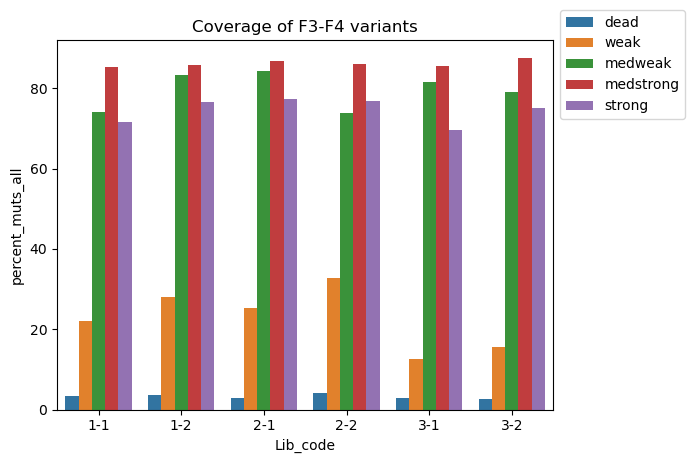

In [36]:
bars_all = sns.barplot(data=cover_per_bin, x='Lib_code', y='percent_muts_all', hue='Exp_bin')
bars_all.legend(loc='upper left', bbox_to_anchor=(1.0, 1.10))
bars_all.set_title('Coverage of F3-F4 variants')

Text(0.5, 1.0, "Coverage of F3-F4 variants, when 'dead' is ignored for filtering")

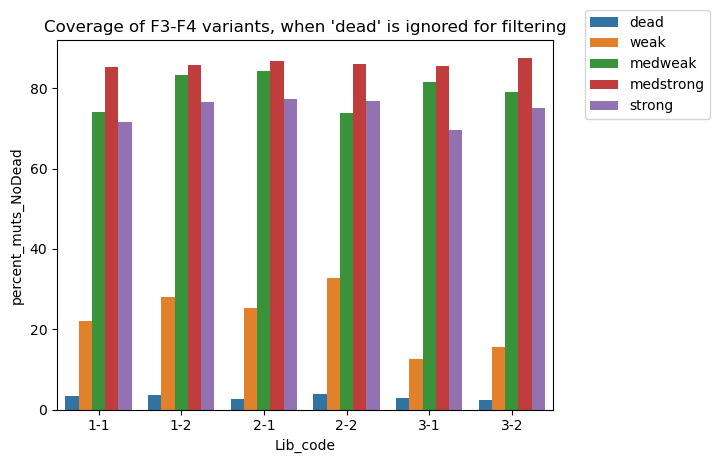

In [37]:
bars_NoDead = sns.barplot(data=cover_per_bin, x='Lib_code', y='percent_muts_NoDead', hue='Exp_bin')
bars_NoDead.legend(loc='upper left', bbox_to_anchor=(1.05, 1.10))
bars_NoDead.set_title("Coverage of F3-F4 variants, when 'dead' is ignored for filtering")

The 'medweak', 'medstrong' and 'strong' bins all contain at least 70% of all F3-F4 variants. Subdividing some of these bins might be a way to increase the assay's resolution!

#### Assessing the replicability of Delta scores across replicates

First, normalized Delta score for all detected variants:

In [41]:
# Preparing a df of Delta scores including the dead bin
diff_all_corr = sort_all_filtered[sort_all_filtered['Genotype'] != 'WT'][['Lib_code', 'Genotype', 'Mutation type', 'Position', 'Diff_bin_cell_norm']].copy().reset_index(drop=True)
diff_all_corr = diff_all_corr.pivot(columns='Lib_code', index='Genotype', values='Diff_bin_cell_norm')
# Preparing a df of Delta scores when excluding the dead bin
diff_NoDead_corr = sort_NoDead_filtered[sort_NoDead_filtered['Genotype'] != 'WT'][['Lib_code', 'Genotype', 'Mutation type', 'Position', 'Diff_norm_NoDead']].copy().reset_index(drop=True)
diff_NoDead_corr = diff_NoDead_corr.pivot(columns='Lib_code', index='Genotype', values='Diff_norm_NoDead')

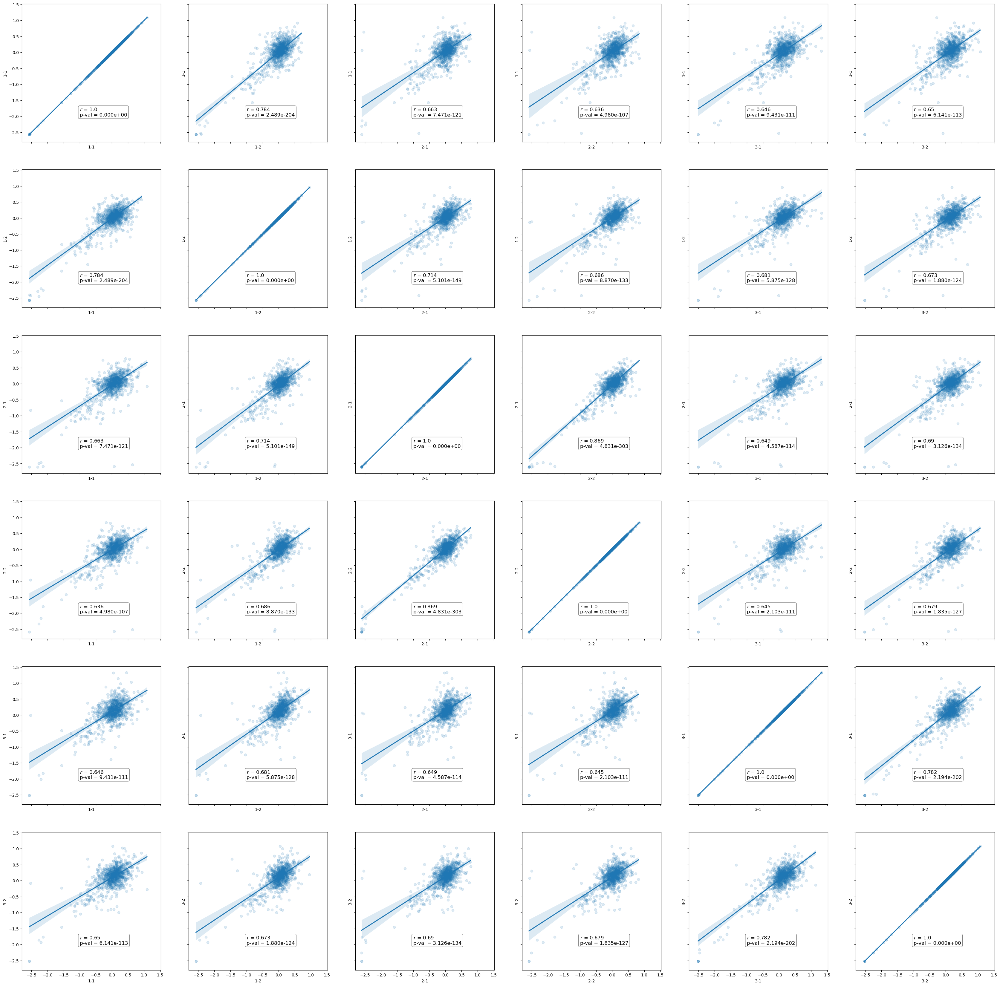

In [42]:
# Correlations for the 'all' dataset
fig, axs = plt.subplots(6, 6, figsize=(42, 42), sharex=True, sharey=True)
row = 0
col = 0

for lib_b in diff_all_corr.columns:
    for lib_a in diff_all_corr.columns:
        
        sns.regplot(data=diff_all_corr, x=lib_a, y=lib_b, ax=axs[row, col], scatter_kws={'alpha':0.15})

        if lib_a == lib_b:
            coeff_calc = diff_all_corr[[lib_a]].copy().dropna().reset_index(drop=True)
        else:
            coeff_calc = diff_all_corr[[lib_a, lib_b]].copy().dropna().reset_index(drop=True)
            
        r_coeff = stats.pearsonr(coeff_calc[lib_a], coeff_calc[lib_b])
        axs[row, col].annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
                           (-1, -2), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)
        if col == 5:
            row += 1
            col = 0
        
        else:
            col += 1

Diff_norm_corr = plt.gcf()
Diff_norm_corr.savefig('SortSeq_data/Corr_by_reps_Diff_all.png', bbox_inches='tight')


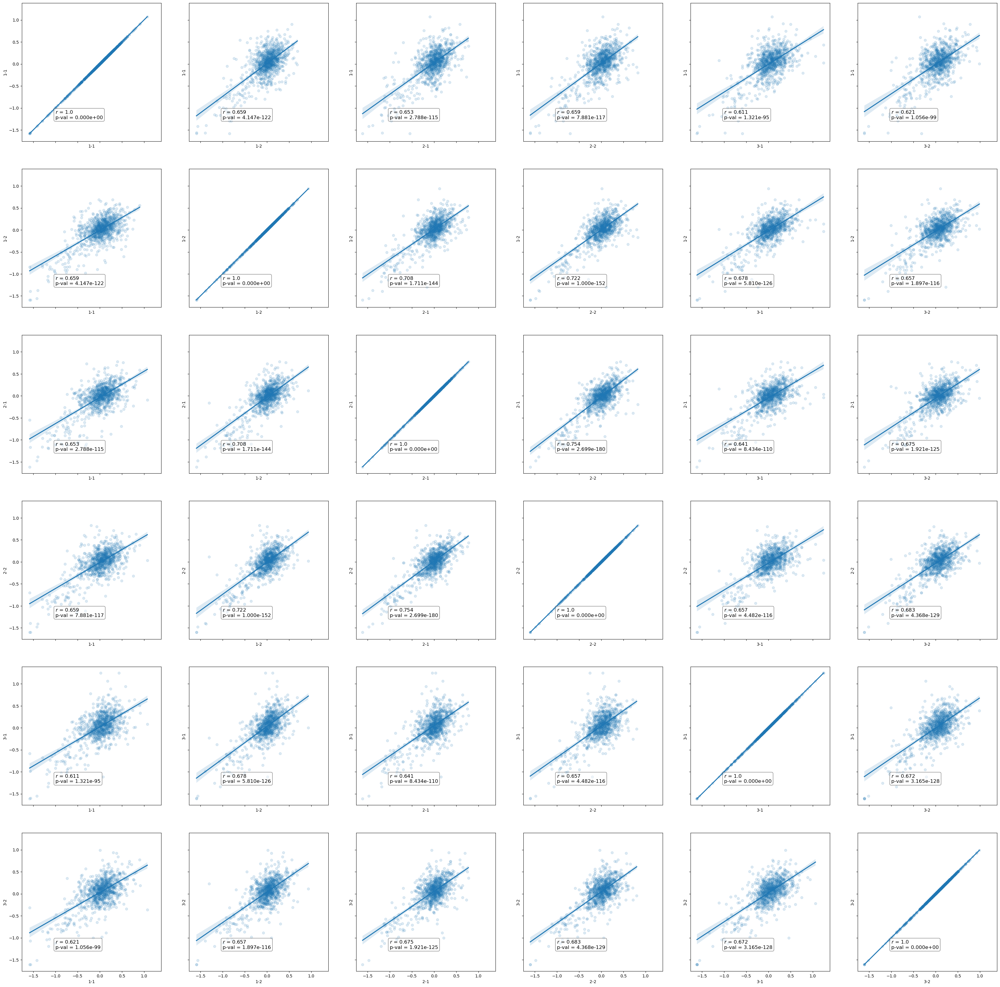

In [43]:
# Correlations for the 'NoDead' dataset
fig, axs = plt.subplots(6, 6, figsize=(42, 42), sharex=True, sharey=True)
row = 0
col = 0

for lib_b in diff_NoDead_corr.columns:
    for lib_a in diff_NoDead_corr.columns:
        
        sns.regplot(data=diff_NoDead_corr, x=lib_a, y=lib_b, ax=axs[row, col], scatter_kws={'alpha':0.15})

        if lib_a == lib_b:
            coeff_calc = diff_NoDead_corr[[lib_a]].copy().dropna().reset_index(drop=True)
        else:
            coeff_calc = diff_NoDead_corr[[lib_a, lib_b]].copy().dropna().reset_index(drop=True)
            
        r_coeff = stats.pearsonr(coeff_calc[lib_a], coeff_calc[lib_b])
        axs[row, col].annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
                           (-1, -1.25), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)
        if col == 5:
            row += 1
            col = 0
        
        else:
            col += 1

Diff_norm_corr = plt.gcf()
Diff_norm_corr.savefig('SortSeq_data/Corr_by_reps_Diff_NoDead.png', bbox_inches='tight')


The correlations are mostly the same, but excluding the "dead" bin might have a greater impact when only F3-F4 variants are considered.

Second, when only considering F3-F4 variants:

In [46]:
# Recomputing the dfs, but only for F3-F4 variants
diff_all_corr_F3F4 = sort_F3F4_filtered[sort_F3F4_filtered['Genotype'] != 'WT'][['Lib_code', 'Genotype', 'Mutation type', 'Position', 'Diff_bin_cell_norm']].copy().reset_index(drop=True)
diff_all_corr_F3F4 = diff_all_corr_F3F4.pivot(columns='Lib_code', index='Genotype', values='Diff_bin_cell_norm')

diff_NoDead_corr_F3F4 = sort_F3F4_NoDead[sort_F3F4_NoDead['Genotype'] != 'WT'][['Lib_code', 'Genotype', 'Mutation type', 'Position', 'Diff_norm_NoDead']].copy().reset_index(drop=True)
diff_NoDead_corr_F3F4 = diff_NoDead_corr_F3F4.pivot(columns='Lib_code', index='Genotype', values='Diff_norm_NoDead')

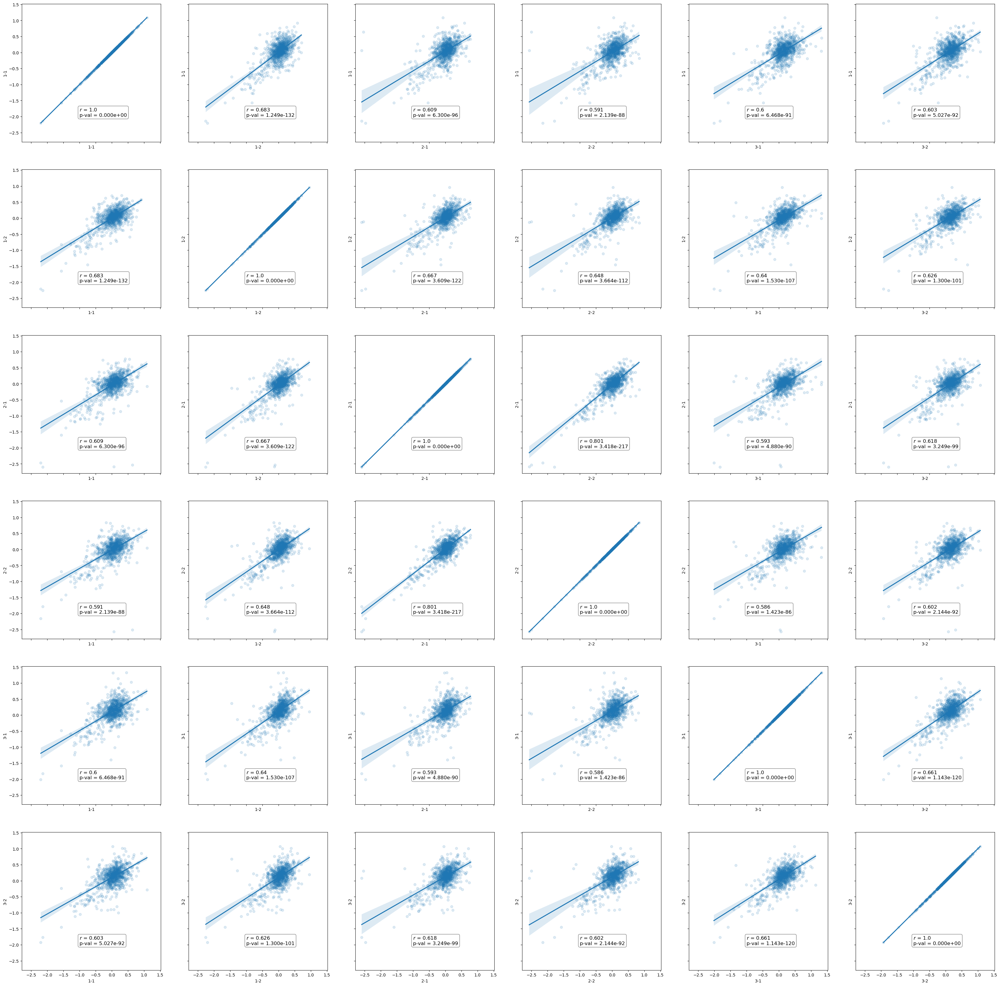

In [47]:
# Correlations for the 'all' dataset
fig, axs = plt.subplots(6, 6, figsize=(42, 42), sharex=True, sharey=True)
row = 0
col = 0

for lib_b in diff_all_corr_F3F4.columns:
    for lib_a in diff_all_corr_F3F4.columns:
        
        sns.regplot(data=diff_all_corr_F3F4, x=lib_a, y=lib_b, ax=axs[row, col], scatter_kws={'alpha':0.15})

        if lib_a == lib_b:
            coeff_calc = diff_all_corr_F3F4[[lib_a]].copy().dropna().reset_index(drop=True)
        else:
            coeff_calc = diff_all_corr_F3F4[[lib_a, lib_b]].copy().dropna().reset_index(drop=True)
            
        r_coeff = stats.pearsonr(coeff_calc[lib_a], coeff_calc[lib_b])
        axs[row, col].annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
                           (-1, -2), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)
        if col == 5:
            row += 1
            col = 0
        
        else:
            col += 1

Diff_norm_corr = plt.gcf()
Diff_norm_corr.savefig('SortSeq_data/Corr_by_reps_Diff_all_F3F4.png', bbox_inches='tight')

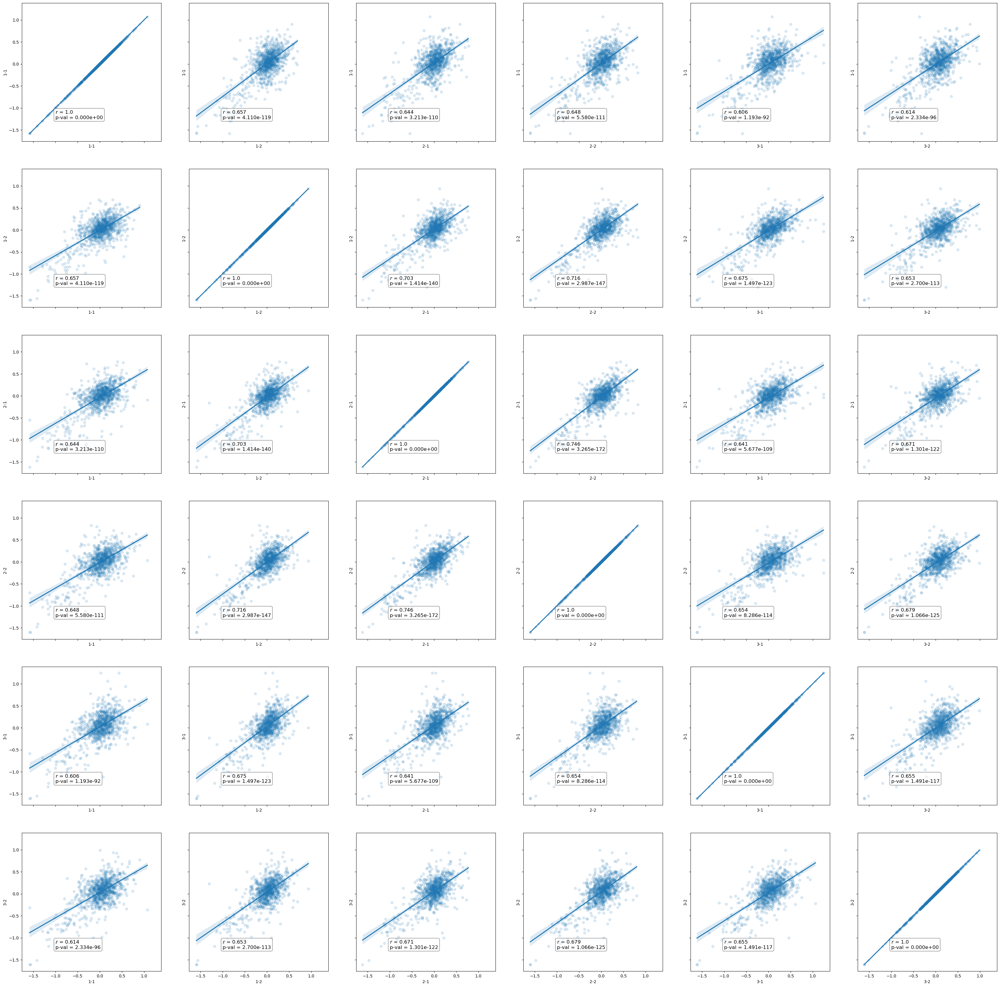

In [48]:
# Correlations for the 'NoDead' dataset
fig, axs = plt.subplots(6, 6, figsize=(42, 42), sharex=True, sharey=True)
row = 0
col = 0

for lib_b in diff_NoDead_corr_F3F4.columns:
    for lib_a in diff_NoDead_corr_F3F4.columns:
        
        sns.regplot(data=diff_NoDead_corr_F3F4, x=lib_a, y=lib_b, ax=axs[row, col], scatter_kws={'alpha':0.15})

        if lib_a == lib_b:
            coeff_calc = diff_NoDead_corr_F3F4[[lib_a]].copy().dropna().reset_index(drop=True)
        else:
            coeff_calc = diff_NoDead_corr_F3F4[[lib_a, lib_b]].copy().dropna().reset_index(drop=True)
            
        r_coeff = stats.pearsonr(coeff_calc[lib_a], coeff_calc[lib_b])
        axs[row, col].annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
                           (-1, -1.25), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)
        if col == 5:
            row += 1
            col = 0
        
        else:
            col += 1

Diff_norm_corr = plt.gcf()
Diff_norm_corr.savefig('SortSeq_data/Corr_by_reps_Diff_NoDead_F3F4.png', bbox_inches='tight')

The correlations are not obviously improved by the exclusion of the "dead" bin...

Third, recomputing all possible correlations and assessing whether the Deltas computed from 'normalized' mean bins are the most reproducible:

We need four correlation matrices, each for pearson and spearman correlations:

1) All bins - All variants
2) All bins - only F3-F4
3) No 'Dead' bin - All variants
4) No 'Dead' bin - only F3-F4 variants

In [53]:
mat_model = pd.DataFrame(index=sort_all_filtered['Lib_code'].unique(), columns=sort_all_filtered['Lib_code'].unique())

In [54]:
# First matrices: All bins and all variants
pearson_all_all = mat_model.copy()
spearman_all_all = mat_model.copy()

for lib_a in mat_model.columns:

    for lib_b in mat_model.columns:

        if lib_a == lib_b:
            data_subset = diff_all_corr[[lib_a]].copy().reset_index(drop=True)

        elif lib_a != lib_b:
            data_subset = diff_all_corr[[lib_a, lib_b]].copy().reset_index(drop=True)

        data_subset = data_subset.dropna().reset_index(drop=True)

        pearson_corr =  stats.pearsonr(data_subset[lib_a], data_subset[lib_b])[0]
        spearman_corr = stats.spearmanr(data_subset[lib_a], data_subset[lib_b])[0]

        pearson_all_all.loc[lib_a, lib_b] = pearson_corr
        spearman_all_all.loc[lib_a, lib_b] = spearman_corr

In [55]:
# Second matrices: All bins, but only F3-F4 variants
pearson_all_F3F4 = mat_model.copy()
spearman_all_F3F4 = mat_model.copy()

for lib_a in mat_model.columns:

    for lib_b in mat_model.columns:

        if lib_a == lib_b:
            data_subset = diff_all_corr_F3F4[[lib_a]].copy().reset_index(drop=True)

        elif lib_a != lib_b:
            data_subset = diff_all_corr_F3F4[[lib_a, lib_b]].copy().reset_index(drop=True)

        data_subset = data_subset.dropna().reset_index(drop=True)

        pearson_corr =  stats.pearsonr(data_subset[lib_a], data_subset[lib_b])[0]
        spearman_corr = stats.spearmanr(data_subset[lib_a], data_subset[lib_b])[0]

        pearson_all_F3F4.loc[lib_a, lib_b] = pearson_corr
        spearman_all_F3F4.loc[lib_a, lib_b] = spearman_corr

In [56]:
# Third matrices: No 'dead' bin and all variants
pearson_NoDead_all = mat_model.copy()
spearman_NoDead_all = mat_model.copy()

for lib_a in mat_model.columns:

    for lib_b in mat_model.columns:

        if lib_a == lib_b:
            data_subset = diff_NoDead_corr[[lib_a]].copy().reset_index(drop=True)

        elif lib_a != lib_b:
            data_subset = diff_NoDead_corr[[lib_a, lib_b]].copy().reset_index(drop=True)

        data_subset = data_subset.dropna().reset_index(drop=True)

        pearson_corr =  stats.pearsonr(data_subset[lib_a], data_subset[lib_b])[0]
        spearman_corr = stats.spearmanr(data_subset[lib_a], data_subset[lib_b])[0]

        pearson_NoDead_all.loc[lib_a, lib_b] = pearson_corr
        spearman_NoDead_all.loc[lib_a, lib_b] = spearman_corr

In [57]:
# Fourth matrices: No 'dead' bin and only F3-F4 variants
pearson_NoDead_F3F4 = mat_model.copy()
spearman_NoDead_F3F4 = mat_model.copy()

for lib_a in mat_model.columns:

    for lib_b in mat_model.columns:

        if lib_a == lib_b:
            data_subset = diff_NoDead_corr_F3F4[[lib_a]].copy().reset_index(drop=True)

        elif lib_a != lib_b:
            data_subset = diff_NoDead_corr_F3F4[[lib_a, lib_b]].copy().reset_index(drop=True)

        data_subset = data_subset.dropna().reset_index(drop=True)

        pearson_corr =  stats.pearsonr(data_subset[lib_a], data_subset[lib_b])[0]
        spearman_corr = stats.spearmanr(data_subset[lib_a], data_subset[lib_b])[0]

        pearson_NoDead_F3F4.loc[lib_a, lib_b] = pearson_corr
        spearman_NoDead_F3F4.loc[lib_a, lib_b] = spearman_corr

Plotting correlation heatmaps:

In [59]:
# Computing min and max correlations
min_pearson = np.min([pearson_all_all, pearson_all_F3F4, pearson_NoDead_all, pearson_NoDead_F3F4])
max_pearson = np.max([pearson_all_all, pearson_all_F3F4, pearson_NoDead_all, pearson_NoDead_F3F4])
median_pearson = np.median([pearson_all_all, pearson_all_F3F4, pearson_NoDead_all, pearson_NoDead_F3F4])

min_spearman = np.min([spearman_all_all, spearman_all_F3F4, spearman_NoDead_all, spearman_NoDead_F3F4])
max_spearman= np.max([spearman_all_all, spearman_all_F3F4, spearman_NoDead_all, spearman_NoDead_F3F4])
median_spearman= np.median([spearman_all_all, spearman_all_F3F4, spearman_NoDead_all, spearman_NoDead_F3F4])

Text(0.5, 0.98, 'Pearson correlations')

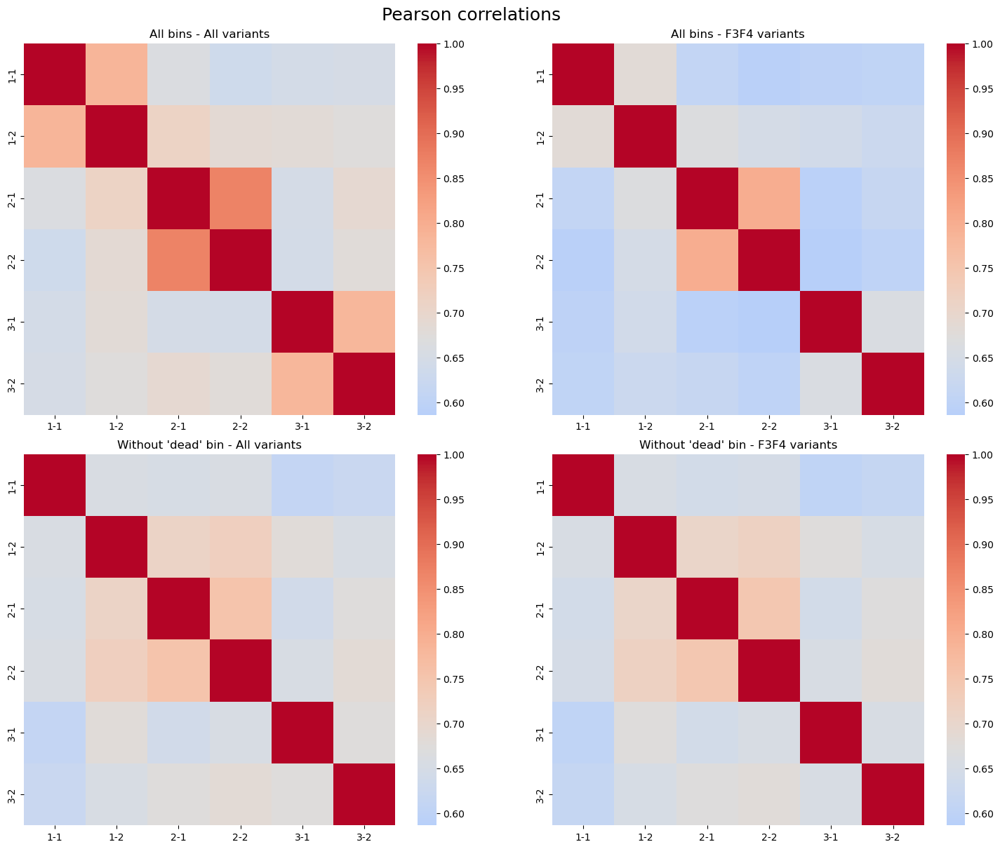

In [60]:
# Correlation heatmaps for pearson correlations
fig, axs = plt.subplots(2, 2, figsize=(15, 12), constrained_layout=True)

sns.heatmap(pearson_all_all.infer_objects(), vmin=min_pearson, vmax=max_pearson,
            center=median_pearson, cmap='coolwarm', ax=axs[0,0], square=True)
axs[0,0].set_title('All bins - All variants')

sns.heatmap(pearson_all_F3F4.infer_objects(), vmin=min_pearson, vmax=max_pearson,
            center=median_pearson, cmap='coolwarm', ax=axs[0,1], square=True)
axs[0,1].set_title('All bins - F3F4 variants')

sns.heatmap(pearson_NoDead_all.infer_objects(), vmin=min_pearson, vmax=max_pearson,
            center=median_pearson, cmap='coolwarm', ax=axs[1,0], square=True)
axs[1,0].set_title("Without 'dead' bin - All variants")

sns.heatmap(pearson_NoDead_F3F4.infer_objects(), vmin=min_pearson, vmax=max_pearson,
            center=median_pearson, cmap='coolwarm', ax=axs[1,1], square=True)
axs[1,1].set_title("Without 'dead' bin - F3F4 variants")

fig.suptitle('Pearson correlations', fontsize=18)

It is only when the 'dead' bin is excluded that Pearson correlations appear slighlty more reproducible for the F3-F4 subset.

Text(0.5, 0.98, 'Spearman correlations')

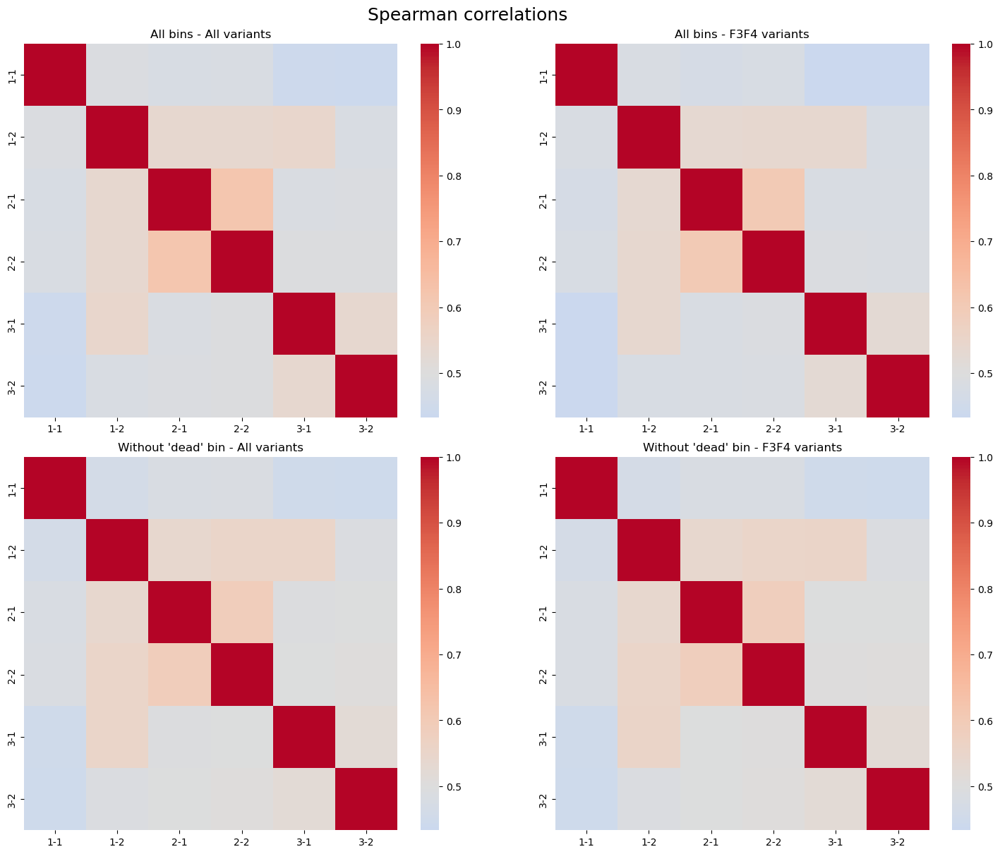

In [62]:
# Correlation heatmaps for spearman correlations
fig, axs = plt.subplots(2, 2, figsize=(15, 12), constrained_layout=True)

sns.heatmap(spearman_all_all.infer_objects(), vmin=min_spearman, vmax=max_spearman,
            center=median_spearman, cmap='coolwarm', ax=axs[0,0], square=True)
axs[0,0].set_title('All bins - All variants')

sns.heatmap(spearman_all_F3F4.infer_objects(), vmin=min_spearman, vmax=max_spearman,
            center=median_spearman, cmap='coolwarm', ax=axs[0,1], square=True)
axs[0,1].set_title('All bins - F3F4 variants')

sns.heatmap(spearman_NoDead_all.infer_objects(), vmin=min_spearman, vmax=max_spearman,
            center=median_spearman, cmap='coolwarm', ax=axs[1,0], square=True)
axs[1,0].set_title("Without 'dead' bin - All variants")

sns.heatmap(spearman_NoDead_F3F4.infer_objects(), vmin=min_spearman, vmax=max_spearman,
            center=median_spearman, cmap='coolwarm', ax=axs[1,1], square=True)
axs[1,1].set_title("Without 'dead' bin - F3F4 variants")

plt.suptitle('Spearman correlations', fontsize=18)

Unsurprisingly, the Spearman correlations do not change much across the four heatmaps.

#### Assessing the correlation between the two versions of the scores

In [65]:
scores_comp = pd.merge(sort_all_filtered[['Lib_code', 'Genotype', 'Mutation type', 'Position', 'In_F3F4', 'Diff_bin_cell_norm']],
                       sort_NoDead_filtered[['Lib_code', 'Genotype', 'Mutation type', 'Position', 'In_F3F4', 'Diff_norm_NoDead']],
                       on=['Lib_code', 'Genotype', 'Mutation type', 'Position', 'In_F3F4'], how='outer')

# Removing all WT rows
scores_comp = scores_comp[scores_comp['Genotype'] != 'WT'].copy().reset_index(drop=True)

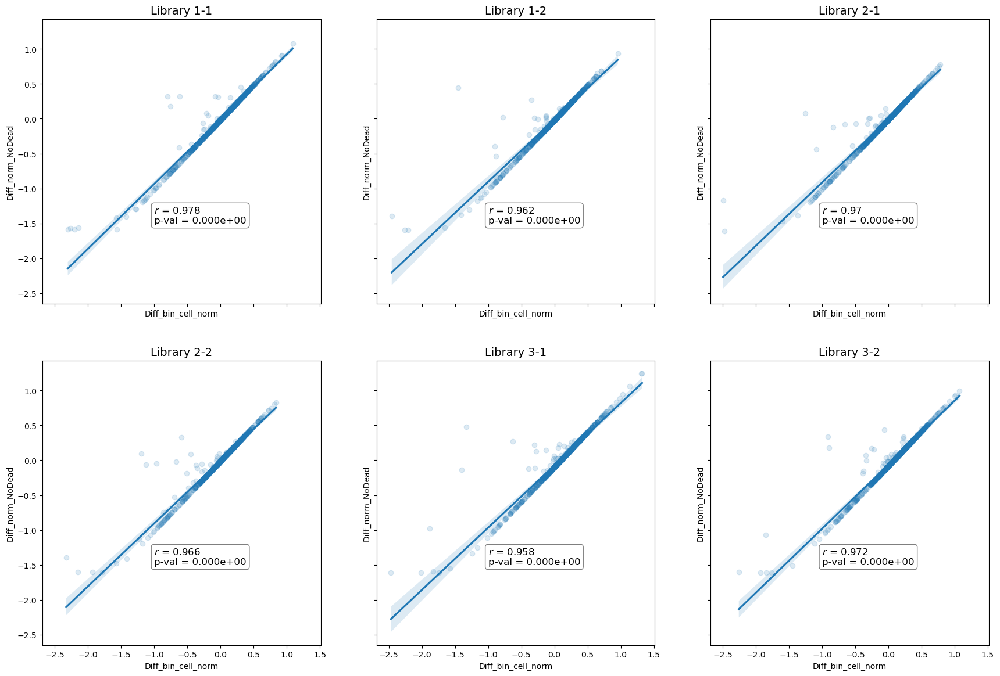

In [66]:
fig, axs = plt.subplots(2, 3, figsize=(21, 14), sharex=True, sharey=True)
row = 0
col = 0

for lib_code in scores_comp['Lib_code'].unique():

    lib_subset = scores_comp[scores_comp['Lib_code'] == lib_code].copy().reset_index(drop=True)

    sns.regplot(data=lib_subset, x='Diff_bin_cell_norm', y='Diff_norm_NoDead', ax=axs[row, col], scatter_kws={'alpha':0.15})
    axs[row, col].set_title(f'Library {lib_code}', fontsize=14)
    scores_nonan = lib_subset.dropna(subset=['Diff_bin_cell_norm', 'Diff_norm_NoDead'])
    r_coeff = stats.pearsonr(scores_nonan['Diff_bin_cell_norm'], scores_nonan['Diff_norm_NoDead'])
    axs[row, col].annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
                           (-1, -1.5), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)

    if col==2:
        row += 1
        col = 0

    else:
        col += 1

Scores_corr = plt.gcf()
Scores_corr.savefig('SortSeq_data/Corr_between_scores.png', bbox_inches='tight')

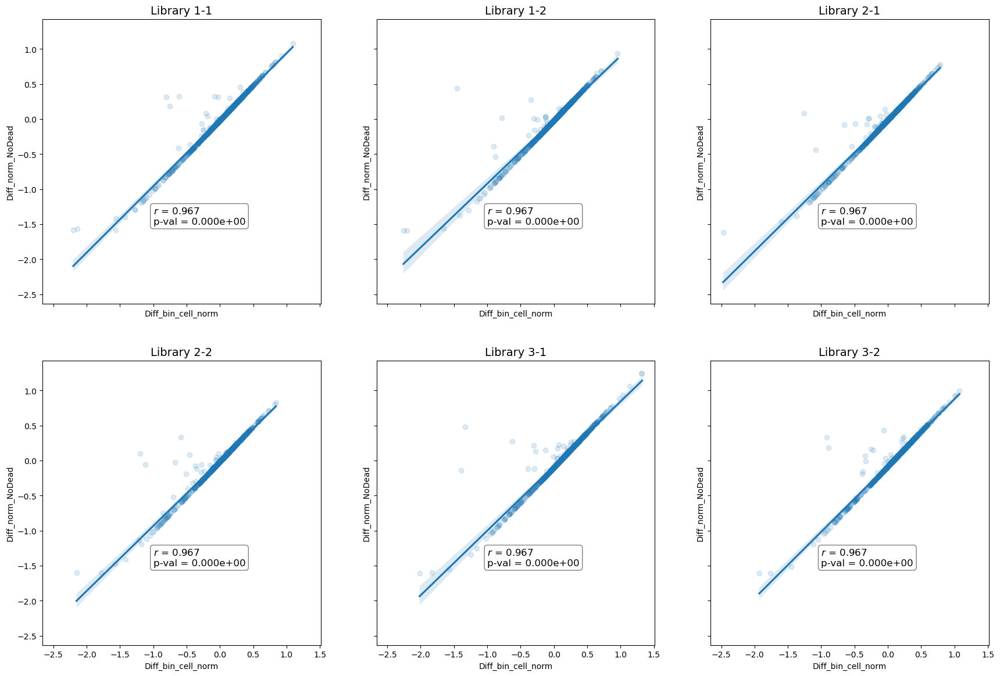

In [67]:
# Same thing, but only for the F3-F4 mutations
scores_F3F4 = scores_comp[scores_comp['In_F3F4']].copy().reset_index(drop=True)

fig, axs = plt.subplots(2, 3, figsize=(21, 14), sharex=True, sharey=True)
row = 0
col = 0

for lib_code in scores_F3F4['Lib_code'].unique():

    lib_subset = scores_F3F4[scores_F3F4['Lib_code'] == lib_code].copy().reset_index(drop=True)

    sns.regplot(data=lib_subset, x='Diff_bin_cell_norm', y='Diff_norm_NoDead', ax=axs[row, col], scatter_kws={'alpha':0.15})
    axs[row, col].set_title(f'Library {lib_code}', fontsize=14)
    scores_nonan = scores_F3F4.dropna(subset=['Diff_bin_cell_norm', 'Diff_norm_NoDead'])
    r_coeff = stats.pearsonr(scores_nonan['Diff_bin_cell_norm'], scores_nonan['Diff_norm_NoDead'])
    axs[row, col].annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
                           (-1, -1.5), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)

    if col==2:
        row += 1
        col = 0

    else:
        col += 1

Scores_corr = plt.gcf()
Scores_corr.savefig('SortSeq_data/Corr_between_scores_F3F4.png', bbox_inches='tight')

There are a few weird outliers. It is unclear which score ( with or without the dead bin) is artifactual in those cases. As such, both scores will be used (and compared) for all further analysis.

In [69]:
# Defining a simplified mutation parser (using parts of the find_mutations() method of Mut_call_func.py)
# which will be used to generate the corresponding unique mutation code for all possible single-nucleotide changes in the F3-F4 region:


# def get_mut_code(mut_seq, ref_seq, offset):
#     """Generate the unique id (as in the Mut_calling.py script used to analyze SortSeq raw data) for a given F3-F4 genotype.
#        Only designed to handle sequences harboring one single-nucleotide mutation. The 'offset' parameter should be a number to add 
#        to the (zero-based) indexes in the mut_seq and ref_seq sequences to convert them into (1-based) indexes of the full sequencing fragment."""

#     mut_seq = mut_seq.upper()
#     ref_seq = ref_seq.upper()

#     # Finding the position of the mismatch between the two sequences
#     mut_array = np.array(list(mut_seq))
#     ref_array = np.array(list(ref_seq))
#     mismatch_index = list(np.nonzero(ref_array != mut_array)[0])

#     if len(mismatch_index) == 0:
#         mut_code = 'WT'

#     elif len(mismatch_index) == 1:
#         # Generate the corresponding mutation code
#         mismatch_index = mismatch_index[0]
#         mut_nt = mut_seq[mismatch_index]
#         ref_nt = ref_seq[mismatch_index]

#         if (mut_nt != '-') and (ref_nt != '-'):
#             mut_type = 'S'

#         elif (mut_nt == '-') and (ref_nt != '-'):
#             mut_type = 'D'

#         elif (mut_nt != '-') and (ref_nt == '-'):
#             mut_type

#     elif len(mismatch_index) > 1:
#         raise Exception("This function is not designed to handle sequences with more than one mutation.")

In [70]:
ref_array = np.array(list('attccttgcaggggcggtagtaccc'.upper()))
mut_array = np.array(list('attcgttgcaggggcggtagtaccc'.upper()))
list(np.nonzero(ref_array != mut_array)[0])[0]

4

In [71]:
test = 'aaaaaaa'
test.upper()

'AAAAAAA'

## Assessing the distribution of effects along the F3-F4 region

### Looking at median Delta scores by position

#### Aggregating by position and mutation type, for scores using the 'dead' bin

In [75]:
sort_agg_pos = sort_all_filtered[sort_all_filtered['Genotype'] != 'WT'].copy().reset_index(drop=True)
sort_agg_pos = sort_agg_pos.drop(columns=['Bio_rep', 'Tech_rep', 'Lib_code', 'Genotype']).groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).median()

In [76]:
sort_pos_norm = sort_all_filtered[sort_all_filtered['Genotype'] != 'WT'][['Mutation type', 'Position', 'In_F3F4', 'Diff_bin_cell_norm']].copy()
min_norm = sort_pos_norm.groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).min()
min_norm = min_norm.rename(columns={'Diff_bin_cell_norm': 'Min_norm'})
max_norm = sort_pos_norm.groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).max()
max_norm = max_norm.rename(columns={'Diff_bin_cell_norm': 'Max_norm'})
std_norm = sort_pos_norm.groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).std()
std_norm = std_norm.rename(columns={'Diff_bin_cell_norm': 'Std_norm'})
all_norm = pd.merge(min_norm, max_norm, on=['Mutation type', 'Position', 'In_F3F4'], how='outer')
all_norm = pd.merge(all_norm, std_norm, on=['Mutation type', 'Position', 'In_F3F4'], how='outer')
sort_agg_pos = pd.merge(sort_agg_pos, all_norm, on=['Mutation type', 'Position', 'In_F3F4'], how='outer')

# Adding the FCY1-relative position
sort_agg_pos['FCY1_position'] = sort_agg_pos['Position'] - 205 + 1*(sort_agg_pos['Mutation type'] == 'Insertion')

Generating the corresponding plot:

In [78]:
mut_palette = {'Substitution': cm.tab10.colors[9], 
               'Insertion': cm.tab20b.colors[1],
               'Deletion': cm.tab10.colors[3]}
pos_sub = sort_agg_pos[sort_agg_pos['Mutation type'] == 'Substitution'].copy().reset_index(drop=True).infer_objects()
pos_ins = sort_agg_pos[sort_agg_pos['Mutation type'] == 'Insertion'].copy().reset_index(drop=True).infer_objects()
pos_del = sort_agg_pos[sort_agg_pos['Mutation type'] == 'Deletion'].copy().reset_index(drop=True).infer_objects()

# Preparing the error bars, showing min and max measurements
sub_errors = np.array([pos_sub['Diff_bin_cell_norm'] - pos_sub['Min_norm'],
                       pos_sub['Max_norm'] - pos_sub['Diff_bin_cell_norm']])
ins_errors = np.array([pos_ins['Diff_bin_cell_norm'] - pos_ins['Min_norm'],
                       pos_ins['Max_norm'] - pos_ins['Diff_bin_cell_norm']])
del_errors = np.array([pos_del['Diff_bin_cell_norm'] - pos_del['Min_norm'],
                       pos_del['Max_norm'] - pos_del['Diff_bin_cell_norm']])

Text(0.5, 0.98, 'By position, all bins')

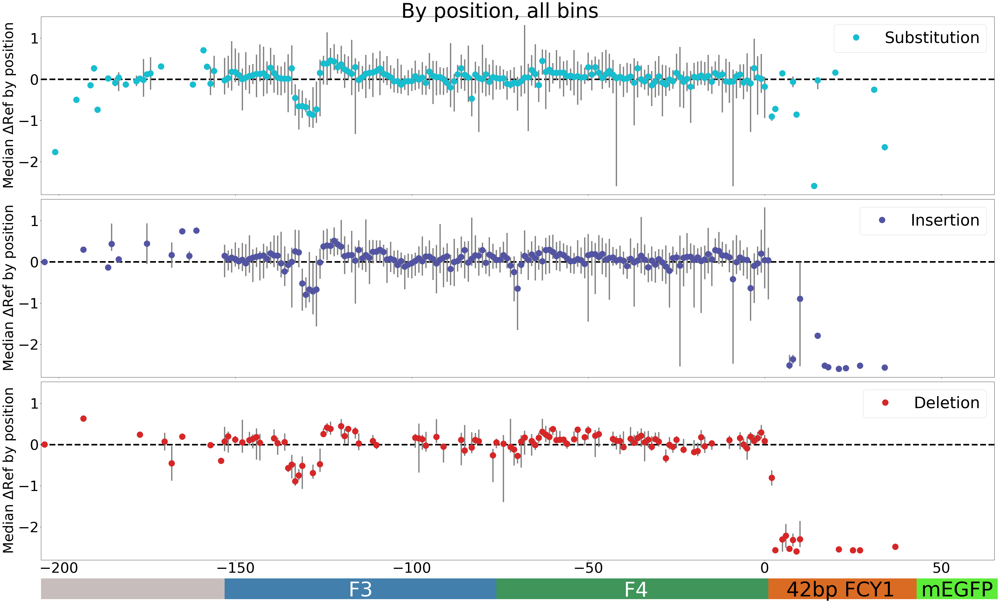

In [79]:
marker_size = 400
error_width = 4
legend_size = 50
baseline_width = 5
ax_lab_size = 43.5
ticks_size = 45

fig, axs = plt.subplots(3, 1, figsize=(44, 27), sharex=True, sharey=True, tight_layout=True)

plot1 = sns.scatterplot(data=pos_sub, x='FCY1_position', y='Diff_bin_cell_norm', hue='Mutation type', ax=axs[0], palette=mut_palette, s=marker_size, edgecolor='none')
plot1.legend(fontsize=legend_size)
axs[0].errorbar(pos_sub['FCY1_position'], pos_sub['Diff_bin_cell_norm'], yerr=sub_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)

plot2 = sns.scatterplot(data=pos_ins, x='FCY1_position', y='Diff_bin_cell_norm', hue='Mutation type', ax=axs[1], palette=mut_palette, s=marker_size, edgecolor='none')
plot2.legend(fontsize=legend_size)
axs[1].errorbar(pos_ins['FCY1_position'], pos_ins['Diff_bin_cell_norm'], yerr=ins_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)

plot3 = sns.scatterplot(data=pos_del, x='FCY1_position', y='Diff_bin_cell_norm', hue='Mutation type', ax=axs[2], palette=mut_palette, s=marker_size, edgecolor='none')
plot3.legend(fontsize=legend_size)
axs[2].errorbar(pos_del['FCY1_position'], pos_del['Diff_bin_cell_norm'], yerr=del_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)


for ax in [axs[0], axs[1], axs[2]]:
    ax.axhline(y=0, c='black', linestyle='--', zorder=-1, linewidth=baseline_width)
    ax.set_xlim(left=-205, right=65)
    ax.set_ylabel(r"Median $\Delta$Ref by position", fontsize=ax_lab_size)
    ax.tick_params(axis='both', which='major', labelsize=ticks_size)
    ax.set_xlabel('')

# Adding rectangles to identify regions
axs[2].add_patch(Rectangle((-153, -3.25), 77, -0.5, facecolor='#427fac', edgecolor=None, clip_on=False))  # F3

axs[2].add_patch(Rectangle((-76, -3.25), 77, -0.5, facecolor='#3f955a', edgecolor=None, clip_on=False))  # F4

axs[2].add_patch(Rectangle((1, -3.25), 42, -0.5, facecolor='#d45400dc', edgecolor=None, clip_on=False))  # FCY1 CDS

axs[2].add_patch(Rectangle((43, -3.25), 23, -0.5, facecolor='#5dec38', edgecolor=None, clip_on=False)) # mEGFP

axs[2].add_patch(Rectangle((-205, -3.25), 52, -0.5, facecolor='#c8bdbd', edgecolor=None, clip_on=False))  # Intergenic region

# Annotations
axs[2].annotate('F3', (-114.5, -3.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('F4', (-36.5, -3.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('42bp FCY1', (21.5, -3.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

axs[2].annotate('mEGFP', (54.5, -3.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

fig.suptitle('By position, all bins', fontsize=64)

We see two sites (near -130) where all mutations at a given position have a similar effect on expression. There also seem to be some mutations which have large effects near the boundary between the two fragments, as well as near the TSS.

#### Aggregating by position and mutation type, for scores without the 'dead' bin

In [82]:
sort_agg_NoDead_pos = sort_NoDead_filtered[sort_NoDead_filtered['Genotype'] != 'WT'].copy().reset_index(drop=True)
sort_agg_NoDead_pos = sort_agg_NoDead_pos.drop(columns=['Bio_rep', 'Tech_rep', 'Lib_code', 'Genotype']).groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).median()

In [83]:
sort_pos_NoDead_norm = sort_NoDead_filtered[sort_NoDead_filtered['Genotype'] != 'WT'][['Mutation type', 'Position', 'In_F3F4', 'Diff_norm_NoDead']].copy()
min_norm = sort_pos_NoDead_norm.groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).min()
min_norm = min_norm.rename(columns={'Diff_norm_NoDead': 'Min_norm'})
max_norm = sort_pos_NoDead_norm.groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).max()
max_norm = max_norm.rename(columns={'Diff_norm_NoDead': 'Max_norm'})
std_norm = sort_pos_NoDead_norm.groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).std()
std_norm = std_norm.rename(columns={'Diff_norm_NoDead': 'Std_norm'})
all_norm_NoDead = pd.merge(min_norm, max_norm, on=['Mutation type', 'Position', 'In_F3F4'], how='outer')
all_norm_NoDead = pd.merge(all_norm_NoDead, std_norm, on=['Mutation type', 'Position', 'In_F3F4'], how='outer')
sort_agg_NoDead_pos = pd.merge(sort_agg_NoDead_pos, all_norm_NoDead, on=['Mutation type', 'Position', 'In_F3F4'], how='outer')

# Adding the FCY1-relative position
sort_agg_NoDead_pos['FCY1_position'] = sort_agg_NoDead_pos['Position'] - 205 + 1*(sort_agg_NoDead_pos['Mutation type'] == 'Insertion')

In [84]:
pos_sub = sort_agg_NoDead_pos[sort_agg_NoDead_pos['Mutation type'] == 'Substitution'].copy().reset_index(drop=True).infer_objects()
pos_ins = sort_agg_NoDead_pos[sort_agg_NoDead_pos['Mutation type'] == 'Insertion'].copy().reset_index(drop=True).infer_objects()
pos_del = sort_agg_NoDead_pos[sort_agg_NoDead_pos['Mutation type'] == 'Deletion'].copy().reset_index(drop=True).infer_objects()

# Preparing the error bars, showing min and max measurements
sub_errors = np.array([pos_sub['Diff_norm_NoDead'] - pos_sub['Min_norm'],
                       pos_sub['Max_norm'] - pos_sub['Diff_norm_NoDead']])
ins_errors = np.array([pos_ins['Diff_norm_NoDead'] - pos_ins['Min_norm'],
                       pos_ins['Max_norm'] - pos_ins['Diff_norm_NoDead']])
del_errors = np.array([pos_del['Diff_norm_NoDead'] - pos_del['Min_norm'],
                       pos_del['Max_norm'] - pos_del['Diff_norm_NoDead']])

Text(0.5, 0.98, "By position, no 'dead' bin")

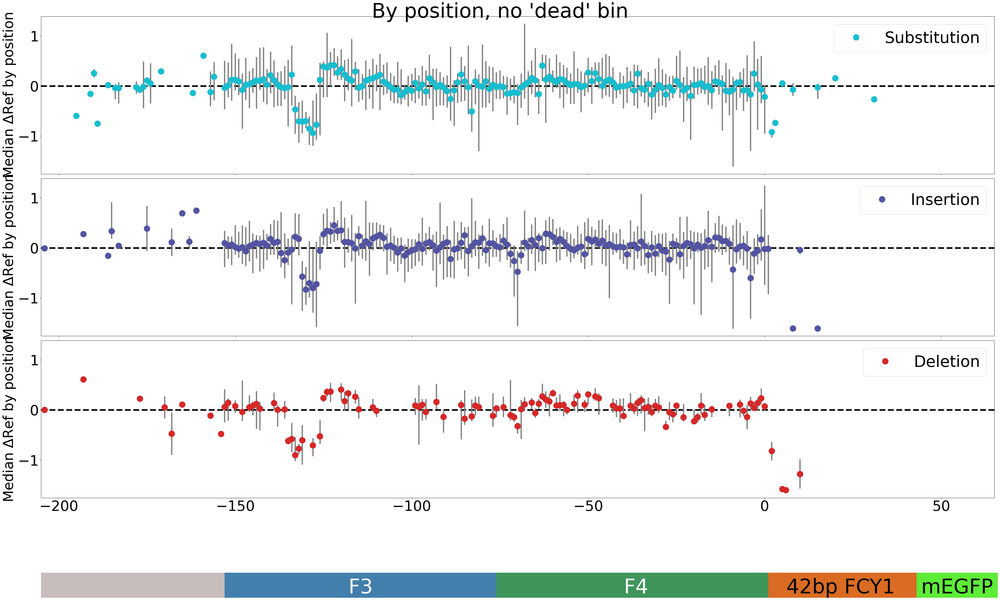

In [85]:
marker_size = 400
error_width = 4
legend_size = 50
baseline_width = 5
ax_lab_size = 43.5
ticks_size = 45

fig, axs = plt.subplots(3, 1, figsize=(44, 27), sharex=True, sharey=True, tight_layout=True)

plot1 = sns.scatterplot(data=pos_sub, x='FCY1_position', y='Diff_norm_NoDead', hue='Mutation type', ax=axs[0], palette=mut_palette, s=marker_size, edgecolor='none')
plot1.legend(fontsize=legend_size)
axs[0].errorbar(pos_sub['FCY1_position'], pos_sub['Diff_norm_NoDead'], yerr=sub_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)

plot2 = sns.scatterplot(data=pos_ins, x='FCY1_position', y='Diff_norm_NoDead', hue='Mutation type', ax=axs[1], palette=mut_palette, s=marker_size, edgecolor='none')
plot2.legend(fontsize=legend_size)
axs[1].errorbar(pos_ins['FCY1_position'], pos_ins['Diff_norm_NoDead'], yerr=ins_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)

plot3 = sns.scatterplot(data=pos_del, x='FCY1_position', y='Diff_norm_NoDead', hue='Mutation type', ax=axs[2], palette=mut_palette, s=marker_size, edgecolor='none')
plot3.legend(fontsize=legend_size)
axs[2].errorbar(pos_del['FCY1_position'], pos_del['Diff_norm_NoDead'], yerr=del_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)


for ax in [axs[0], axs[1], axs[2]]:
    ax.axhline(y=0, c='black', linestyle='--', zorder=-1, linewidth=baseline_width)
    ax.set_xlim(left=-205, right=65)
    ax.set_ylabel(r"Median $\Delta$Ref by position", fontsize=ax_lab_size)
    ax.tick_params(axis='both', which='major', labelsize=ticks_size)
    ax.set_xlabel('')

# Adding rectangles to identify regions
axs[2].add_patch(Rectangle((-153, -3.25), 77, -0.5, facecolor='#427fac', edgecolor=None, clip_on=False))  # F3

axs[2].add_patch(Rectangle((-76, -3.25), 77, -0.5, facecolor='#3f955a', edgecolor=None, clip_on=False))  # F4

axs[2].add_patch(Rectangle((1, -3.25), 42, -0.5, facecolor='#d45400dc', edgecolor=None, clip_on=False))  # FCY1 CDS

axs[2].add_patch(Rectangle((43, -3.25), 23, -0.5, facecolor='#5dec38', edgecolor=None, clip_on=False)) # mEGFP

axs[2].add_patch(Rectangle((-205, -3.25), 52, -0.5, facecolor='#c8bdbd', edgecolor=None, clip_on=False))  # Intergenic region

# Annotations
axs[2].annotate('F3', (-114.5, -3.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('F4', (-36.5, -3.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('42bp FCY1', (21.5, -3.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

axs[2].annotate('mEGFP', (54.5, -3.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

fig.suptitle("By position, no 'dead' bin", fontsize=64)

It seems plausible that some F3-F4 mutations with very strong effects are 'lost' when the 'dead' bin is not used in the analysis.

### Looking at median Delta scores by mutation

#### Plots of median Delta Ref score by mutation

First, with the 'dead' bin:

In [90]:
sort_agg_mut = sort_all_filtered[sort_all_filtered['Genotype'] != 'WT'].copy().reset_index(drop=True)
sort_agg_mut = sort_agg_mut.drop(columns=['Bio_rep', 'Tech_rep', 'Lib_code']).groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).median()

In [91]:
sort_mut_norm = sort_all_filtered[sort_all_filtered['Genotype'] != 'WT'][['Mutation type', 'Genotype', 'Position', 'In_F3F4', 'Diff_bin_cell_norm']].copy()
min_norm = sort_mut_norm.groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).min()
min_norm = min_norm.rename(columns={'Diff_bin_cell_norm': 'Min_norm'})
max_norm = sort_mut_norm.groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).max()
max_norm = max_norm.rename(columns={'Diff_bin_cell_norm': 'Max_norm'})
std_norm = sort_mut_norm.groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).std()
std_norm = std_norm.rename(columns={'Diff_bin_cell_norm': 'Std_norm'})
all_norm = pd.merge(min_norm, max_norm, on=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], how='outer')
all_norm = pd.merge(all_norm, std_norm, on=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], how='outer')
sort_agg_mut = pd.merge(sort_agg_mut, all_norm, on=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], how='outer')

# Adding the FCY1-relative position
sort_agg_mut['FCY1_position'] = sort_agg_mut['Position'] - 205 + 1*(sort_agg_mut['Mutation type'] == 'Insertion')

In [92]:
# Subsets for plotting
mut_sub = sort_agg_mut[sort_agg_mut['Mutation type'] == 'Substitution'].copy().reset_index(drop=True).infer_objects()
mut_ins = sort_agg_mut[sort_agg_mut['Mutation type'] == 'Insertion'].copy().reset_index(drop=True).infer_objects()
mut_del = sort_agg_mut[sort_agg_mut['Mutation type'] == 'Deletion'].copy().reset_index(drop=True).infer_objects()

In [93]:
# For error bars, by position rather than by mutation
sub_pos_all = sort_agg_pos[sort_agg_pos['Mutation type'] == 'Substitution'].copy().reset_index(drop=True).infer_objects()
ins_pos_all = sort_agg_pos[sort_agg_pos['Mutation type'] == 'Insertion'].copy().reset_index(drop=True).infer_objects()
del_pos_all = sort_agg_pos[sort_agg_pos['Mutation type'] == 'Deletion'].copy().reset_index(drop=True).infer_objects()

# Preparing the error bars, showing min and max measurements
sub_errors = np.array([sub_pos_all['Diff_bin_cell_norm'] - sub_pos_all['Min_norm'],
                       sub_pos_all['Max_norm'] - sub_pos_all['Diff_bin_cell_norm']])
ins_errors = np.array([ins_pos_all['Diff_bin_cell_norm'] - ins_pos_all['Min_norm'],
                       ins_pos_all['Max_norm'] - ins_pos_all['Diff_bin_cell_norm']])
del_errors = np.array([del_pos_all['Diff_bin_cell_norm'] - del_pos_all['Min_norm'],
                       del_pos_all['Max_norm'] - del_pos_all['Diff_bin_cell_norm']])

Text(0.5, 0.98, 'By mutation, all bins')

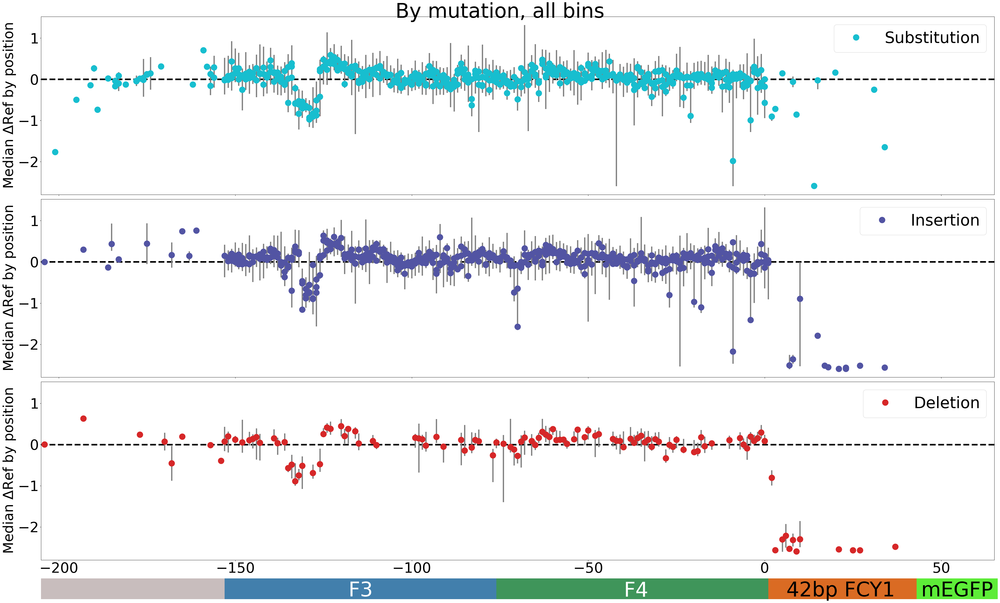

In [94]:
fig, axs = plt.subplots(3, 1, figsize=(44, 27), sharex=True, sharey=True, tight_layout=True)

plot1 = sns.scatterplot(data=mut_sub, x='FCY1_position', y='Diff_bin_cell_norm', hue='Mutation type', ax=axs[0], palette=mut_palette, s=marker_size, edgecolor='none')
plot1.legend(fontsize=legend_size)
axs[0].errorbar(sub_pos_all['FCY1_position'], sub_pos_all['Diff_bin_cell_norm'], yerr=sub_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)

plot2 = sns.scatterplot(data=mut_ins, x='FCY1_position', y='Diff_bin_cell_norm', hue='Mutation type', ax=axs[1], palette=mut_palette, s=marker_size, edgecolor='none')
plot2.legend(fontsize=legend_size)
axs[1].errorbar(ins_pos_all['FCY1_position'], ins_pos_all['Diff_bin_cell_norm'], yerr=ins_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)

plot3 = sns.scatterplot(data=mut_del, x='FCY1_position', y='Diff_bin_cell_norm', hue='Mutation type', ax=axs[2], palette=mut_palette, s=marker_size, edgecolor='none')
plot3.legend(fontsize=legend_size)
axs[2].errorbar(del_pos_all['FCY1_position'], del_pos_all['Diff_bin_cell_norm'], yerr=del_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)


for ax in [axs[0], axs[1], axs[2]]:
    ax.axhline(y=0, c='black', linestyle='--', zorder=-1, linewidth=baseline_width)
    ax.set_xlim(left=-205, right=65)
    ax.set_ylabel(r"Median $\Delta$Ref by position", fontsize=ax_lab_size)
    ax.tick_params(axis='both', which='major', labelsize=ticks_size)
    ax.set_xlabel('')

# Adding rectangles to identify regions
axs[2].add_patch(Rectangle((-153, -3.25), 77, -0.5, facecolor='#427fac', edgecolor=None, clip_on=False))  # F3

axs[2].add_patch(Rectangle((-76, -3.25), 77, -0.5, facecolor='#3f955a', edgecolor=None, clip_on=False))  # F4

axs[2].add_patch(Rectangle((1, -3.25), 42, -0.5, facecolor='#d45400dc', edgecolor=None, clip_on=False))  # FCY1 CDS

axs[2].add_patch(Rectangle((43, -3.25), 23, -0.5, facecolor='#5dec38', edgecolor=None, clip_on=False)) # mEGFP

axs[2].add_patch(Rectangle((-205, -3.25), 52, -0.5, facecolor='#c8bdbd', edgecolor=None, clip_on=False))  # Intergenic region

# Annotations
axs[2].annotate('F3', (-114.5, -3.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('F4', (-36.5, -3.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('42bp FCY1', (21.5, -3.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

axs[2].annotate('mEGFP', (54.5, -3.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

fig.suptitle('By mutation, all bins', fontsize=64)

In some cases, what looked like large effect mutations may simply be one outlier replicate.

Second, without the 'dead' bin:

In [97]:
sort_agg_NoDead_mut = sort_NoDead_filtered[sort_NoDead_filtered['Genotype'] != 'WT'].copy().reset_index(drop=True)
sort_agg_NoDead_mut = sort_agg_NoDead_mut.drop(columns=['Bio_rep', 'Tech_rep', 'Lib_code']).groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).median()

In [98]:
sort_mut_NoDead_norm = sort_NoDead_filtered[sort_NoDead_filtered['Genotype'] != 'WT'][['Mutation type', 'Genotype', 'Position', 'In_F3F4', 'Diff_norm_NoDead']].copy()
min_norm = sort_mut_NoDead_norm.groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).min()
min_norm = min_norm.rename(columns={'Diff_norm_NoDead': 'Min_norm'})
max_norm = sort_mut_NoDead_norm.groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).max()
max_norm = max_norm.rename(columns={'Diff_norm_NoDead': 'Max_norm'})
std_norm = sort_mut_NoDead_norm.groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).std()
std_norm = std_norm.rename(columns={'Diff_norm_NoDead': 'Std_norm'})
all_norm_NoDead = pd.merge(min_norm, max_norm, on=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], how='outer')
all_norm_NoDead = pd.merge(all_norm_NoDead, std_norm, on=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], how='outer')
sort_agg_NoDead_mut = pd.merge(sort_agg_NoDead_mut, all_norm_NoDead, on=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], how='outer')

# Adding the FCY1-relative position
sort_agg_NoDead_mut['FCY1_position'] = sort_agg_NoDead_mut['Position'] - 205 + 1*(sort_agg_NoDead_mut['Mutation type'] == 'Insertion')

In [99]:
# Subsets for plotting
mut_sub = sort_agg_NoDead_mut[sort_agg_NoDead_mut['Mutation type'] == 'Substitution'].copy().reset_index(drop=True).infer_objects()
mut_ins = sort_agg_NoDead_mut[sort_agg_NoDead_mut['Mutation type'] == 'Insertion'].copy().reset_index(drop=True).infer_objects()
mut_del = sort_agg_NoDead_mut[sort_agg_NoDead_mut['Mutation type'] == 'Deletion'].copy().reset_index(drop=True).infer_objects()

In [100]:
# For error bars, by position rather than by mutation
sub_pos_NoDead = sort_agg_NoDead_pos[sort_agg_NoDead_pos['Mutation type'] == 'Substitution'].copy().reset_index(drop=True).infer_objects()
ins_pos_NoDead = sort_agg_NoDead_pos[sort_agg_NoDead_pos['Mutation type'] == 'Insertion'].copy().reset_index(drop=True).infer_objects()
del_pos_NoDead = sort_agg_NoDead_pos[sort_agg_NoDead_pos['Mutation type'] == 'Deletion'].copy().reset_index(drop=True).infer_objects()

# Preparing the error bars, showing min and max measurements
sub_errors = np.array([sub_pos_NoDead['Diff_norm_NoDead'] - sub_pos_NoDead['Min_norm'],
                       sub_pos_NoDead['Max_norm'] - sub_pos_NoDead['Diff_norm_NoDead']])
ins_errors = np.array([ins_pos_NoDead['Diff_norm_NoDead'] - ins_pos_NoDead['Min_norm'],
                       ins_pos_NoDead['Max_norm'] - ins_pos_NoDead['Diff_norm_NoDead']])
del_errors = np.array([del_pos_NoDead['Diff_norm_NoDead'] - del_pos_NoDead['Min_norm'],
                       del_pos_NoDead['Max_norm'] - del_pos_NoDead['Diff_norm_NoDead']])

Text(0.5, 0.98, "By mutation, no 'dead' bin")

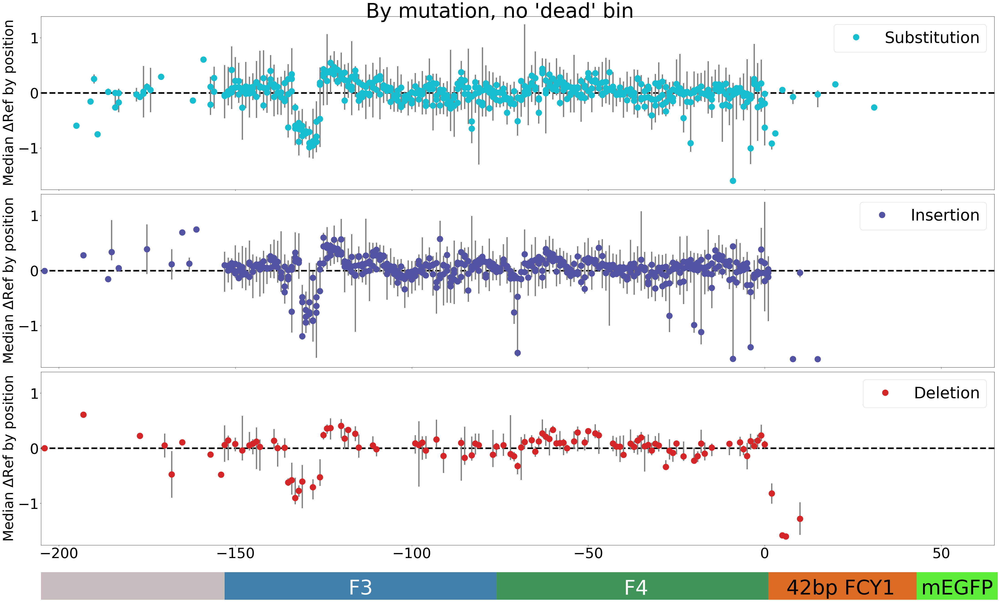

In [101]:
fig, axs = plt.subplots(3, 1, figsize=(44, 27), sharex=True, sharey=True, tight_layout=True)

plot1 = sns.scatterplot(data=mut_sub, x='FCY1_position', y='Diff_norm_NoDead', hue='Mutation type', ax=axs[0], palette=mut_palette, s=marker_size, edgecolor='none')
plot1.legend(fontsize=legend_size)
axs[0].errorbar(sub_pos_NoDead['FCY1_position'], sub_pos_NoDead['Diff_norm_NoDead'], yerr=sub_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)

plot2 = sns.scatterplot(data=mut_ins, x='FCY1_position', y='Diff_norm_NoDead', hue='Mutation type', ax=axs[1], palette=mut_palette, s=marker_size, edgecolor='none')
plot2.legend(fontsize=legend_size)
axs[1].errorbar(ins_pos_NoDead['FCY1_position'], ins_pos_NoDead['Diff_norm_NoDead'], yerr=ins_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)

plot3 = sns.scatterplot(data=mut_del, x='FCY1_position', y='Diff_norm_NoDead', hue='Mutation type', ax=axs[2], palette=mut_palette, s=marker_size, edgecolor='none')
plot3.legend(fontsize=legend_size)
axs[2].errorbar(del_pos_NoDead['FCY1_position'], del_pos_NoDead['Diff_norm_NoDead'], yerr=del_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)


for ax in [axs[0], axs[1], axs[2]]:
    ax.axhline(y=0, c='black', linestyle='--', zorder=-1, linewidth=baseline_width)
    ax.set_xlim(left=-205, right=65)
    ax.set_ylabel(r"Median $\Delta$Ref by position", fontsize=ax_lab_size)
    ax.tick_params(axis='both', which='major', labelsize=ticks_size)
    ax.set_xlabel('')

# Adding rectangles to identify regions
axs[2].add_patch(Rectangle((-153, -2.25), 77, -0.5, facecolor='#427fac', edgecolor=None, clip_on=False))  # F3

axs[2].add_patch(Rectangle((-76, -2.25), 77, -0.5, facecolor='#3f955a', edgecolor=None, clip_on=False))  # F4

axs[2].add_patch(Rectangle((1, -2.25), 42, -0.5, facecolor='#d45400dc', edgecolor=None, clip_on=False))  # FCY1 CDS

axs[2].add_patch(Rectangle((43, -2.25), 23, -0.5, facecolor='#5dec38', edgecolor=None, clip_on=False)) # mEGFP

axs[2].add_patch(Rectangle((-205, -2.25), 52, -0.5, facecolor='#c8bdbd', edgecolor=None, clip_on=False))  # Intergenic region

# Annotations
axs[2].annotate('F3', (-114.5, -2.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('F4', (-36.5, -2.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('42bp FCY1', (21.5, -2.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

axs[2].annotate('mEGFP', (54.5, -2.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

fig.suptitle("By mutation, no 'dead' bin", fontsize=64)

It seems like we have a few outliers. it may be worthwhile to filter outlier before identifying statistically significant effects, as previously done for selection coefficients.

At least, we can see that all large effects which did not seem driven by outliers (see previous figure) are kept event when the 'dead' bin is not used.

#### Plotting all replicates of all F3-F4 mutations

This will give a better idea of the impact of outliers.

1) With the dead bin

In [107]:
muts_all_F3F4 = sort_F3F4_filtered[sort_F3F4_filtered['Genotype'] != 'WT'][['Lib_code', 'Genotype', 'Mutation type', 'Position', 'Diff_bin_cell_norm']].copy().reset_index(drop=True)
muts_all_F3F4['New_nt'] = muts_all_F3F4['Genotype'].apply(lambda x: x.split('to')[1])
muts_all_F3F4['FCY1_position'] = muts_all_F3F4['Position'] - 205 + 1*(muts_all_F3F4['Mutation type'] == 'Insertion')

Text(0.5, 1.0, 'N To C')

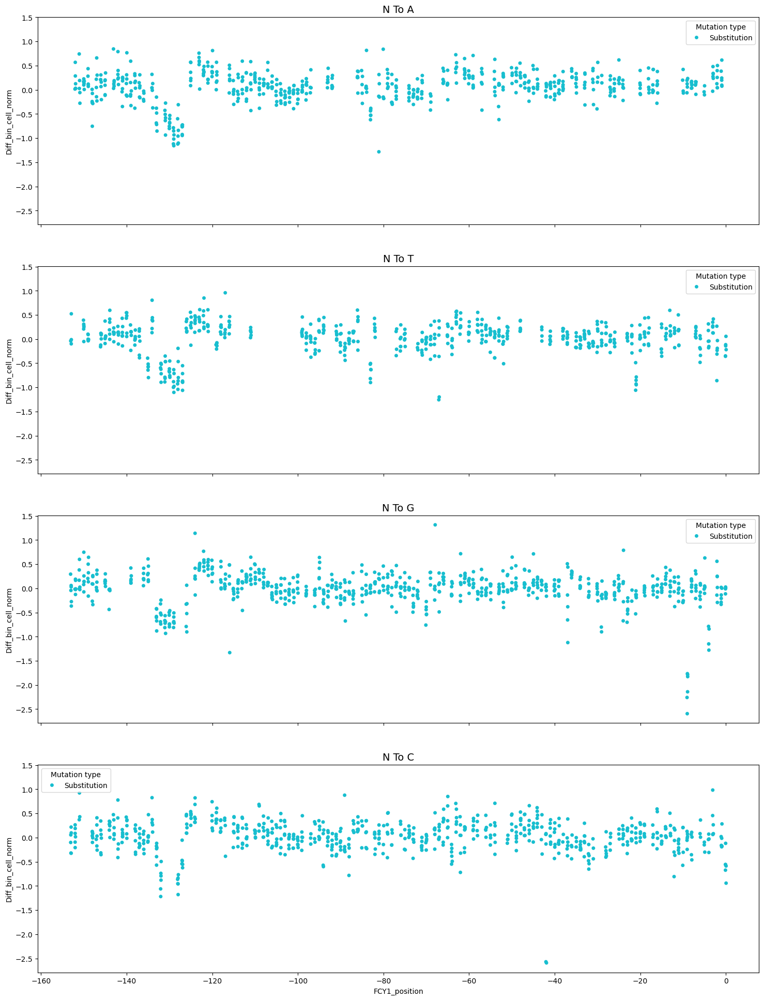

In [108]:
# First figure: Substitutions
# from top to bottom: A, T, G, C

sort_F3F4_sub = muts_all_F3F4[muts_all_F3F4['Mutation type'] == 'Substitution'].copy().reset_index(drop=True)

fig, axs = plt.subplots(4, 1, figsize=(18, 24), sharex=True, sharey=True)

sns.stripplot(data=sort_F3F4_sub[sort_F3F4_sub['New_nt'] == 'A'].copy(), x='FCY1_position', y='Diff_bin_cell_norm',
             hue='Mutation type', ax=axs[0], palette=mut_palette, native_scale=True)
axs[0].set_title('N To A', fontsize=14)

sns.stripplot(data=sort_F3F4_sub[sort_F3F4_sub['New_nt'] == 'T'].copy(), x='FCY1_position', y='Diff_bin_cell_norm',
             hue='Mutation type', ax=axs[1], palette=mut_palette, native_scale=True)
axs[1].set_title('N To T', fontsize=14)


sns.stripplot(data=sort_F3F4_sub[sort_F3F4_sub['New_nt'] == 'G'].copy(), x='FCY1_position', y='Diff_bin_cell_norm',
             hue='Mutation type', ax=axs[2], palette=mut_palette, native_scale=True)
axs[2].set_title('N To G', fontsize=14)

sns.stripplot(data=sort_F3F4_sub[sort_F3F4_sub['New_nt'] == 'C'].copy(), x='FCY1_position', y='Diff_bin_cell_norm',
             hue='Mutation type', ax=axs[3], palette=mut_palette, native_scale=True)
axs[3].set_title('N To C', fontsize=14)

Text(0.5, 1.0, '- To C')

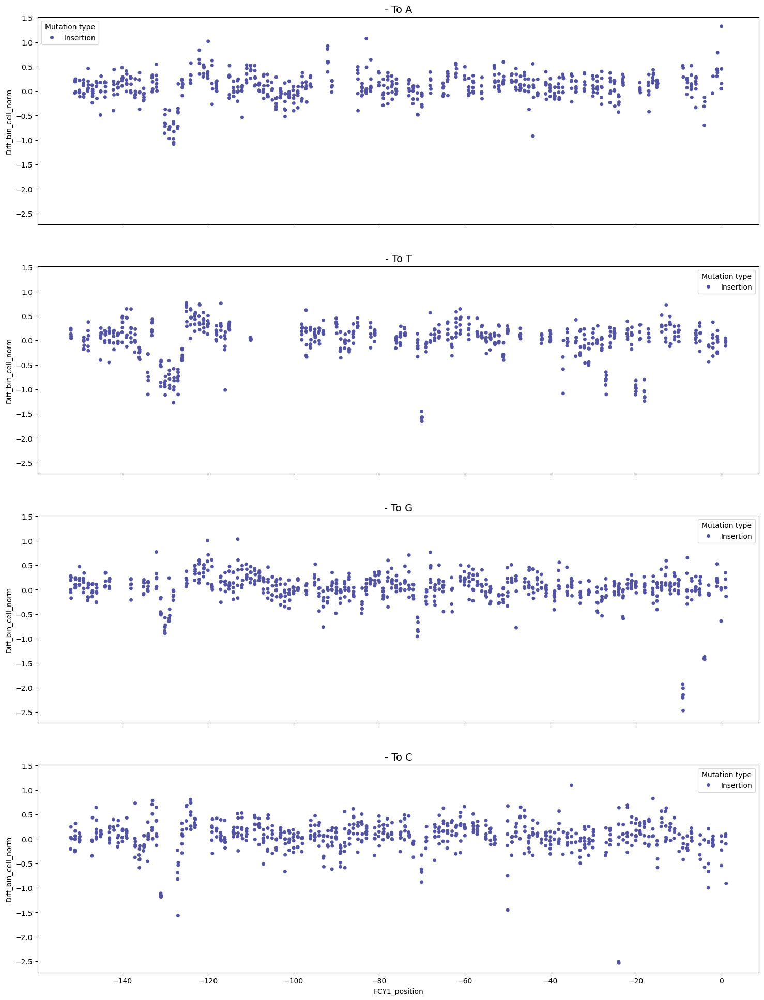

In [109]:
# Second figure: Insertions
# from top to bottom: A, T, G, C

sort_F3F4_ins = muts_all_F3F4[muts_all_F3F4['Mutation type'] == 'Insertion'].copy().reset_index(drop=True)

fig, axs = plt.subplots(4, 1, figsize=(18, 24), sharex=True, sharey=True)

sns.stripplot(data=sort_F3F4_ins[sort_F3F4_ins['New_nt'] == 'A'].copy(), x='FCY1_position', y='Diff_bin_cell_norm',
             hue='Mutation type', ax=axs[0], palette=mut_palette, native_scale=True)
axs[0].set_title('- To A', fontsize=14)

sns.stripplot(data=sort_F3F4_ins[sort_F3F4_ins['New_nt'] == 'T'].copy(), x='FCY1_position', y='Diff_bin_cell_norm',
             hue='Mutation type', ax=axs[1], palette=mut_palette, native_scale=True)
axs[1].set_title('- To T', fontsize=14)


sns.stripplot(data=sort_F3F4_ins[sort_F3F4_ins['New_nt'] == 'G'].copy(), x='FCY1_position', y='Diff_bin_cell_norm',
             hue='Mutation type', ax=axs[2], palette=mut_palette, native_scale=True)
axs[2].set_title('- To G', fontsize=14)

sns.stripplot(data=sort_F3F4_ins[sort_F3F4_ins['New_nt'] == 'C'].copy(), x='FCY1_position', y='Diff_bin_cell_norm',
             hue='Mutation type', ax=axs[3], palette=mut_palette, native_scale=True)
axs[3].set_title('- To C', fontsize=14)

<Axes: xlabel='FCY1_position', ylabel='Diff_bin_cell_norm'>

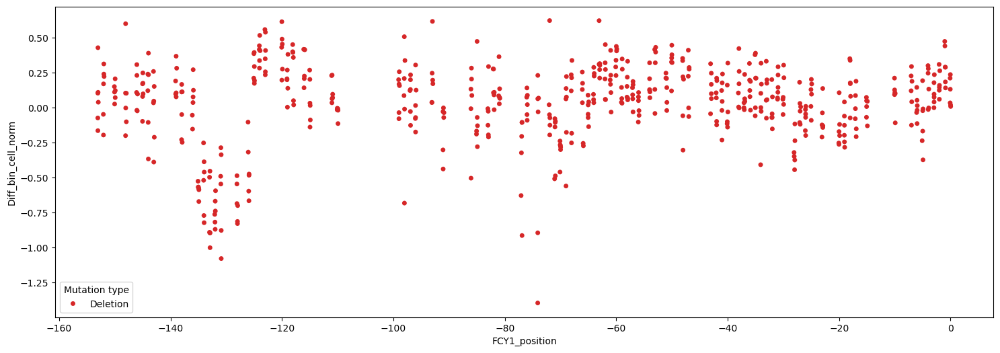

In [110]:
# Third figure: Deletions
sort_F3F4_del = muts_all_F3F4[muts_all_F3F4['Mutation type'] == 'Deletion'].copy().reset_index(drop=True)

fig, ax = plt.subplots(1, 1, figsize=(18, 6), sharex=True, sharey=True)

sns.stripplot(data=sort_F3F4_del, x='FCY1_position', y='Diff_bin_cell_norm',
             hue='Mutation type', ax=ax, palette=mut_palette, native_scale=True)

2) Without the dead bin

In [112]:
muts_NoDead_F3F4 = sort_F3F4_NoDead[sort_F3F4_NoDead['Genotype'] != 'WT'][['Lib_code', 'Genotype', 'Mutation type', 'Position', 'Diff_norm_NoDead']].copy().reset_index(drop=True)
muts_NoDead_F3F4['New_nt'] = muts_NoDead_F3F4['Genotype'].apply(lambda x: x.split('to')[1])
muts_NoDead_F3F4['FCY1_position'] = muts_NoDead_F3F4['Position'] - 205 + 1*(muts_NoDead_F3F4['Mutation type'] == 'Insertion')

Text(0.5, 1.0, 'N To C')

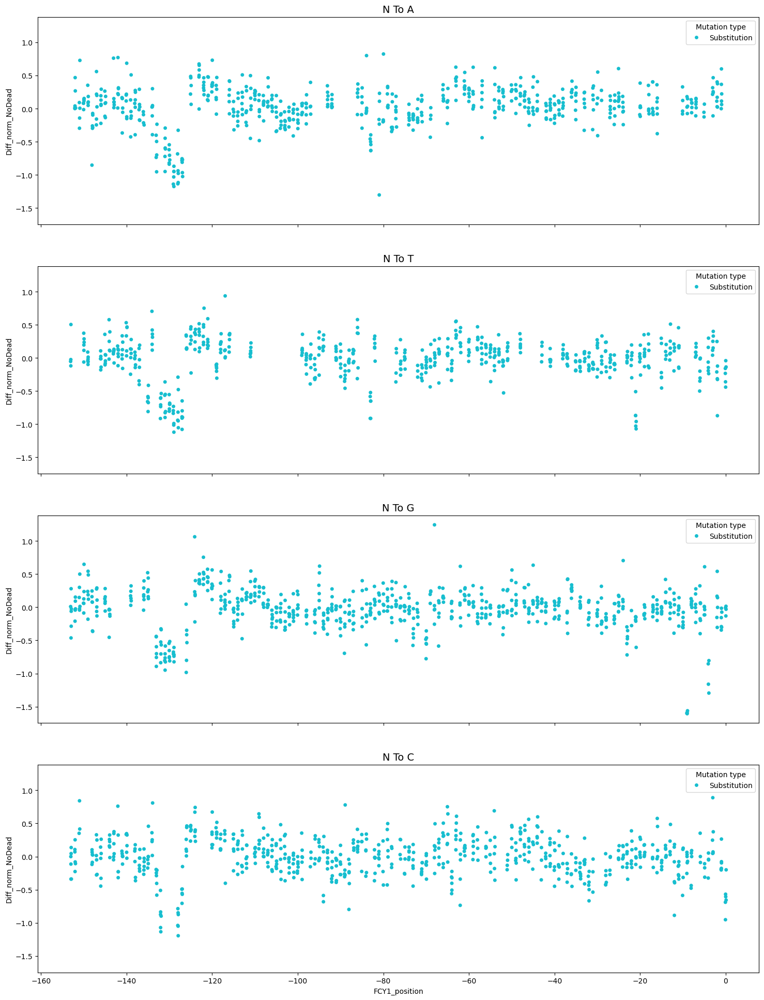

In [113]:
# For Substitutions
# from top to bottom: A, T, G, C

sort_NoDead_sub = muts_NoDead_F3F4[muts_NoDead_F3F4['Mutation type'] == 'Substitution'].copy().reset_index(drop=True)

fig, axs = plt.subplots(4, 1, figsize=(18, 24), sharex=True, sharey=True)

sns.stripplot(data=sort_NoDead_sub[sort_NoDead_sub['New_nt'] == 'A'].copy(), x='FCY1_position', y='Diff_norm_NoDead',
             hue='Mutation type', ax=axs[0], palette=mut_palette, native_scale=True)
axs[0].set_title('N To A', fontsize=14)

sns.stripplot(data=sort_NoDead_sub[sort_NoDead_sub['New_nt'] == 'T'].copy(), x='FCY1_position', y='Diff_norm_NoDead',
             hue='Mutation type', ax=axs[1], palette=mut_palette, native_scale=True)
axs[1].set_title('N To T', fontsize=14)


sns.stripplot(data=sort_NoDead_sub[sort_NoDead_sub['New_nt'] == 'G'].copy(), x='FCY1_position', y='Diff_norm_NoDead',
             hue='Mutation type', ax=axs[2], palette=mut_palette, native_scale=True)
axs[2].set_title('N To G', fontsize=14)

sns.stripplot(data=sort_NoDead_sub[sort_NoDead_sub['New_nt'] == 'C'].copy(), x='FCY1_position', y='Diff_norm_NoDead',
             hue='Mutation type', ax=axs[3], palette=mut_palette, native_scale=True)
axs[3].set_title('N To C', fontsize=14)

Text(0.5, 1.0, '- To C')

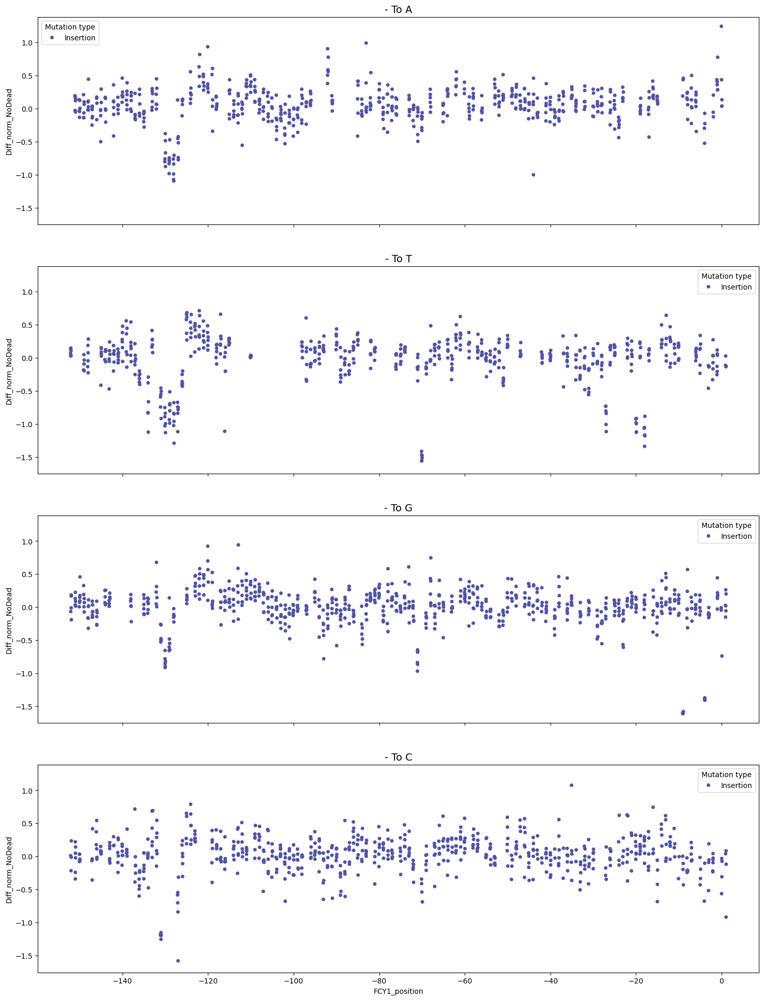

In [114]:
# For Insertions
# from top to bottom: A, T, G, C

sort_NoDead_ins = muts_NoDead_F3F4[muts_NoDead_F3F4['Mutation type'] == 'Insertion'].copy().reset_index(drop=True)

fig, axs = plt.subplots(4, 1, figsize=(18, 24), sharex=True, sharey=True)

sns.stripplot(data=sort_NoDead_ins[sort_NoDead_ins['New_nt'] == 'A'].copy(), x='FCY1_position', y='Diff_norm_NoDead',
             hue='Mutation type', ax=axs[0], palette=mut_palette, native_scale=True)
axs[0].set_title('- To A', fontsize=14)

sns.stripplot(data=sort_NoDead_ins[sort_NoDead_ins['New_nt'] == 'T'].copy(), x='FCY1_position', y='Diff_norm_NoDead',
             hue='Mutation type', ax=axs[1], palette=mut_palette, native_scale=True)
axs[1].set_title('- To T', fontsize=14)


sns.stripplot(data=sort_NoDead_ins[sort_NoDead_ins['New_nt'] == 'G'].copy(), x='FCY1_position', y='Diff_norm_NoDead',
             hue='Mutation type', ax=axs[2], palette=mut_palette, native_scale=True)
axs[2].set_title('- To G', fontsize=14)

sns.stripplot(data=sort_NoDead_ins[sort_NoDead_ins['New_nt'] == 'C'].copy(), x='FCY1_position', y='Diff_norm_NoDead',
             hue='Mutation type', ax=axs[3], palette=mut_palette, native_scale=True)
axs[3].set_title('- To C', fontsize=14)

<Axes: xlabel='FCY1_position', ylabel='Diff_norm_NoDead'>

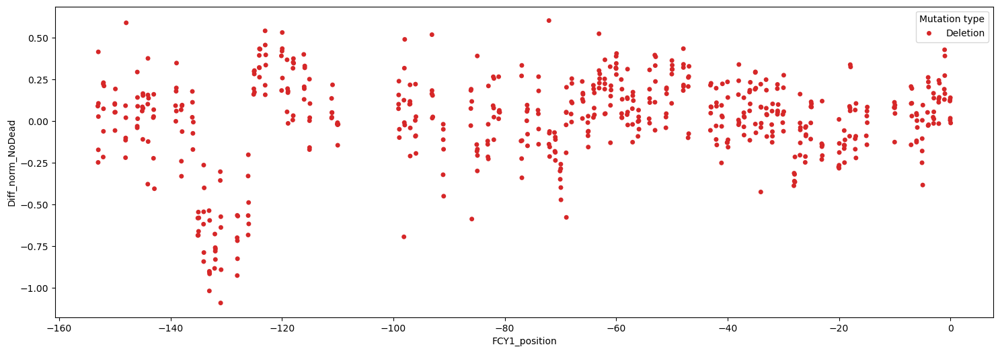

In [115]:
# For Deletions
sort_NoDead_del = muts_NoDead_F3F4[muts_NoDead_F3F4['Mutation type'] == 'Deletion'].copy().reset_index(drop=True)

fig, ax = plt.subplots(1, 1, figsize=(18, 6), sharex=True, sharey=True)

sns.stripplot(data=sort_NoDead_del, x='FCY1_position', y='Diff_norm_NoDead',
             hue='Mutation type', ax=ax, palette=mut_palette, native_scale=True)

Overall, outliers are rare and they are not that much more frequent when the 'dead' is used compared to when it is excluded from analysis.

## Identifying statistically significant hits

### Filtering out outlier measurements

Outlier removal is performed using the approach used previously with selection coefficient measurements

#### Computing median absolute deviation (MAD) for each replicate of each genotype

1) Scores computed using all sequencing bins

In [122]:
delta_medians_all = sort_all_filtered[['Genotype', 'Mutation type', 'Position', 'In_F3F4',
                                       'Diff_bin_cell_norm']].copy().groupby(by=['Genotype', 'Mutation type', 'Position', 'In_F3F4'], as_index=False).median()
delta_medians_all = delta_medians_all.rename(columns={'Diff_bin_cell_norm': 'Median_diff_norm'})

In [123]:
delta_MAD_all = sort_all_filtered[['Lib_code', 'Genotype', 'Mutation type', 'Position', 'In_F3F4','Diff_bin_cell_norm']].copy()

# Adding the medians
delta_MAD_all = pd.merge(delta_MAD_all, delta_medians_all, on=['Genotype', 'Mutation type', 'Position', 'In_F3F4'], how='left')

# Computing the absolute deviation from the median, and then the MAD
delta_MAD_all['Abs_med_diff_norm'] = np.abs(delta_MAD_all['Diff_bin_cell_norm'] - delta_MAD_all['Median_diff_norm'])

delta_MAD_calc = delta_MAD_all[['Genotype', 'Position', 'In_F3F4', 'Mutation type', 'Abs_med_diff_norm']].copy()
delta_MAD_calc = delta_MAD_calc.groupby(by=['Genotype', 'Position', 'In_F3F4', 'Mutation type'], as_index=False).median()
delta_MAD_calc = delta_MAD_calc.rename(columns={'Abs_med_diff_norm': 'MAD_diff_norm'})
delta_MAD_all = pd.merge(delta_MAD_all, delta_MAD_calc, on=['Genotype', 'Position', 'In_F3F4', 'Mutation type'], how='left')

# For each estimate, converting each abs deviation into a number of MADs
delta_MAD_all['n_MAD'] = delta_MAD_all['Abs_med_diff_norm'] / delta_MAD_all['MAD_diff_norm']

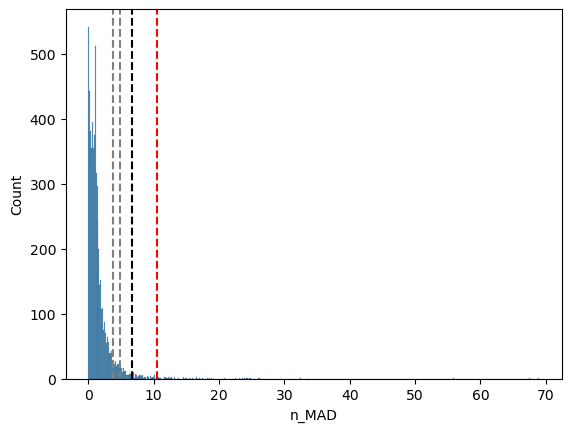

In [124]:
# Computing 95th, 97.5 and 99 percentiles
n_MAD_925_all = np.nanpercentile(delta_MAD_all['n_MAD'], 92.5)
n_MAD_95_all = np.nanpercentile(delta_MAD_all['n_MAD'], 95)
n_MAD_975_all = np.nanpercentile(delta_MAD_all['n_MAD'], 97.5)
n_MAD_99_all = np.nanpercentile(delta_MAD_all['n_MAD'], 99)

# Plotting the distribution
sns.histplot(data=delta_MAD_all, x='n_MAD')
plt.axvline(x=n_MAD_925_all, linestyle='--', c='grey')
plt.axvline(x=n_MAD_95_all, linestyle='--', c='grey')
plt.axvline(x=n_MAD_975_all, linestyle='--', c='black')
plt.axvline(x=n_MAD_99_all, linestyle='--', c='red')

2) Scores computed without using the 'dead' bin

In [126]:
delta_medians_NoDead = sort_NoDead_filtered[['Genotype', 'Mutation type', 'Position', 'In_F3F4',
                                             'Diff_norm_NoDead']].copy().groupby(by=['Genotype', 'Mutation type', 'Position', 'In_F3F4'], as_index=False).median()
delta_medians_NoDead = delta_medians_NoDead.rename(columns={'Diff_norm_NoDead': 'Median_diff_NoDead'})

In [127]:
delta_MAD_NoDead = sort_NoDead_filtered[['Lib_code', 'Genotype', 'Mutation type', 'Position', 'In_F3F4','Diff_norm_NoDead']].copy()

# Adding the medians
delta_MAD_NoDead = pd.merge(delta_MAD_NoDead, delta_medians_NoDead, on=['Genotype', 'Mutation type', 'Position', 'In_F3F4'], how='left')

# Computing the absolute deviation from the median, and then the MAD
delta_MAD_NoDead['Abs_med_diff_NoDead'] = np.abs(delta_MAD_NoDead['Diff_norm_NoDead'] - delta_MAD_NoDead['Median_diff_NoDead'])

delta_MAD_calc = delta_MAD_NoDead[['Genotype', 'Position', 'In_F3F4', 'Mutation type', 'Abs_med_diff_NoDead']].copy()
delta_MAD_calc = delta_MAD_calc.groupby(by=['Genotype', 'Position', 'In_F3F4', 'Mutation type'], as_index=False).median()
delta_MAD_calc = delta_MAD_calc.rename(columns={'Abs_med_diff_NoDead': 'MAD_diff_NoDead'})
delta_MAD_NoDead = pd.merge(delta_MAD_NoDead, delta_MAD_calc, on=['Genotype', 'Position', 'In_F3F4', 'Mutation type'], how='left')

# For each estimate, converting each abs deviation into a number of MADs
delta_MAD_NoDead['n_MAD'] = delta_MAD_NoDead['Abs_med_diff_NoDead'] / delta_MAD_NoDead['MAD_diff_NoDead']

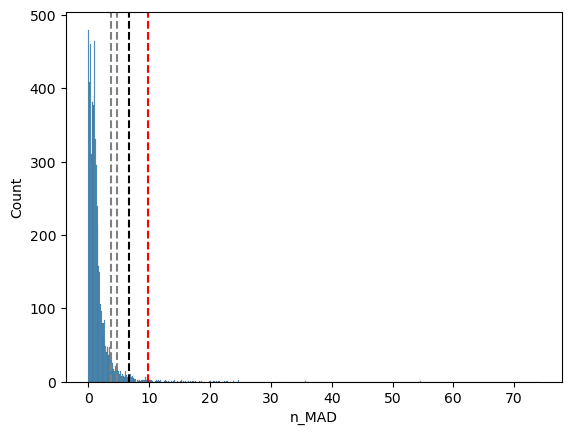

In [128]:
# Computing 95th, 97.5 and 99 percentiles
n_MAD_925_NoDead = np.nanpercentile(delta_MAD_NoDead['n_MAD'], 92.5)
n_MAD_95_NoDead = np.nanpercentile(delta_MAD_NoDead['n_MAD'], 95)
n_MAD_975_NoDead = np.nanpercentile(delta_MAD_NoDead['n_MAD'], 97.5)
n_MAD_99_NoDead = np.nanpercentile(delta_MAD_NoDead['n_MAD'], 99)

# Plotting the distribution
sns.histplot(data=delta_MAD_NoDead, x='n_MAD')
plt.axvline(x=n_MAD_925_NoDead, linestyle='--', c='grey')
plt.axvline(x=n_MAD_95_NoDead, linestyle='--', c='grey')
plt.axvline(x=n_MAD_975_NoDead, linestyle='--', c='black')
plt.axvline(x=n_MAD_99_NoDead, linestyle='--', c='red')

#### Computing standard deviations for each genotype

1) For scores using all bins

In [131]:
# Compiling the standard deviations
diff_all_std = sort_all_filtered[['Genotype', 'Position', 'In_F3F4', 'Mutation type',
                                  'Diff_bin_cell_norm']].groupby(by=['Genotype', 'Position', 'In_F3F4', 'Mutation type'], as_index=False).std()
diff_all_std = diff_all_std.rename(columns={'Diff_bin_cell_norm': 'Std_diff_all'})

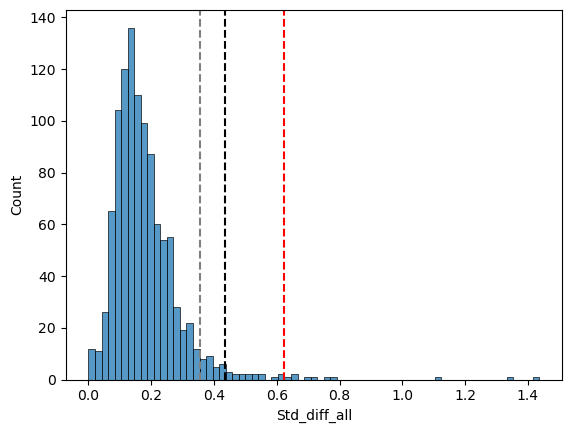

In [132]:
# Plotting the distribution of standard deviations, with 95th, 97.5th and 99th percentiles
std_95_all = np.nanpercentile(diff_all_std['Std_diff_all'], 95)
std_975_all = np.nanpercentile(diff_all_std['Std_diff_all'], 97.5)
std_99_all = np.nanpercentile(diff_all_std['Std_diff_all'], 99)

sns.histplot(data=diff_all_std, x='Std_diff_all')
plt.axvline(x=std_95_all, linestyle='--', c='grey')
plt.axvline(x=std_975_all, linestyle='--', c='black')
plt.axvline(x=std_99_all, linestyle='--', c='red')

Filtering of outlier replicates will only be performed among genotypes with std in the top 5%

2) For score obtained without the 'dead' bin

In [135]:
diff_NoDead_std = sort_NoDead_filtered[['Genotype', 'Position', 'In_F3F4', 'Mutation type',
                                  'Diff_norm_NoDead']].groupby(by=['Genotype', 'Position', 'In_F3F4', 'Mutation type'], as_index=False).std()
diff_NoDead_std = diff_NoDead_std.rename(columns={'Diff_norm_NoDead': 'Std_diff_NoDead'})

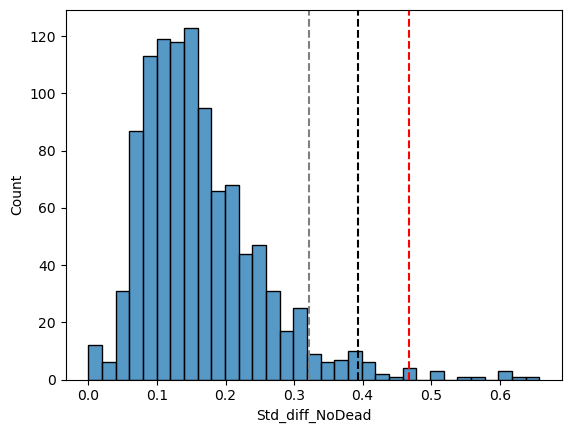

In [136]:
# Plotting the distribution of standard deviations, with 95th, 97.5th and 99th percentiles
std_95_NoDead = np.nanpercentile(diff_NoDead_std['Std_diff_NoDead'], 95)
std_975_NoDead = np.nanpercentile(diff_NoDead_std['Std_diff_NoDead'], 97.5)
std_99_NoDead = np.nanpercentile(diff_NoDead_std['Std_diff_NoDead'], 99)

sns.histplot(data=diff_NoDead_std, x='Std_diff_NoDead')
plt.axvline(x=std_95_NoDead, linestyle='--', c='grey')
plt.axvline(x=std_975_NoDead, linestyle='--', c='black')
plt.axvline(x=std_99_NoDead, linestyle='--', c='red')

The 95th percentile will also be used as threshold.

#### Removing outlier MADs, only within genotypes with outlier standard deviation

1) Scores using all bins

In [140]:
# Selecting genotypes on which the filtering must be applied
out_df_all = diff_all_std[diff_all_std['Std_diff_all'] >= std_95_all].copy().reset_index(drop=True)
mut_to_filter_all = out_df_all['Genotype'].unique()

In [141]:
# Identifying the datapoints to remove
not_filtered_all = delta_MAD_all[~delta_MAD_all['Genotype'].isin(mut_to_filter_all)].copy()
to_filter_all = delta_MAD_all[delta_MAD_all['Genotype'].isin(mut_to_filter_all)].copy()
to_filter_all['To_remove'] = to_filter_all['n_MAD'] > n_MAD_95_all

# Adding back transfo replicate (mistakenly removed)
to_filter_all['Transfo_rep'] = to_filter_all['Lib_code'].apply(lambda x: x[0])

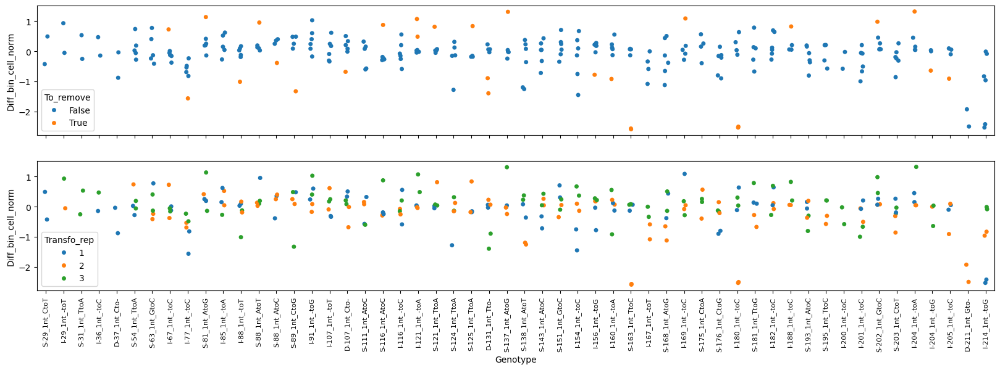

In [142]:
# All variants
fig, axs = plt.subplots(2, 1, figsize=(20, 6), sharex=True)
sns.stripplot(data=to_filter_all.sort_values(by='Position'), x='Genotype', y='Diff_bin_cell_norm', hue='To_remove', ax=axs[0])
axs[0].tick_params(axis='x', labelrotation=90)

sns.stripplot(data=to_filter_all.sort_values(by='Position'), x='Genotype', y='Diff_bin_cell_norm', hue='Transfo_rep', ax=axs[1])
axs[1].tick_params(axis='x', labelrotation=90, labelsize=8)

It mostly seems to work as intended, although some outliers seem to remain (for instance S-124_1nt_TtoA). F3-F4 mutations are from position 52 to position 205 using this numbering.

2) Now using scores computed without the 'dead' bin

In [145]:
# Selecting genotypes on which the filtering must be applied
out_df_NoDead = diff_NoDead_std[diff_NoDead_std['Std_diff_NoDead'] >= std_95_NoDead].copy().reset_index(drop=True)
mut_to_filter_NoDead = out_df_NoDead['Genotype'].unique()

In [146]:
# Identifying the datapoints to remove
not_filtered_NoDead = delta_MAD_NoDead[~delta_MAD_NoDead['Genotype'].isin(mut_to_filter_NoDead)].copy()
to_filter_NoDead = delta_MAD_NoDead[delta_MAD_NoDead['Genotype'].isin(mut_to_filter_NoDead)].copy()
to_filter_NoDead['To_remove'] = to_filter_NoDead['n_MAD'] > n_MAD_925_NoDead

# Adding back transfo replicate (mistakenly removed)
to_filter_NoDead['Transfo_rep'] = to_filter_NoDead['Lib_code'].apply(lambda x: x[0])

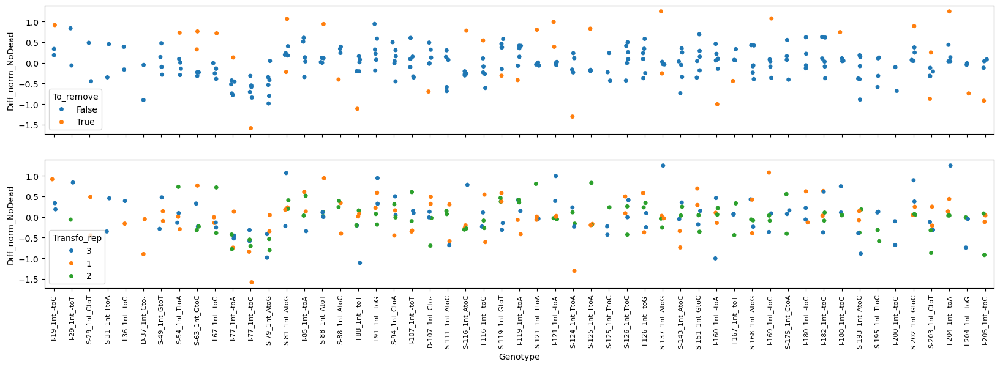

In [147]:
# All variants
fig, axs = plt.subplots(2, 1, figsize=(20, 6), sharex=True)
sns.stripplot(data=to_filter_NoDead.sort_values(by='Position'), x='Genotype', y='Diff_norm_NoDead', hue='To_remove', ax=axs[0])
axs[0].tick_params(axis='x', labelrotation=90)

sns.stripplot(data=to_filter_NoDead.sort_values(by='Position'), x='Genotype', y='Diff_norm_NoDead', hue='Transfo_rep', ax=axs[1])
axs[1].tick_params(axis='x', labelrotation=90, labelsize=8)

A slightly more stringent (lower percentile) threshold on MAD seem to work well for the 'NoDead' data.

#### Assembling the datasets without outliers

In [150]:
# Using all sequencing bins
out_filtered_all = to_filter_all[to_filter_all['To_remove'] == False].copy().reset_index(drop=True)
out_filtered_all = out_filtered_all.drop(columns=['To_remove', 'Transfo_rep'])
delta_no_out_all = pd.concat([not_filtered_all, out_filtered_all]).reset_index(drop=True)

In [151]:
# Excluding the 'dead' sequencing bin
out_filtered_NoDead = to_filter_NoDead[to_filter_NoDead['To_remove'] == False].copy().reset_index(drop=True)
out_filtered_NoDead = out_filtered_NoDead.drop(columns=['To_remove', 'Transfo_rep'])
delta_no_out_NoDead = pd.concat([not_filtered_NoDead, out_filtered_NoDead]).reset_index(drop=True)

In [152]:
delta_no_out_all.columns

Index(['Lib_code', 'Genotype', 'Mutation type', 'Position', 'In_F3F4',
       'Diff_bin_cell_norm', 'Median_diff_norm', 'Abs_med_diff_norm',
       'MAD_diff_norm', 'n_MAD'],
      dtype='object')

### Identifying mutations with a significant effect on expression level

#### First, using Delta scores from all bins

In [155]:
# Recomputing the medians, min and max on the dataset without outliers
sort_scores_all = delta_no_out_all.drop(columns=['Lib_code', 'Median_diff_norm', 'Abs_med_diff_norm','MAD_diff_norm',
                                                 'n_MAD']).groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).median()
sort_scores_all = sort_scores_all.rename(columns={'Diff_bin_cell_norm': 'Median_delta_WT'})

min_all_final = delta_no_out_all.drop(columns=['Lib_code', 'Median_diff_norm', 'Abs_med_diff_norm','MAD_diff_norm',
                                               'n_MAD']).groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).min()
min_all_final = min_all_final.rename(columns={'Diff_bin_cell_norm': 'Min_delta_WT'})

max_all_final = delta_no_out_all.drop(columns=['Lib_code', 'Median_diff_norm', 'Abs_med_diff_norm','MAD_diff_norm',
                                               'n_MAD']).groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).max()
max_all_final = max_all_final.rename(columns={'Diff_bin_cell_norm': 'Max_delta_WT'})

sort_scores_all = pd.merge(sort_scores_all, min_all_final, on=['Mutation type', 'Genotype', 'Position', 'In_F3F4']).reset_index(drop=True)
sort_scores_all = pd.merge(sort_scores_all, max_all_final, on=['Mutation type', 'Genotype', 'Position', 'In_F3F4']).reset_index(drop=True)

# Adding columns to store the results of t-tests
sort_scores_all['not_zero_p-val'] = np.nan
sort_scores_all['n_observed'] = np.nan

sort_scores_all['FCY1_position'] = sort_scores_all['Position'] - 205 + 1*(sort_scores_all['Mutation type'] == 'Insertion')

In [156]:
for row in range(sort_scores_all.shape[0]):
    current_mut = sort_scores_all.at[row, 'Genotype']
    data_subset = delta_no_out_all[delta_no_out_all['Genotype'] == current_mut].copy().reset_index(drop=True)
    n_obs = data_subset.shape[0]
    sort_scores_all.at[row, 'n_observed'] = n_obs
    t_test = stats.ttest_1samp(data_subset['Diff_bin_cell_norm'], 0, nan_policy='omit')
    sort_scores_all.at[row, 'not_zero_p-val'] = t_test.pvalue

F:\Anaconda_SA\envs\FCY1prom_final\Lib\site-packages\scipy\stats\_stats_py.py:1214: RuntimeWarning: divide by zero encountered in divide
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero
F:\Anaconda_SA\envs\FCY1prom_final\Lib\site-packages\scipy\stats\_stats_py.py:1214: RuntimeWarning: invalid value encountered in scalar multiply
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero


In [157]:
# Performing Benjamini-Hochberg correction
sort_scores_all = sort_scores_all.dropna(subset=['not_zero_p-val']).copy().reset_index(drop=True)
sort_scores_all['not_zero_FDR'] = stats.false_discovery_control(sort_scores_all['not_zero_p-val'])

In [158]:
# Selecting only mutations with a significant effect, at FDR = 2.5%
sort_all_hits = sort_scores_all[sort_scores_all['not_zero_FDR'] < 0.05].copy().reset_index(drop=True)

In [159]:
# How many hits in the F3-F4 region?
hits_F3F4_all = sort_all_hits[sort_all_hits['In_F3F4']].copy().reset_index(drop=True)
n_hits_F3F4 = hits_F3F4_all.shape[0]
print(f'There are {n_hits_F3F4} hits among F3-F4 mutations')

There are 211 hits among F3-F4 mutations


#### Second, using Delta scores ignoring the 'dead' bin

In [161]:
delta_no_out_NoDead.columns

Index(['Lib_code', 'Genotype', 'Mutation type', 'Position', 'In_F3F4',
       'Diff_norm_NoDead', 'Median_diff_NoDead', 'Abs_med_diff_NoDead',
       'MAD_diff_NoDead', 'n_MAD'],
      dtype='object')

In [162]:
# Recomputing the medians, min and max on the dataset without outliers
sort_scores_NoDead = delta_no_out_NoDead.drop(columns=['Lib_code', 'Median_diff_NoDead', 'Abs_med_diff_NoDead', 'MAD_diff_NoDead',
                                                       'n_MAD']).groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).median()
sort_scores_NoDead = sort_scores_NoDead.rename(columns={'Diff_norm_NoDead': 'Median_delta_WT_NoDead'})

min_NoDead_final = delta_no_out_NoDead.drop(columns=['Lib_code', 'Median_diff_NoDead', 'Abs_med_diff_NoDead', 'MAD_diff_NoDead',
                                                     'n_MAD']).groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).min()
min_NoDead_final = min_NoDead_final.rename(columns={'Diff_norm_NoDead': 'Min_delta_WT_NoDead'})

max_NoDead_final = delta_no_out_NoDead.drop(columns=['Lib_code', 'Median_diff_NoDead', 'Abs_med_diff_NoDead', 'MAD_diff_NoDead',
                                                     'n_MAD']).groupby(by=['Mutation type', 'Genotype', 'Position', 'In_F3F4'], as_index=False).max()
max_NoDead_final = max_NoDead_final.rename(columns={'Diff_norm_NoDead': 'Max_delta_WT_NoDead'})

sort_scores_NoDead = pd.merge(sort_scores_NoDead, min_NoDead_final, on=['Mutation type', 'Genotype', 'Position', 'In_F3F4']).reset_index(drop=True)
sort_scores_NoDead = pd.merge(sort_scores_NoDead, max_NoDead_final, on=['Mutation type', 'Genotype', 'Position', 'In_F3F4']).reset_index(drop=True)

# Adding columns to store the results of t-tests
sort_scores_NoDead['not_zero_p-val'] = np.nan
sort_scores_NoDead['n_observed'] = np.nan

sort_scores_NoDead['FCY1_position'] = sort_scores_NoDead['Position'] - 205 + 1*(sort_scores_NoDead['Mutation type'] == 'Insertion')

In [163]:
for row in range(sort_scores_NoDead.shape[0]):
    current_mut = sort_scores_NoDead.at[row, 'Genotype']
    data_subset = delta_no_out_NoDead[delta_no_out_NoDead['Genotype'] == current_mut].copy().reset_index(drop=True)
    n_obs = data_subset.shape[0]
    sort_scores_NoDead.at[row, 'n_observed'] = n_obs
    t_test = stats.ttest_1samp(data_subset['Diff_norm_NoDead'], 0, nan_policy='omit')
    sort_scores_NoDead.at[row, 'not_zero_p-val'] = t_test.pvalue

F:\Anaconda_SA\envs\FCY1prom_final\Lib\site-packages\scipy\stats\_stats_py.py:1214: RuntimeWarning: divide by zero encountered in divide
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero
F:\Anaconda_SA\envs\FCY1prom_final\Lib\site-packages\scipy\stats\_stats_py.py:1214: RuntimeWarning: invalid value encountered in scalar multiply
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero


In [164]:
# Performing Benjamini-Hochberg correction
sort_scores_NoDead = sort_scores_NoDead.dropna(subset=['not_zero_p-val']).copy().reset_index(drop=True)
sort_scores_NoDead['not_zero_FDR'] = stats.false_discovery_control(sort_scores_NoDead['not_zero_p-val'])

In [165]:
# Selecting only mutations with a significant effect, at FDR = 5%
sort_NoDead_hits = sort_scores_NoDead[sort_scores_NoDead['not_zero_FDR'] < 0.05].copy().reset_index(drop=True)

In [166]:
# How many hits in the F3-F4 region?
hits_F3F4_NoDead = sort_NoDead_hits[sort_NoDead_hits['In_F3F4']].copy().reset_index(drop=True)
n_hits_F3F4 = hits_F3F4_NoDead.shape[0]
print(f'There are {n_hits_F3F4} hits among F3-F4 mutations')

There are 208 hits among F3-F4 mutations


It seems that using one score or the other has almost no effect on the resulting hits.

### Assessing the overlap among hits in F3-F4 genotypes between 'all' and 'NoDead' scores

What is the Jaccard index?

In [170]:
hits_all = set(hits_F3F4_all['Genotype'].unique())
hits_NoDead = set(hits_F3F4_NoDead['Genotype'].unique())

jac_index = len(hits_all & hits_NoDead) / len(hits_all | hits_NoDead)
print(jac_index)

0.7531380753138075


Although we get almost the same number of hits, the Jaccard index is not that high!

Are the hits which are not shared simply small effects (which could be false positives)?

In [173]:
shared_hits = hits_all & hits_NoDead

hits_F3F4_all['Shared_hit'] = hits_F3F4_all['Genotype'].apply(lambda x: True if x in shared_hits else False)
hits_F3F4_NoDead['Shared_hit'] = hits_F3F4_NoDead['Genotype'].apply(lambda x: True if x in shared_hits else False)

Text(0.5, 1.0, "Without 'dead' bin")

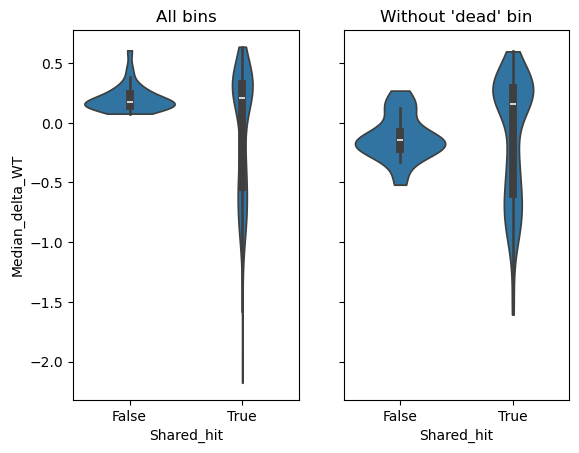

In [174]:
# Plotting the distributions
fig, axs = plt.subplots(1, 2, sharey=True)

sns.violinplot(data=hits_F3F4_all, x='Shared_hit', y='Median_delta_WT', ax=axs[0], cut=0)
axs[0].set_title('All bins')
sns.violinplot(data=hits_F3F4_NoDead, x='Shared_hit', y='Median_delta_WT_NoDead', ax=axs[1], cut=0)
axs[1].set_title("Without 'dead' bin")

The hits which are not shared a clearly associated with smaller effects.

The fact that the distribution (of non shared hits) is much wider on the right suggests that scores computed without using the 'dead' bin may actually not be the best ones...

#### Comparing Delta scores for hits which are not shared among the two methods

In [178]:
gen_not_shared = hits_all ^ hits_NoDead

scores_all_tocomp = sort_scores_all[['Genotype', 'Mutation type', 'Position', 'FCY1_position', 'In_F3F4', 'Median_delta_WT']].copy()
scores_NoDead_tocomp = sort_scores_NoDead[['Genotype', 'Mutation type', 'Position', 'FCY1_position', 'In_F3F4', 'Median_delta_WT_NoDead']].copy()


scores_not_shared = pd.merge(scores_all_tocomp[scores_all_tocomp['Genotype'].isin(gen_not_shared)].copy().reset_index(drop=True),
                             sort_scores_NoDead[sort_scores_NoDead['Genotype'].isin(gen_not_shared)].copy().reset_index(drop=True),
                            on=['Genotype', 'Mutation type', 'Position', 'FCY1_position', 'In_F3F4'])

Text(-0.4, 0.15, '$r$ = 0.983\np-val = 8.083e-44')

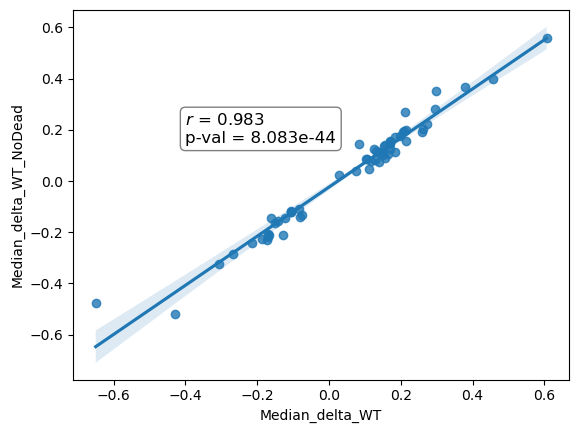

In [179]:
sns.regplot(data=scores_not_shared, x='Median_delta_WT', y='Median_delta_WT_NoDead')

scores_nonan = scores_not_shared.dropna(subset=['Median_delta_WT', 'Median_delta_WT_NoDead'])
r_coeff = stats.pearsonr(scores_nonan['Median_delta_WT'], scores_nonan['Median_delta_WT_NoDead'])

plt.annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
             (-0.4, 0.15), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)

Although the classification as "significant" or not varies a lot, the scores are almost identical.

What about the F3-F4 hits which are shared?

In [182]:
gen_shared = hits_all & hits_NoDead


scores_shared = pd.merge(scores_all_tocomp[scores_all_tocomp['Genotype'].isin(gen_shared)].copy().reset_index(drop=True),
                             sort_scores_NoDead[sort_scores_NoDead['Genotype'].isin(gen_shared)].copy().reset_index(drop=True),
                            on=['Genotype', 'Mutation type', 'Position', 'FCY1_position', 'In_F3F4'])

Text(-1.5, 0.15, '$r$ = 0.995\np-val = 4.008e-178')

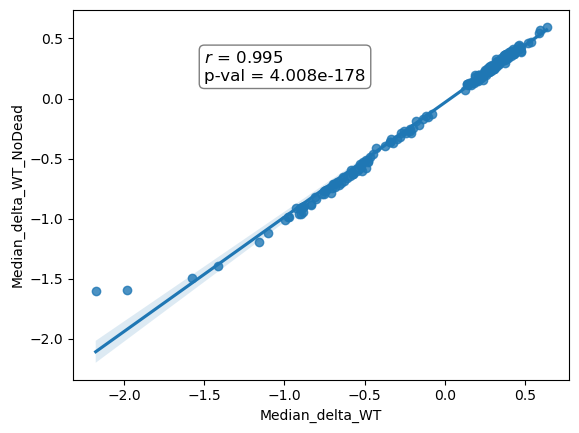

In [183]:
sns.regplot(data=scores_shared, x='Median_delta_WT', y='Median_delta_WT_NoDead')

scores_nonan = scores_shared.dropna(subset=['Median_delta_WT', 'Median_delta_WT_NoDead'])
r_coeff = stats.pearsonr(scores_nonan['Median_delta_WT'], scores_nonan['Median_delta_WT_NoDead'])

plt.annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
             (-1.5, 0.15), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)

The scores of shared hits are also extremely similar. There are however two notable exceptions, which almost abolish FCY1 expression. **This deviation may be sufficient to justify using the scores computed using all bins for the later conversion of SortSeq scores into relative fluorescence.**

Because the 'All' scores are more biased towards positive values (**to validate**), it might make sense to use the "NoDead" scores to identify significant hits, but then report the coresponding 'All' scores to estimate mutational effects.

How do the distributions of both scores compare?

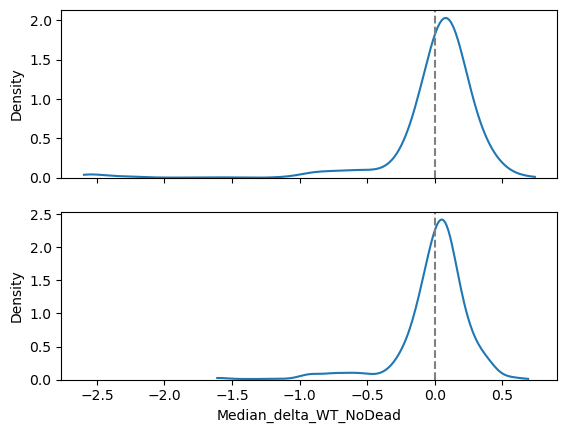

In [187]:
fig, axs = plt.subplots(2, 1, sharex=True)

sns.kdeplot(data=sort_scores_all, x='Median_delta_WT', ax=axs[0], cut=0)
sns.kdeplot(data=sort_scores_NoDead, x='Median_delta_WT_NoDead', ax=axs[1], cut=0)

axs[0].axvline(x=0, linestyle='--', c='grey')
axs[1].axvline(x=0, linestyle='--', c='grey')

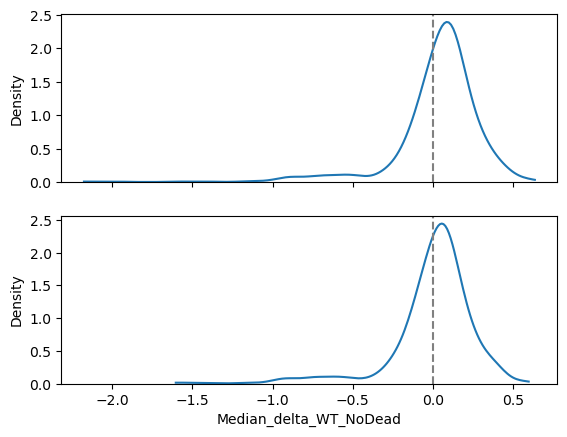

In [188]:
# If considering only F3-F4 variants
fig, axs = plt.subplots(2, 1, sharex=True)

sns.kdeplot(data=sort_scores_all[sort_scores_all['In_F3F4']], x='Median_delta_WT', ax=axs[0], cut=0)
sns.kdeplot(data=sort_scores_NoDead[sort_scores_NoDead['In_F3F4']], x='Median_delta_WT_NoDead', ax=axs[1], cut=0)

axs[0].axvline(x=0, linestyle='--', c='grey')
axs[1].axvline(x=0, linestyle='--', c='grey')

The bias towards positive values is quite similar in both cases.

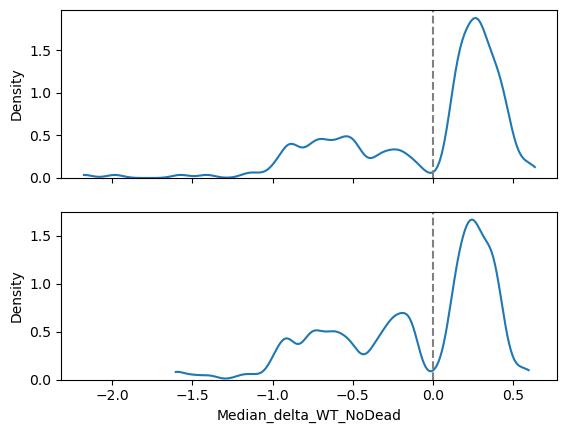

In [190]:
# If considering only significant hits among F3-F4 variants
fig, axs = plt.subplots(2, 1, sharex=True)

sns.kdeplot(data=hits_F3F4_all, x='Median_delta_WT', ax=axs[0], cut=0, bw_adjust=0.3)
sns.kdeplot(data=hits_F3F4_NoDead, x='Median_delta_WT_NoDead', ax=axs[1], cut=0, bw_adjust=0.3)

axs[0].axvline(x=0, linestyle='--', c='grey')
axs[1].axvline(x=0, linestyle='--', c='grey')

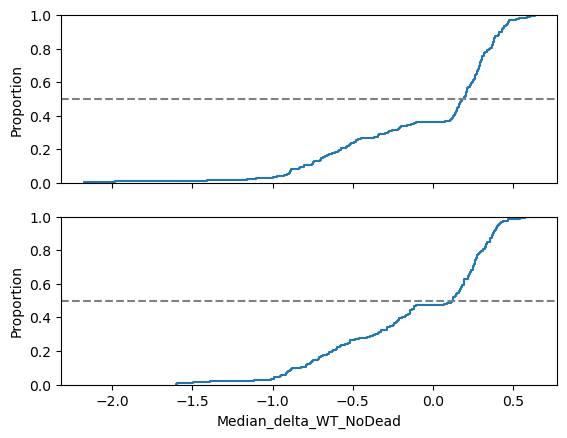

In [191]:
fig, axs = plt.subplots(2, 1, sharex=True)

sns.ecdfplot(data=hits_F3F4_all, x='Median_delta_WT', ax=axs[0])
sns.ecdfplot(data=hits_F3F4_NoDead, x='Median_delta_WT_NoDead', ax=axs[1])

axs[0].axhline(y=0.5, linestyle='--', c='grey')
axs[1].axhline(y=0.5, linestyle='--', c='grey')

To avoid misrepresenting mutations strongly decreasing expression, the 'All' scores will be used to assess mutational effects. Statistical significance will however be called according to the "No Dead" scores, since they display less bias towards positive values.

### Assessing between-replicate correlations when only significant hits are considered

This is performed using both sets of significant hits (and the corresponding scores).

In [195]:
no_out_all_corr = delta_no_out_all.pivot(columns='Lib_code', index='Genotype', values='Diff_bin_cell_norm')

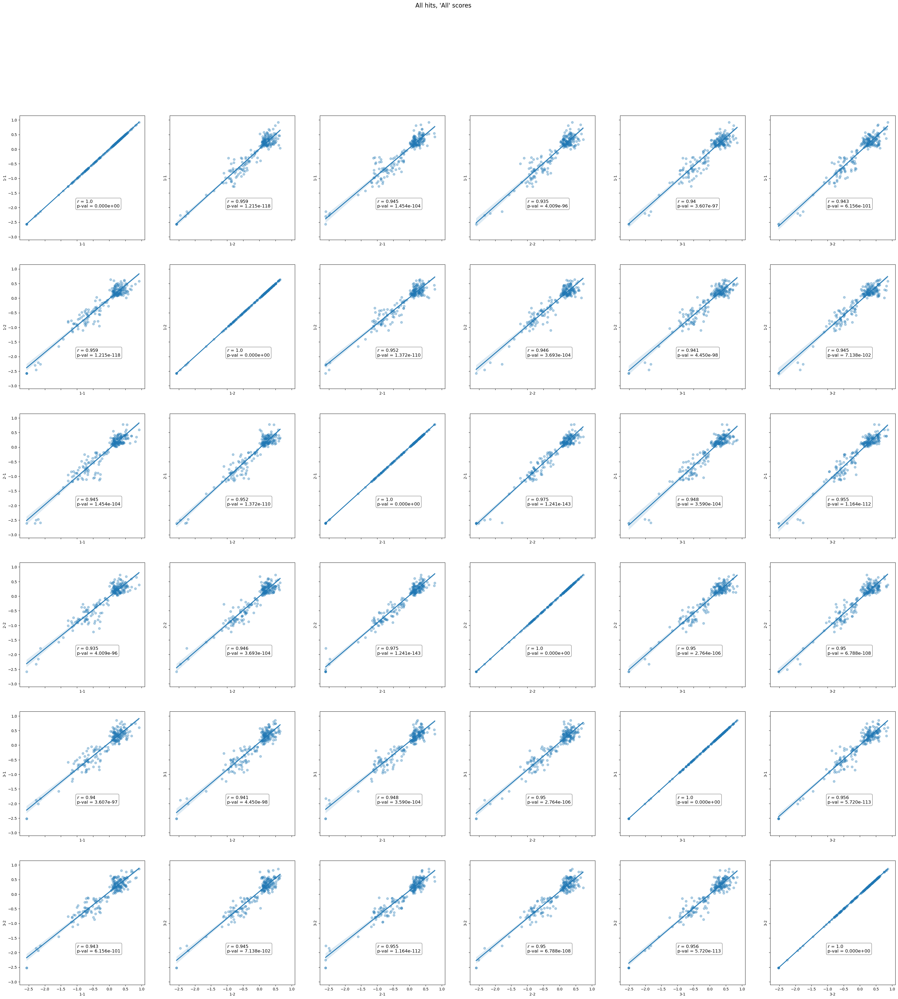

In [196]:
# 1) All hits, using "All" scores
all_hits_comp = no_out_all_corr.loc[list(sort_all_hits['Genotype'].unique()),:].copy()

# Correlations for the 'all' dataset
fig, axs = plt.subplots(6, 6, figsize=(42, 42), sharex=True, sharey=True)
row = 0
col = 0

for lib_b in all_hits_comp.columns:
    for lib_a in all_hits_comp.columns:
        
        sns.regplot(data=all_hits_comp, x=lib_a, y=lib_b, ax=axs[row, col], scatter_kws={'alpha':0.35})

        if lib_a == lib_b:
            coeff_calc = all_hits_comp[[lib_a]].copy().dropna().reset_index(drop=True)
        else:
            coeff_calc = all_hits_comp[[lib_a, lib_b]].copy().dropna().reset_index(drop=True)
            
        r_coeff = stats.pearsonr(coeff_calc[lib_a], coeff_calc[lib_b])
        axs[row, col].annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
                           (-1, -2), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)
        if col == 5:
            row += 1
            col = 0
        
        else:
            col += 1

fig.suptitle("All hits, 'All' scores", fontsize=16)

Diff_norm_corr = plt.gcf()
Diff_norm_corr.savefig('SortSeq_data/Corr_hits_all_all.png', bbox_inches='tight')

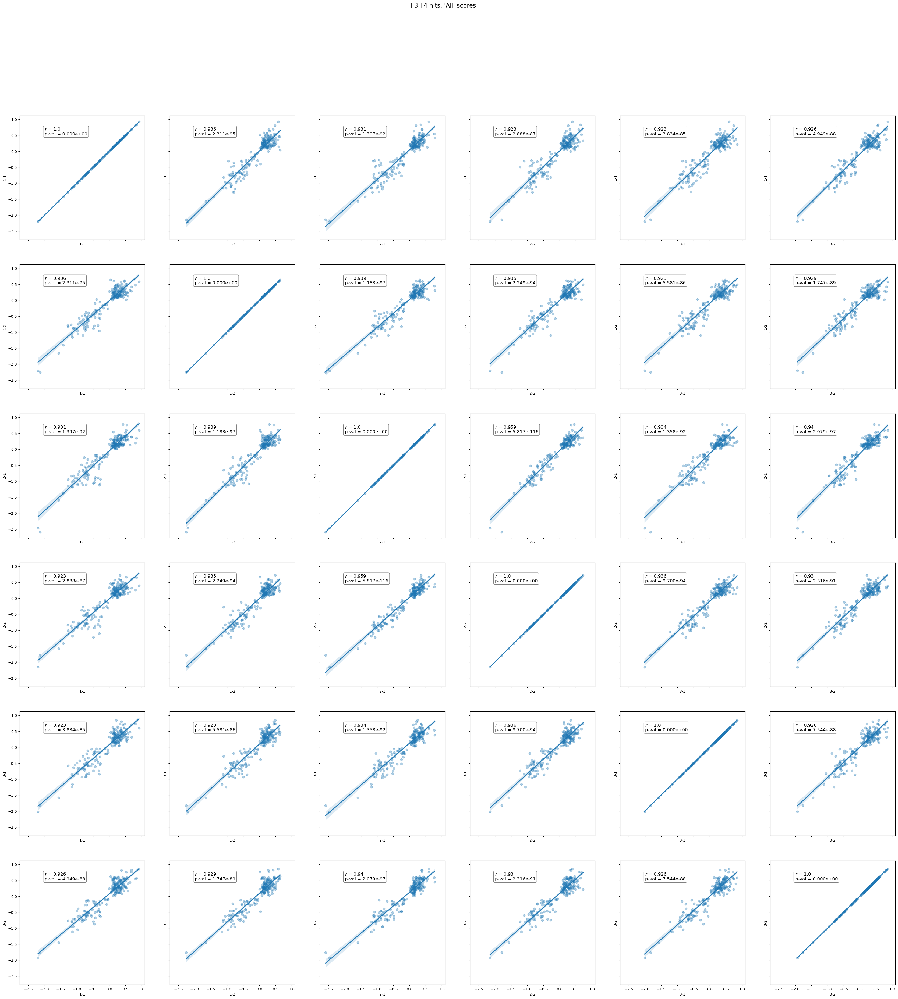

In [197]:
# 2) F3F4 hits, using "All" scores
all_F3F4_comp = no_out_all_corr.loc[list(hits_all),:].copy()

# Correlations for the 'all' dataset
fig, axs = plt.subplots(6, 6, figsize=(42, 42), sharex=True, sharey=True)
row = 0
col = 0

for lib_b in all_F3F4_comp.columns:
    for lib_a in all_F3F4_comp.columns:
        
        sns.regplot(data=all_F3F4_comp, x=lib_a, y=lib_b, ax=axs[row, col], scatter_kws={'alpha':0.35})

        if lib_a == lib_b:
            coeff_calc = all_F3F4_comp[[lib_a]].copy().dropna().reset_index(drop=True)
        else:
            coeff_calc = all_F3F4_comp[[lib_a, lib_b]].copy().dropna().reset_index(drop=True)
            
        r_coeff = stats.pearsonr(coeff_calc[lib_a], coeff_calc[lib_b])
        axs[row, col].annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
                           (-2, 0.5), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)
        if col == 5:
            row += 1
            col = 0
        
        else:
            col += 1

fig.suptitle("F3-F4 hits, 'All' scores", fontsize=16)

Diff_norm_corr = plt.gcf()
Diff_norm_corr.savefig('SortSeq_data/Corr_hits_F3F4_all.png', bbox_inches='tight')

In [198]:
no_out_NoDead_corr = delta_no_out_NoDead.pivot(columns='Lib_code', index='Genotype', values='Diff_norm_NoDead')

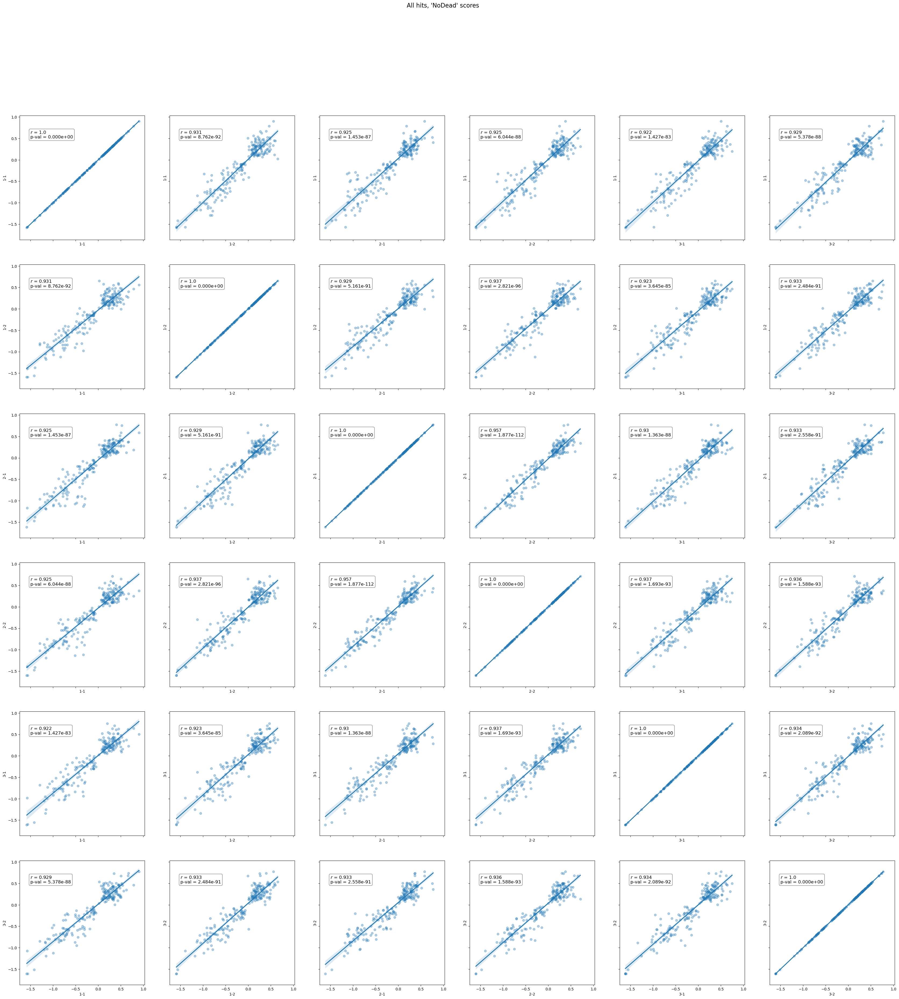

In [199]:
# 3) All hits, using "NoDead" scores
NoDead_hits_comp = no_out_NoDead_corr.loc[list(sort_NoDead_hits['Genotype'].unique()),:].copy()

# Correlations for the 'all' dataset
fig, axs = plt.subplots(6, 6, figsize=(42, 42), sharex=True, sharey=True)
row = 0
col = 0

for lib_b in NoDead_hits_comp.columns:
    for lib_a in NoDead_hits_comp.columns:
        
        sns.regplot(data=NoDead_hits_comp, x=lib_a, y=lib_b, ax=axs[row, col], scatter_kws={'alpha':0.35})

        if lib_a == lib_b:
            coeff_calc = NoDead_hits_comp[[lib_a]].copy().dropna().reset_index(drop=True)
        else:
            coeff_calc = NoDead_hits_comp[[lib_a, lib_b]].copy().dropna().reset_index(drop=True)
            
        r_coeff = stats.pearsonr(coeff_calc[lib_a], coeff_calc[lib_b])
        axs[row, col].annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
                           (-1.5, 0.5), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)
        if col == 5:
            row += 1
            col = 0
        
        else:
            col += 1

fig.suptitle("All hits, 'NoDead' scores", fontsize=16)

Diff_norm_corr = plt.gcf()
Diff_norm_corr.savefig('SortSeq_data/Corr_hits_all_NoDead.png', bbox_inches='tight')

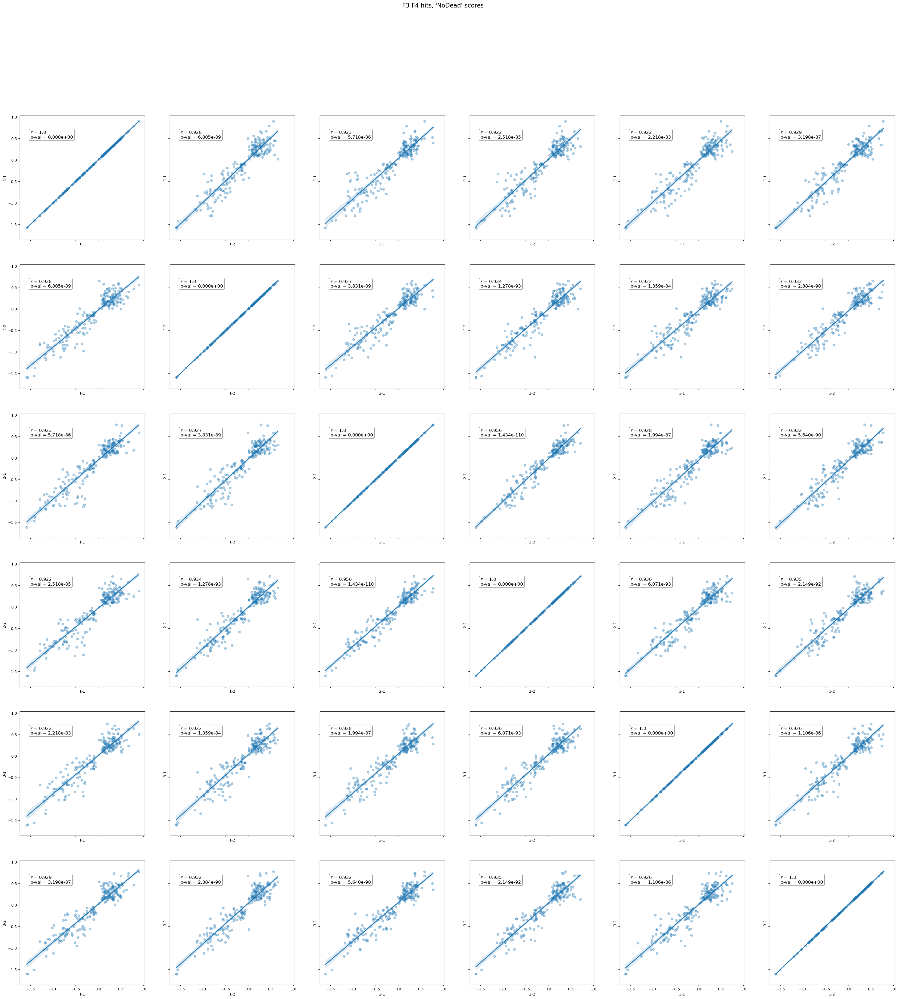

In [200]:
# 4) F3F4 hits, using "NoDead" scores
NoDead_F3F4_comp = no_out_NoDead_corr.loc[list(hits_NoDead),:].copy()

# Correlations for the 'all' dataset
fig, axs = plt.subplots(6, 6, figsize=(42, 42), sharex=True, sharey=True)
row = 0
col = 0

for lib_b in NoDead_F3F4_comp.columns:
    for lib_a in NoDead_F3F4_comp.columns:
        
        sns.regplot(data=NoDead_F3F4_comp, x=lib_a, y=lib_b, ax=axs[row, col], scatter_kws={'alpha':0.35})

        if lib_a == lib_b:
            coeff_calc = NoDead_F3F4_comp[[lib_a]].copy().dropna().reset_index(drop=True)
        else:
            coeff_calc = NoDead_F3F4_comp[[lib_a, lib_b]].copy().dropna().reset_index(drop=True)
            
        r_coeff = stats.pearsonr(coeff_calc[lib_a], coeff_calc[lib_b])
        axs[row, col].annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
                           (-1.5, 0.5), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)
        if col == 5:
            row += 1
            col = 0
        
        else:
            col += 1

fig.suptitle("F3-F4 hits, 'NoDead' scores", fontsize=16)

Diff_norm_corr = plt.gcf()
Diff_norm_corr.savefig('SortSeq_data/Corr_hits_F3F4_NoDead.png', bbox_inches='tight')

The correlations overall look pretty good! There is quite some noise within each cluster, but cluster membership is very well conserved between replicates.

Does it look equally good when comparing the 'NoDead' hits, but using the 'All' SortSeq scores?

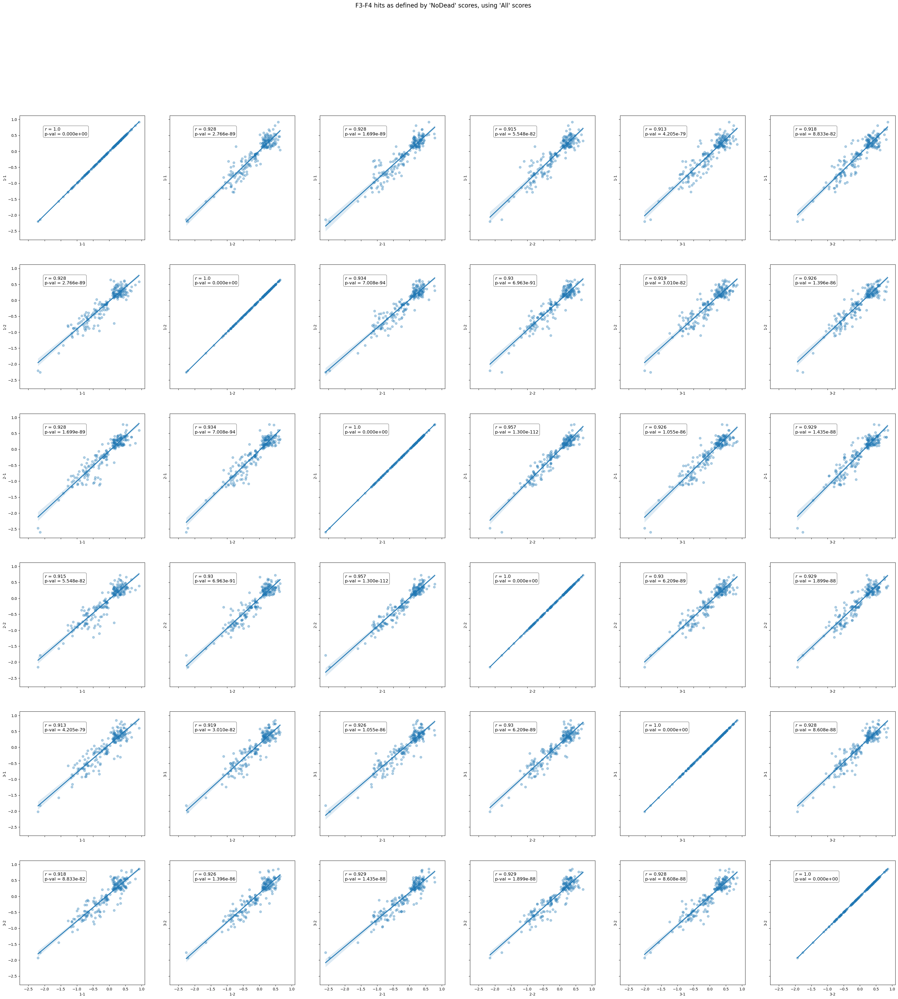

In [203]:
hits_F3F4_sel = no_out_all_corr.loc[list(hits_NoDead),:].copy()

# Correlations for the 'all' dataset
fig, axs = plt.subplots(6, 6, figsize=(42, 42), sharex=True, sharey=True)
row = 0
col = 0

for lib_b in hits_F3F4_sel.columns:
    for lib_a in hits_F3F4_sel.columns:
        
        sns.regplot(data=hits_F3F4_sel, x=lib_a, y=lib_b, ax=axs[row, col], scatter_kws={'alpha':0.35})

        if lib_a == lib_b:
            coeff_calc = hits_F3F4_sel[[lib_a]].copy().dropna().reset_index(drop=True)
        else:
            coeff_calc = hits_F3F4_sel[[lib_a, lib_b]].copy().dropna().reset_index(drop=True)
            
        r_coeff = stats.pearsonr(coeff_calc[lib_a], coeff_calc[lib_b])
        axs[row, col].annotate(r"$r$ = "f'{round(r_coeff[0], 3)}\np-val = {r_coeff[1]:.3e}',
                           (-2, 0.5), bbox=dict(boxstyle='round', fc='w', alpha=0.5), fontsize=12)
        if col == 5:
            row += 1
            col = 0
        
        else:
            col += 1

fig.suptitle("F3-F4 hits as defined by 'NoDead' scores, using 'All' scores", fontsize=16)

Diff_norm_corr = plt.gcf()
Diff_norm_corr.savefig('SortSeq_data/Corr_hits_F3F4_hybrid.png', bbox_inches='tight')

This looks similar to the previous plots.

### Compiling (and plotting) the final hits

- All genotypes which are hits according to the 'All' or 'NoDead' scores

In [207]:
hits_muts_NoDead = sort_NoDead_hits['Genotype'].unique()
hits_muts_all = sort_all_hits['Genotype'].unique()
all_to_keep = set(hits_muts_NoDead) | set(hits_muts_all)

In [208]:
# Assembling the dataframe
all_scores_data = sort_scores_all[sort_scores_all['Genotype'].isin(all_to_keep)].copy().reset_index(drop=True)
NoDead_scores_data = sort_scores_NoDead[sort_scores_NoDead['Genotype'].isin(all_to_keep)].copy().reset_index(drop=True)

final_sort_scores = pd.merge(all_scores_data, NoDead_scores_data, on=['Mutation type', 'Genotype', 'Position', 'FCY1_position', 'In_F3F4'],
                            how='outer', suffixes=('_All', '_NoDead'))

We also need to recompute medians, min and max scores by position, using the data without outliers

In [210]:
# For 'All' scores
delta_no_out_all = delta_no_out_all[delta_no_out_all['Genotype'] != 'WT'].copy().reset_index(drop=True)
bypos_final_all = delta_no_out_all.drop(columns=['Genotype', 'Lib_code', 'Median_diff_norm', 'Abs_med_diff_norm','MAD_diff_norm',
                                                 'n_MAD']).groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).median()
bypos_final_all = bypos_final_all.rename(columns={'Diff_bin_cell_norm': 'Median_delta_WT'})

bypos_min_all = delta_no_out_all.drop(columns=['Genotype', 'Lib_code', 'Median_diff_norm', 'Abs_med_diff_norm','MAD_diff_norm',
                                                 'n_MAD']).groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).min()
bypos_min_all = bypos_min_all.rename(columns={'Diff_bin_cell_norm': 'Min_delta_WT'})

bypos_max_all = delta_no_out_all.drop(columns=['Genotype', 'Lib_code', 'Median_diff_norm', 'Abs_med_diff_norm','MAD_diff_norm',
                                                 'n_MAD']).groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).max()
bypos_max_all = bypos_max_all.rename(columns={'Diff_bin_cell_norm': 'Max_delta_WT'})

bypos_final_all = pd.merge(bypos_final_all, bypos_min_all, on=['Mutation type', 'Position', 'In_F3F4'], how='outer')
bypos_final_all = pd.merge(bypos_final_all, bypos_max_all, on=['Mutation type', 'Position', 'In_F3F4'], how='outer')

bypos_final_all['FCY1_position'] = bypos_final_all['Position'] - 205 + 1*(bypos_final_all['Mutation type'] == 'Insertion')

In [211]:
# For 'NoDead' scores
delta_no_out_NoDead = delta_no_out_NoDead[delta_no_out_NoDead['Genotype'] != 'WT'].copy().reset_index(drop=True)
bypos_final_NoDead = delta_no_out_NoDead.drop(columns=['Genotype', 'Lib_code', 'Median_diff_NoDead', 'Abs_med_diff_NoDead','MAD_diff_NoDead',
                                                       'n_MAD']).groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).median()
bypos_final_NoDead = bypos_final_NoDead.rename(columns={'Diff_norm_NoDead': 'Median_delta_WT_NoDead'})

bypos_min_NoDead = delta_no_out_NoDead.drop(columns=['Genotype', 'Lib_code', 'Median_diff_NoDead', 'Abs_med_diff_NoDead','MAD_diff_NoDead',
                                                     'n_MAD']).groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).min()
bypos_min_NoDead = bypos_min_NoDead.rename(columns={'Diff_norm_NoDead': 'Min_delta_WT_NoDead'})

bypos_max_NoDead = delta_no_out_NoDead.drop(columns=['Genotype', 'Lib_code', 'Median_diff_NoDead', 'Abs_med_diff_NoDead','MAD_diff_NoDead',
                                                     'n_MAD']).groupby(by=['Mutation type', 'Position', 'In_F3F4'], as_index=False).max()
bypos_max_NoDead = bypos_max_NoDead.rename(columns={'Diff_norm_NoDead': 'Max_delta_WT_NoDead'})

bypos_final_NoDead = pd.merge(bypos_final_NoDead, bypos_min_NoDead, on=['Mutation type', 'Position', 'In_F3F4'], how='outer')
bypos_final_NoDead = pd.merge(bypos_final_NoDead, bypos_max_NoDead, on=['Mutation type', 'Position', 'In_F3F4'], how='outer')

bypos_final_NoDead['FCY1_position'] = bypos_final_NoDead['Position'] - 205 + 1*(bypos_final_NoDead['Mutation type'] == 'Insertion')

#### Generating figures

In [213]:
# Subsets for plotting median scores of hits
mut_sub = final_sort_scores[final_sort_scores['Mutation type'] == 'Substitution'].copy().reset_index(drop=True).infer_objects()
mut_ins = final_sort_scores[final_sort_scores['Mutation type'] == 'Insertion'].copy().reset_index(drop=True).infer_objects()
mut_del = final_sort_scores[final_sort_scores['Mutation type'] == 'Deletion'].copy().reset_index(drop=True).infer_objects()

In [214]:
# For error bars, by position rather than by mutation
sub_pos_all = bypos_final_all[bypos_final_all['Mutation type'] == 'Substitution'].copy().reset_index(drop=True).infer_objects()
ins_pos_all = bypos_final_all[bypos_final_all['Mutation type'] == 'Insertion'].copy().reset_index(drop=True).infer_objects()
del_pos_all = bypos_final_all[bypos_final_all['Mutation type'] == 'Deletion'].copy().reset_index(drop=True).infer_objects()

# Preparing the error bars, showing min and max measurements
sub_errors = np.array([sub_pos_all['Median_delta_WT'] - sub_pos_all['Min_delta_WT'],
                       sub_pos_all['Max_delta_WT'] - sub_pos_all['Median_delta_WT']])
ins_errors = np.array([ins_pos_all['Median_delta_WT'] - ins_pos_all['Min_delta_WT'],
                       ins_pos_all['Max_delta_WT'] - ins_pos_all['Median_delta_WT']])
del_errors = np.array([del_pos_all['Median_delta_WT'] - del_pos_all['Min_delta_WT'],
                       del_pos_all['Max_delta_WT'] - del_pos_all['Median_delta_WT']])

Text(54.5, -3.55, 'mEGFP')

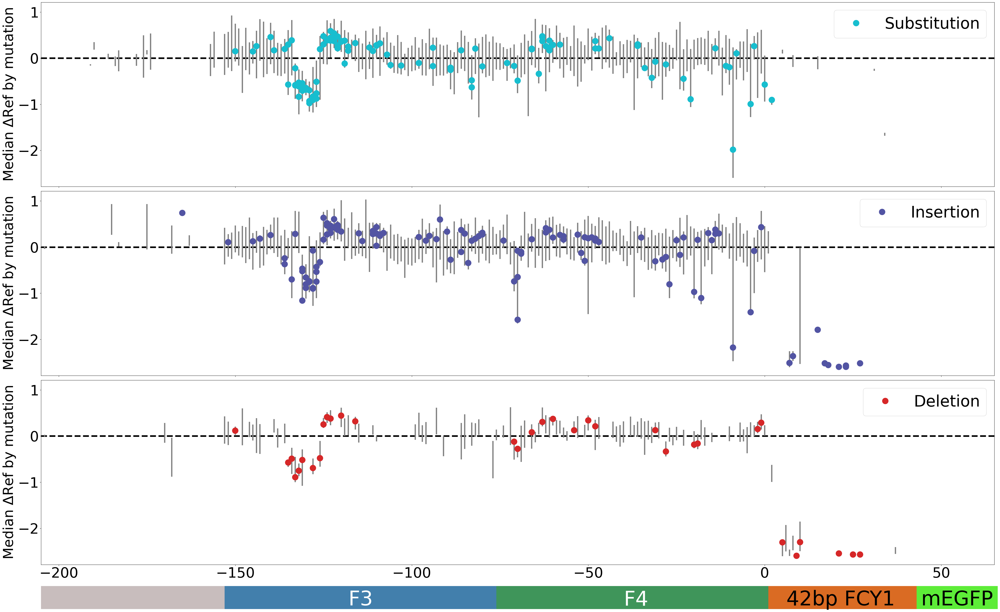

In [215]:
# Figure using the 'All' scores

fig, axs = plt.subplots(3, 1, figsize=(44, 27), sharex=True, sharey=True, tight_layout=True)

plot1 = sns.scatterplot(data=mut_sub, x='FCY1_position', y='Median_delta_WT', hue='Mutation type', ax=axs[0], palette=mut_palette, s=marker_size, edgecolor='none')
plot1.legend(fontsize=legend_size)
axs[0].errorbar(sub_pos_all['FCY1_position'], sub_pos_all['Median_delta_WT'], yerr=sub_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)

plot2 = sns.scatterplot(data=mut_ins, x='FCY1_position', y='Median_delta_WT', hue='Mutation type', ax=axs[1], palette=mut_palette, s=marker_size, edgecolor='none')
plot2.legend(fontsize=legend_size)
axs[1].errorbar(ins_pos_all['FCY1_position'], ins_pos_all['Median_delta_WT'], yerr=ins_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)

plot3 = sns.scatterplot(data=mut_del, x='FCY1_position', y='Median_delta_WT', hue='Mutation type', ax=axs[2], palette=mut_palette, s=marker_size, edgecolor='none')
plot3.legend(fontsize=legend_size)
axs[2].errorbar(del_pos_all['FCY1_position'], del_pos_all['Median_delta_WT'], yerr=del_errors, fmt='none', zorder=0, ecolor='grey', linewidth=error_width)


for ax in [axs[0], axs[1], axs[2]]:
    ax.axhline(y=0, c='black', linestyle='--', zorder=-1, linewidth=baseline_width)
    ax.set_xlim(left=-205, right=65)
    ax.set_ylabel(r"Median $\Delta$Ref by mutation", fontsize=ax_lab_size)
    ax.tick_params(axis='both', which='major', labelsize=ticks_size)
    ax.set_xlabel('')

# Adding rectangles to identify regions
axs[2].add_patch(Rectangle((-153, -3.25), 77, -0.5, facecolor='#427fac', edgecolor=None, clip_on=False))  # F3

axs[2].add_patch(Rectangle((-76, -3.25), 77, -0.5, facecolor='#3f955a', edgecolor=None, clip_on=False))  # F4

axs[2].add_patch(Rectangle((1, -3.25), 42, -0.5, facecolor='#d45400dc', edgecolor=None, clip_on=False))  # FCY1 CDS

axs[2].add_patch(Rectangle((43, -3.25), 23, -0.5, facecolor='#5dec38', edgecolor=None, clip_on=False)) # mEGFP

axs[2].add_patch(Rectangle((-205, -3.25), 52, -0.5, facecolor='#c8bdbd', edgecolor=None, clip_on=False))  # Intergenic region

# Annotations
axs[2].annotate('F3', (-114.5, -3.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('F4', (-36.5, -3.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('42bp FCY1', (21.5, -3.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

axs[2].annotate('mEGFP', (54.5, -3.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

Repeating the same figure using 'NoDead' scores:

In [217]:
# For error bars, by position rather than by mutation
sub_pos_NoDead = bypos_final_NoDead[bypos_final_NoDead['Mutation type'] == 'Substitution'].copy().reset_index(drop=True).infer_objects()
ins_pos_NoDead = bypos_final_NoDead[bypos_final_NoDead['Mutation type'] == 'Insertion'].copy().reset_index(drop=True).infer_objects()
del_pos_NoDead = bypos_final_NoDead[bypos_final_NoDead['Mutation type'] == 'Deletion'].copy().reset_index(drop=True).infer_objects()

# Preparing the error bars, showing min and max measurements
sub_errors = np.array([sub_pos_NoDead['Median_delta_WT_NoDead'] - sub_pos_NoDead['Min_delta_WT_NoDead'],
                       sub_pos_NoDead['Max_delta_WT_NoDead'] - sub_pos_NoDead['Median_delta_WT_NoDead']])
ins_errors = np.array([ins_pos_NoDead['Median_delta_WT_NoDead'] - ins_pos_NoDead['Min_delta_WT_NoDead'],
                       ins_pos_NoDead['Max_delta_WT_NoDead'] - ins_pos_NoDead['Median_delta_WT_NoDead']])
del_errors = np.array([del_pos_NoDead['Median_delta_WT_NoDead'] - del_pos_NoDead['Min_delta_WT_NoDead'],
                       del_pos_NoDead['Max_delta_WT_NoDead'] - del_pos_NoDead['Median_delta_WT_NoDead']])

Text(54.5, -3.55, 'mEGFP')

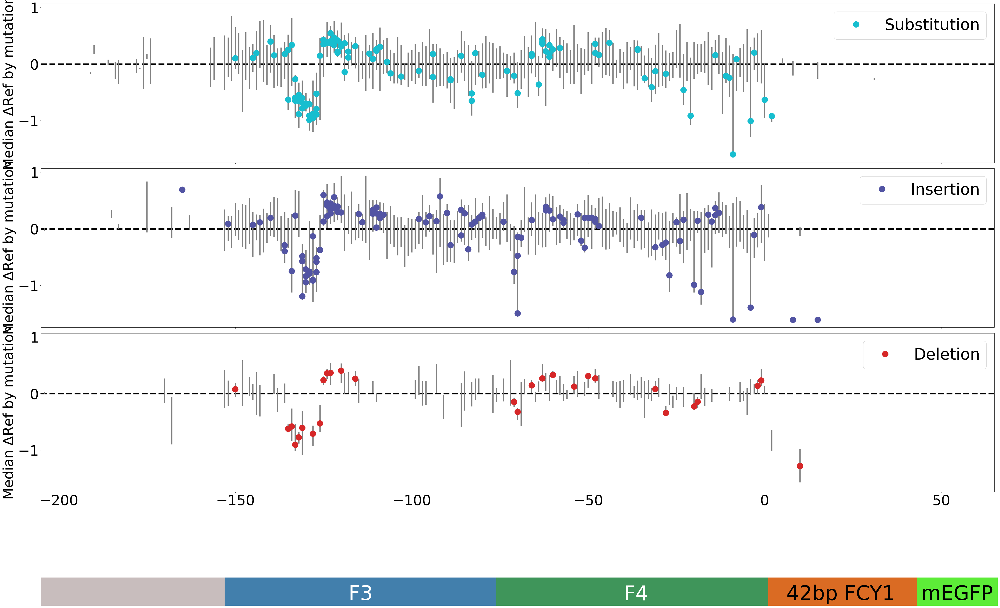

In [218]:
# Figure using the 'NoDead' scores

fig, axs = plt.subplots(3, 1, figsize=(44, 27), sharex=True, sharey=True, tight_layout=True)

plot1 = sns.scatterplot(data=mut_sub, x='FCY1_position', y='Median_delta_WT_NoDead', hue='Mutation type', ax=axs[0], palette=mut_palette, 
                        s=marker_size, edgecolor='none')
plot1.legend(fontsize=legend_size)
axs[0].errorbar(sub_pos_NoDead['FCY1_position'], sub_pos_NoDead['Median_delta_WT_NoDead'], yerr=sub_errors, fmt='none', zorder=0, ecolor='grey', 
                linewidth=error_width)

plot2 = sns.scatterplot(data=mut_ins, x='FCY1_position', y='Median_delta_WT_NoDead', hue='Mutation type', ax=axs[1], palette=mut_palette, 
                        s=marker_size, edgecolor='none')
plot2.legend(fontsize=legend_size)
axs[1].errorbar(ins_pos_NoDead['FCY1_position'], ins_pos_NoDead['Median_delta_WT_NoDead'], yerr=ins_errors, fmt='none', zorder=0, ecolor='grey',
                linewidth=error_width)

plot3 = sns.scatterplot(data=mut_del, x='FCY1_position', y='Median_delta_WT_NoDead', hue='Mutation type', ax=axs[2], palette=mut_palette,
                        s=marker_size, edgecolor='none')
plot3.legend(fontsize=legend_size)
axs[2].errorbar(del_pos_NoDead['FCY1_position'], del_pos_NoDead['Median_delta_WT_NoDead'], yerr=del_errors, fmt='none', zorder=0, ecolor='grey',
                linewidth=error_width)


for ax in [axs[0], axs[1], axs[2]]:
    ax.axhline(y=0, c='black', linestyle='--', zorder=-1, linewidth=baseline_width)
    ax.set_xlim(left=-205, right=65)
    ax.set_ylabel(r"Median $\Delta$Ref by mutation", fontsize=ax_lab_size)
    ax.tick_params(axis='both', which='major', labelsize=ticks_size)
    ax.set_xlabel('')

# Adding rectangles to identify regions
axs[2].add_patch(Rectangle((-153, -3.25), 77, -0.5, facecolor='#427fac', edgecolor=None, clip_on=False))  # F3

axs[2].add_patch(Rectangle((-76, -3.25), 77, -0.5, facecolor='#3f955a', edgecolor=None, clip_on=False))  # F4

axs[2].add_patch(Rectangle((1, -3.25), 42, -0.5, facecolor='#d45400dc', edgecolor=None, clip_on=False))  # FCY1 CDS

axs[2].add_patch(Rectangle((43, -3.25), 23, -0.5, facecolor='#5dec38', edgecolor=None, clip_on=False)) # mEGFP

axs[2].add_patch(Rectangle((-205, -3.25), 52, -0.5, facecolor='#c8bdbd', edgecolor=None, clip_on=False))  # Intergenic region

# Annotations
axs[2].annotate('F3', (-114.5, -3.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('F4', (-36.5, -3.55), va="center", ha="center", 
                fontsize=64, color='white', annotation_clip=False)

axs[2].annotate('42bp FCY1', (21.5, -3.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

axs[2].annotate('mEGFP', (54.5, -3.55), va="center", ha="center", 
                fontsize=64, color='black', annotation_clip=False)

Because both figures suggest that some outlier replicates have not been removed, a better approach might to show the min and max of MEDIANS at each position, by type. This is however not applicable to deletions, because there is only one possible mutation by position. 

## Exporting the final datasets

In [248]:
# Scores for all hits
final_sort_scores.to_csv("Supp_data/SortSeq_hits.csv", index=False)

# Median scores for all genotypes, after outlier removal
sort_scores_all.to_csv("Supp_data/Sort_scores_all.csv", index=False)
sort_scores_NoDead.to_csv("Supp_data/Sort_scores_NoDead.csv", index=False)

# All replicate scores for each genotype, after outlier removal
delta_no_out_all.to_csv("Supp_data/Sort_scores_by_rep_all.csv", index=False)
delta_no_out_NoDead.to_csv("Supp_data/Sort_scores_by_rep_NoDead.csv", index=False)

In [344]:
final_sort_scores

,Mutation type,Genotype,Position,In_F3F4,Median_delta_WT,Min_delta_WT,Max_delta_WT,not_zero_p-val_All,n_observed_All,FCY1_position,not_zero_FDR_All,Median_delta_WT_NoDead,Min_delta_WT_NoDead,Max_delta_WT_NoDead,not_zero_p-val_NoDead,n_observed_NoDead,not_zero_FDR_NoDead
0,Deletion,D-134_1nt_Gto-,134.0,True,-0.122148,-0.509057,-0.079399,0.036231,6.0,-71.0,0.106802,-0.146158,-0.235878,-0.068891,0.002525,6.0,0.019895
1,Deletion,D-135_1nt_Ato-,135.0,True,-0.277344,-0.460775,-0.238876,0.000238,6.0,-70.0,0.004328,-0.324368,-0.472416,-0.258539,0.000135,6.0,0.003042
2,Deletion,D-139_1nt_Tto-,139.0,True,0.082213,-0.273033,0.254537,0.911264,6.0,-66.0,0.938375,0.145740,0.015468,0.237478,0.005682,6.0,0.032647
3,Deletion,D-142_1nt_Gto-,142.0,True,0.306357,0.211038,0.621774,0.002214,6.0,-63.0,0.018134,0.268631,0.197646,0.523785,0.001527,6.0,0.014529
4,Deletion,D-145_1nt_Cto-,145.0,True,0.372142,0.229561,0.437664,0.000131,6.0,-60.0,0.003003,0.332325,0.279051,0.405098,0.000011,6.0,0.000723
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
219,Substitution,S-93_1nt_TtoG,93.0,True,0.230647,0.132099,0.289237,0.000232,6.0,-112.0,0.004328,0.183489,0.115594,0.221582,0.000145,6.0,0.003121
220,Substitution,S-95_1nt_TtoA,95.0,True,0.270177,0.158793,0.344658,0.000255,6.0,-110.0,0.004489,0.232058,0.139130,0.275307,0.000101,6.0,0.002719
221,Substitution,S-95_1nt_TtoG,95.0,True,0.279881,0.099320,0.503117,0.006196,6.0,-110.0,0.035794,0.261519,0.093005,0.420367,0.003953,6.0,0.026090
222,Substitution,S-96_1nt_TtoG,96.0,True,0.320261,0.177078,0.389369,0.000119,6.0,-109.0,0.003003,0.302665,0.159041,0.310914,0.000125,6.0,0.002956


## Selecting validation mutants and generating the corresponding oligos

In [416]:
# Creating the dataframe which will be used
val_set = pd.DataFrame(columns=['Genotype', 'Mutation type', 'FCY1_position', 'Group'])

Throughout, the lines initially used to select randomly the variants are replaced with the explicit selection of the genotypes which have been reconstructed

### A) Adding the two pairs of indels

Two before and after the second methionine, selected using the 'NoDead' scores

In [420]:
# Indels before the second methionine
CDS_before = sort_scores_all[(sort_scores_all['FCY1_position'] < 16) & (sort_scores_all['FCY1_position'] > 0)].copy().reset_index(drop=True)
CDS_before = CDS_before[(CDS_before['Mutation type'] == 'Insertion') | (CDS_before['Mutation type'] == 'Deletion')].copy().reset_index(drop=True)
CDS_before = CDS_before[CDS_before['not_zero_FDR'] < 0.05].copy().reset_index(drop=True)

#two_indels = np.random.choice(CDS_before.index, size=2, replace=False)
#two_to_add = CDS_before.iloc[np.r_[two_indels], :].copy().reset_index(drop=True)
two_indels = ['D-215_1nt_Gto-', 'I-211_1nt_-toA']
two_to_add = CDS_before[CDS_before['Genotype'].isin(two_indels)].copy().reset_index(drop=True)


two_to_add = two_to_add[['Genotype', 'Mutation type', 'FCY1_position']].copy()
two_to_add['Group'] = 'CDS_before'

val_set = pd.concat([val_set, two_to_add]).reset_index(drop=True)

C:\Users\tiger\AppData\Local\Temp\ipykernel_40172\3168368914.py:15: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  val_set = pd.concat([val_set, two_to_add]).reset_index(drop=True)


In [421]:
two_to_add

,Genotype,Mutation type,FCY1_position,Group
0,D-215_1nt_Gto-,Deletion,10.0,CDS_before
1,I-211_1nt_-toA,Insertion,7.0,CDS_before


In [422]:
# Indels after the second methionine
CDS_after = sort_scores_all[(sort_scores_all['FCY1_position'] >= 16) & (sort_scores_all['FCY1_position'] <= 42)].copy().reset_index(drop=True)
CDS_after = CDS_after[(CDS_after['Mutation type'] == 'Insertion') | (CDS_after['Mutation type'] == 'Deletion')].copy().reset_index(drop=True)
CDS_after = CDS_after[CDS_after['not_zero_FDR'] < 0.05].copy().reset_index(drop=True)

#two_after = np.random.choice(CDS_after.index, size=2, replace=False)
#after_to_add = CDS_after.iloc[np.r_[two_after], :].copy().reset_index(drop=True)

two_after = ['I-231_1nt_-toG', 'I-225_1nt_-toA']
after_to_add = CDS_after[CDS_after['Genotype'].isin(two_after)].copy().reset_index(drop=True)


after_to_add = after_to_add[['Genotype', 'Mutation type', 'FCY1_position']].copy()
after_to_add['Group'] = 'CDS_after'

val_set = pd.concat([val_set, after_to_add]).reset_index(drop=True)

In [423]:
val_set

,Genotype,Mutation type,FCY1_position,Group
0,D-215_1nt_Gto-,Deletion,10.0,CDS_before
1,I-211_1nt_-toA,Insertion,7.0,CDS_before
2,I-225_1nt_-toA,Insertion,21.0,CDS_after
3,I-231_1nt_-toG,Insertion,27.0,CDS_after


### B) Adding the variants which **decrease** expression

In [425]:
# Three variants close to the TSS
# The three lowest score between positions -50 and 0 are chosen
# This is done using scores with the dead bin
low_TSS = sort_scores_all[(sort_scores_all['FCY1_position'] >= -50) & (sort_scores_all['FCY1_position'] <= 0)].copy().reset_index(drop=True)
low_TSS = low_TSS[low_TSS['not_zero_FDR'] < 0.05].copy().reset_index(drop=True)

low_TSS = low_TSS.sort_values(by='Median_delta_WT', ascending=True).copy().reset_index(drop=True)
TSS_to_add = low_TSS.iloc[0:3, :].copy()

TSS_to_add = TSS_to_add[['Genotype', 'Mutation type', 'FCY1_position']].copy()
TSS_to_add['Group'] = 'TSS_decrease'

val_set = pd.concat([val_set, TSS_to_add]).reset_index(drop=True)

In [426]:
val_set

,Genotype,Mutation type,FCY1_position,Group
0,D-215_1nt_Gto-,Deletion,10.0,CDS_before
1,I-211_1nt_-toA,Insertion,7.0,CDS_before
2,I-225_1nt_-toA,Insertion,21.0,CDS_after
3,I-231_1nt_-toG,Insertion,27.0,CDS_after
4,I-195_1nt_-toG,Insertion,-9.0,TSS_decrease
5,S-196_1nt_TtoG,Substitution,-9.0,TSS_decrease
6,I-200_1nt_-toG,Insertion,-4.0,TSS_decrease


Then, for the following variants, the scores **without** the 'dead' bin are used:

In [428]:
# Six substitutions in the region -133 to -127 (inclusively)
low_TFBS = sort_scores_NoDead[(sort_scores_NoDead['FCY1_position'] >= -133) & (sort_scores_NoDead['FCY1_position'] <= -127)].copy().reset_index(drop=True)
low_TFBS = low_TFBS[low_TFBS['Mutation type'] == 'Substitution'].copy().reset_index(drop=True)
low_TFBS = low_TFBS[low_TFBS['not_zero_FDR'] < 0.05].copy().reset_index(drop=True)

#six_low = np.random.choice(low_TFBS.index, size=6, replace=False)
#six_to_add = low_TFBS.iloc[np.r_[six_low], :].copy().reset_index(drop=True)

six_low = ['S-78_1nt_GtoC', 'S-72_1nt_TtoC', 'S-73_1nt_AtoC',
           'S-75_1nt_CtoT', 'S-74_1nt_CtoA', 'S-73_1nt_AtoG']
six_to_add = low_TFBS[low_TFBS['Genotype'].isin(six_low)].copy().reset_index(drop=True)

six_to_add = six_to_add[['Genotype', 'Mutation type', 'FCY1_position']].copy()
six_to_add['Group'] = 'TFBS_decrease'

val_set = pd.concat([val_set, six_to_add]).reset_index(drop=True)

In [429]:
# Two substitutions in th -11 to -45 region
low_near_TSS = sort_scores_NoDead[(sort_scores_NoDead['FCY1_position'] >= -45) & (sort_scores_NoDead['FCY1_position'] <= -11)].copy().reset_index(drop=True)
low_near_TSS = low_near_TSS[low_near_TSS['not_zero_FDR'] < 0.05].copy().reset_index(drop=True)
low_near_TSS = low_near_TSS[low_near_TSS['Mutation type'] == 'Substitution'].copy().reset_index(drop=True)

#two_near = np.random.choice(low_near_TSS.index, size=2, replace=False)
#two_near_add = low_near_TSS.iloc[np.r_[two_near], :].copy().reset_index(drop=True)

two_near = ['S-171_1nt_AtoC', 'S-174_1nt_GtoT']
two_near_add = low_near_TSS[low_near_TSS['Genotype'].isin(two_near)].copy().reset_index(drop=True)

two_near_add = two_near_add[['Genotype', 'Mutation type', 'FCY1_position']].copy()
two_near_add['Group'] = 'Near_TSS_deacrease'

val_set = pd.concat([val_set, two_near_add]).reset_index(drop=True)

In [430]:
# One substitution and one insertion near -75
near_75 = sort_scores_NoDead[(sort_scores_NoDead['FCY1_position'] >= -75) & (sort_scores_NoDead['FCY1_position'] <= -69)].copy().reset_index(drop=True)
near_75 = near_75[near_75['not_zero_FDR'] < 0.05].copy().reset_index(drop=True)

# Selecting the substitution
near_75_sub = near_75[near_75['Mutation type'] == 'Substitution'].copy().reset_index(drop=True)
near_75_sub = near_75_sub.sort_values(by='Median_delta_WT_NoDead', ascending=True).copy().reset_index(drop=True)
near_75_sub = near_75_sub[0:1].copy()
near_75_sub = near_75_sub[['Genotype', 'Mutation type', 'FCY1_position']].copy()
near_75_sub['Group'] = 'Near_75_decrease'

# Selecting the insertion
near_75_ins = near_75[near_75['Mutation type'] == 'Insertion'].copy().reset_index(drop=True)
near_75_ins = near_75_ins.sort_values(by='Median_delta_WT_NoDead', ascending=True).copy().reset_index(drop=True)
near_75_ins = near_75_ins[0:1].copy()
near_75_ins = near_75_ins[['Genotype', 'Mutation type', 'FCY1_position']].copy()
near_75_ins['Group'] = 'Near_75_decrease'

val_set = pd.concat([val_set, near_75_sub, near_75_ins]).reset_index(drop=True)

In [431]:
# Two significant substitutions outside of positions with many impactful variants
two_low = ['S-99_1nt_TtoG', 'S-116_1nt_AtoT']
two_low_to_add = sort_scores_NoDead[sort_scores_NoDead['Genotype'].isin(two_low)].copy().reset_index(drop=True)
two_low_to_add = two_low_to_add[['Genotype', 'Mutation type', 'FCY1_position']].copy()
two_low_to_add['Group'] = 'Outside_decrease'

val_set = pd.concat([val_set, two_low_to_add]).reset_index(drop=True)

### C) Adding variants which **increase** expression

Again, using scores **without** the 'dead' bin

In [434]:
# Four substitutions within the -125 to -118 region
high_TFBS = sort_scores_NoDead[(sort_scores_NoDead['FCY1_position'] >= -125) & (sort_scores_NoDead['FCY1_position'] <= -118)].copy().reset_index(drop=True)
high_TFBS = high_TFBS[high_TFBS['Median_delta_WT_NoDead'] > 0].copy().reset_index(drop=True)
high_TFBS = high_TFBS[high_TFBS['Mutation type'] == 'Substitution'].copy().reset_index(drop=True)
high_TFBS = high_TFBS[high_TFBS['not_zero_FDR'] < 0.05].copy().reset_index(drop=True)

#four_high = np.random.choice(high_TFBS.index, size=4, replace=False)
#high_to_add = high_TFBS.iloc[np.r_[four_high], :].copy().reset_index(drop=True)

four_high = ['S-87_1nt_AtoT', 'S-85_1nt_TtoA', 'S-82_1nt_CtoG', 'S-80_1nt_GtoC']
high_to_add = high_TFBS[high_TFBS['Genotype'].isin(four_high)].copy().reset_index(drop=True)[['Genotype', 'Mutation type', 'FCY1_position']]
high_to_add['Group'] = 'TFBS_increase'

val_set = pd.concat([val_set, high_to_add]).reset_index(drop=True)

In [435]:
# Two substitutions in the -112 to -109 region
high_reg1 = sort_scores_NoDead[(sort_scores_NoDead['FCY1_position'] >= -112) & (sort_scores_NoDead['FCY1_position'] <= -109)].copy().reset_index(drop=True)
high_reg1 = high_reg1[high_reg1['Median_delta_WT_NoDead'] > 0].copy().reset_index(drop=True)
high_reg1 = high_reg1[high_reg1['Mutation type'] == 'Substitution'].copy().reset_index(drop=True)
high_reg1 = high_reg1[high_reg1['not_zero_FDR'] < 0.05].copy().reset_index(drop=True)

#two_high1 = np.random.choice(high_reg1.index, size=2, replace=False)
#high_two_1 = high_reg1.iloc[np.r_[two_high1], :].copy().reset_index(drop=True)
two_high1 = ['S-93_1nt_TtoG', 'S-95_1nt_TtoG']
high_two_1 = high_reg1[high_reg1['Genotype'].isin(two_high1)].copy().reset_index(drop=True)

high_two_1 = high_two_1[['Genotype', 'Mutation type', 'FCY1_position']].copy()
high_two_1['Group'] = 'Reg1_increase'

val_set = pd.concat([val_set, high_two_1]).reset_index(drop=True)

In [453]:
# Two substitutions in the -63 to -57 region
high_reg2 = sort_scores_NoDead[(sort_scores_NoDead['FCY1_position'] >= -63) & (sort_scores_NoDead['FCY1_position'] <= -57)].copy().reset_index(drop=True)
high_reg2 = high_reg2[high_reg2['Median_delta_WT_NoDead'] > 0].copy().reset_index(drop=True)
high_reg2 = high_reg2[high_reg2['Mutation type'] == 'Substitution'].copy().reset_index(drop=True)
high_reg2 = high_reg2[high_reg2['not_zero_FDR'] < 0.05].copy().reset_index(drop=True)

#two_high2= np.random.choice(high_reg2.index, size=2, replace=False)
#high_two_2 = high_reg2.iloc[np.r_[two_high2], :].copy().reset_index(drop=True)
two_high2 = ['S-147_1nt_AtoT', 'S-144_1nt_TtoG']
high_two_2 = high_reg2[high_reg2['Genotype'].isin(two_high2)].copy().reset_index(drop=True)

high_two_2 = high_two_2[['Genotype', 'Mutation type', 'FCY1_position']].copy()
high_two_2['Group'] = 'Reg2_increase'

val_set = pd.concat([val_set, high_two_2]).reset_index(drop=True)

In [458]:
# Adding four "top hits" (highest scores)
top_increase = sort_scores_NoDead.sort_values(by='Median_delta_WT_NoDead', ascending=False).head(25).copy().reset_index(drop=True)
top_hits = top_increase[['Genotype', 'Mutation type', 'FCY1_position']].copy()
#for i in range(4):
    #hit_index = np.random.choice(range(25))
    #df_current = top_hits[hit_index:hit_index+1].copy().reset_index(drop=True)

    #current_genotype = df_current.at[0, 'Genotype']

    #if current_genotype in val_set['Genotype'].unique():

        #while current_genotype in val_set['Genotype'].unique():
            #hit_index = np.random.choice(range(25))
            #df_current = top_hits[hit_index:hit_index+1].copy().reset_index(drop=True)
            #current_genotype = df_current.at[0, 'Genotype']
    

    #df_current['Group'] = 'Top_increase'

    #val_set = pd.concat([val_set, df_current]).reset_index(drop=True)

top_4 = ['I-79_1nt_-toT', 'I-80_1nt_-toC', 'I-142_1nt_-toA', 'S-142_1nt_GtoA']
top4_to_add = top_hits[top_hits['Genotype'].isin(top_4)].copy().reset_index(drop=True)

top4_to_add = top4_to_add[['Genotype', 'Mutation type', 'FCY1_position']]
top4_to_add['Group'] = 'Top_increase'

val_set = pd.concat([val_set, top4_to_add]).reset_index(drop=True)

### Exporting the complete set of validation mutants

In [470]:
data_withval = final_sort_scores[['Genotype', 'Mutation type', 'FCY1_position', 'In_F3F4', 'Median_delta_WT',
                                  'Min_delta_WT', 'Max_delta_WT', 'not_zero_p-val_All', 'n_observed_All',
                                  'not_zero_FDR_All', 'Median_delta_WT_NoDead', 'Min_delta_WT_NoDead',
                                  'Max_delta_WT_NoDead', 'not_zero_p-val_NoDead', 'n_observed_NoDead',
                                  'not_zero_FDR_NoDead']].copy()
val_full = pd.merge(val_set, data_withval, on=['Genotype', 'FCY1_position', 'Mutation type'])

In [475]:
#val_full.to_csv("Supp_data/Sort_seq_val_muts_25-03-19_SA.csv", index=None)

### Generating the primers for PCR fusion

In [516]:
val_full = pd.read_csv("Supp_data/Sort_seq_val_muts_25-03-19_SA.csv")

In [518]:
len(list(val_full['Genotype'].unique())) == val_full.shape[0]

True

There are no duplicates in the set variants, so the oligos can be designed

In [521]:
val_oligos = val_full[['Genotype', 'Mutation type', 'FCY1_position', 'Group']].copy()
val_oligos['F_fusion'] = ''
val_oligos['R_fusion'] = ''

In [523]:
# Importing the reference sequence for the F3F4-42bp-mEGFP background
ref_dict = {}
with open("SortSeq_data/ref_SortSeq_25-02-18.fa") as ref_fasta:
    
    for line in ref_fasta:
        if line[0] == ">":
            seq_name = line[1:-1]
            continue
        else:
            ref_dict[seq_name] = line

In [507]:
ref_dict

{'F3F4_42bp_mEGFP': 'TTTGTTAATTATACTGTCGCTGTAATATCTTCTCTTCCATTATCACCGGTCATTCCTTGCAGGGGCGGTAGTACCCGGAGACCCTGAACTTTTCTTTTTTTTTTTGCGAAATTAAAAAGTTCATTTTCAATTCGACAATGAGATCTACAAGCCATTGTTTTATGTTGATGAGAGCCAGCTTAAAGAGTTAAAAATTTCATAGCTAATGGTGACAGGGGGAATGGCAAGCAAGTGGGATCAGAAGGGTGTTTCCAAGGGTGAAGAACTATTCACTGGTGTCGTCCCAATCTTGGTCGAATTGGACGGTGACGTCAACGGTCACAAGTTTTCAG'}

In [525]:
# Iterating along the rows of the dataframe to add the oligos
for row in range(val_oligos.shape[0]):
    var_group = val_oligos.at[row, 'Group']
    
    current_mut = val_oligos.at[row, 'Genotype']
    position_mut = int(current_mut.split('-')[1].split('_')[0])
    type_mut = current_mut[0]
    pos_0 = position_mut - 1

    mut_nt = current_mut.split('to')[1].lower()
    wt_nt = (ref_dict['F3F4_42bp_mEGFP'][pos_0])

    # Replacing the mut character by an empty string if it is '-'
    if mut_nt == '-':
        mut_nt = ''

    # Obtaining the 15 bp upstream and downstream of the mutated position
    nt_before = (ref_dict['F3F4_42bp_mEGFP'][pos_0-15:pos_0])
    nt_after = (ref_dict['F3F4_42bp_mEGFP'][pos_0+1:pos_0+16])

    # Generating the forward oligo
    if type_mut == 'I':
        oligo_f = nt_before + wt_nt + mut_nt + nt_after

    elif type_mut != 'I':
        oligo_f = nt_before + mut_nt + nt_after

    if len(oligo_f) == 32:
        oligo_f = oligo_f[1:]
        
    elif len(oligo_f) > 32:
        raise Exception('Forward oligos longer than 32 nt should not happen!')
        
    elif len(oligo_f) < 30:
        raise Exception('Forward oligos shorter than 30 nt should not happen!')

    # Generating the reverse oligo

    oligo_r = str(Seq(oligo_f).reverse_complement())

    val_oligos.at[row, 'F_fusion'] = oligo_f
    val_oligos.at[row, 'R_fusion'] = oligo_r

**Since the furthest variant in the CDS is at position 27, no GFP versions are needed!**

Two different PCR reactions will however be needed for the FCY1 and 42bp-mEGFP background, respectively

In [532]:
# Making a version of the dataframe showing both the new (300 paired-end) genotype string and
# the one previously assigned in 150 paired-end (for cybergreen search)
val_forPCR = val_oligos.copy()
val_forPCR = pd.merge(val_forPCR, val_full , how='left', on=['Genotype', 'Mutation type', 'FCY1_position', 'Group'])

val_forPCR = val_forPCR.rename(columns={'Genotype': 'Code_300_2025'})
val_forPCR['Code_150_2024'] = 'None'

# Obtaining the "old version" of mutation codes
for row in range(val_forPCR.shape[0]):
    new_code = val_forPCR.at[row, 'Code_300_2025']
    mut_type = new_code[0]
    mut_infos = new_code[2:].split('_')

    old_num = int(mut_infos[0]) - 31

    old_code = f'{mut_type}-{old_num}_{mut_infos[1]}_{mut_infos[2]}'

    val_forPCR.at[row, 'Code_150_2024'] = old_code

# Oligo sequences are converted to uppercase, since this is how they were written for the ordering
val_forPCR['F_fusion'] = val_forPCR['F_fusion'].apply(lambda x: x.upper())
val_forPCR['R_fusion'] = val_forPCR['R_fusion'].apply(lambda x: x.upper())

In [539]:
val_forPCR[['Code_300_2025', 'Code_150_2024', 'Mutation type', 'FCY1_position', 'Group', 'F_fusion',
           'R_fusion', 'In_F3F4', 'Median_delta_WT', 'Min_delta_WT', 'Max_delta_WT',
            'not_zero_p-val_All', 'n_observed_All', 'not_zero_FDR_All', 'Median_delta_WT_NoDead',
            'Min_delta_WT_NoDead', 'Max_delta_WT_NoDead', 'not_zero_p-val_NoDead', 'n_observed_NoDead',
            'not_zero_FDR_NoDead']].infer_objects().to_csv("Supp_data/Val_with_oligos_25-03-25_SA.csv", index=None)

In [537]:
val_forPCR.columns

Index(['Code_300_2025', 'Mutation type', 'FCY1_position', 'Group', 'F_fusion',
       'R_fusion', 'In_F3F4', 'Median_delta_WT', 'Min_delta_WT',
       'Max_delta_WT', 'not_zero_p-val_All', 'n_observed_All',
       'not_zero_FDR_All', 'Median_delta_WT_NoDead', 'Min_delta_WT_NoDead',
       'Max_delta_WT_NoDead', 'not_zero_p-val_NoDead', 'n_observed_NoDead',
       'not_zero_FDR_NoDead', 'Code_150_2024'],
      dtype='object')

**Preparing the file to order the oligos:**

In [546]:
oligos_model = pd.DataFrame(columns=['Sequence', 'Description', 'Concentration', 'Location', 'Position', 
                                     'Date', 'Person_in_charge', 'Reference'])

oligos_f = oligos_model.copy()
oligos_r = oligos_model.copy()

In [548]:
for row in range(val_oligos.shape[0]):
    seq_f = val_oligos.at[row, 'F_fusion'].upper()

    if len(seq_f) == 0:
        continue

    elif len(seq_f) != 0:
        seq_r = val_oligos.at[row, 'R_fusion'].upper()

        gen_code = val_oligos.at[row, 'Genotype']
        fcy1_pos = int(val_oligos.at[row, 'FCY1_position'])

        desc_f = (f"Oligo-F to reconstruct mutation {gen_code} at position {fcy1_pos} relative to FCY1/YPR062W by fusion PCR. "
                  f"The (1-based) position in the mutation code is relative to the region identifier 'SortSeq-Fragment' in the reference.")
        
        desc_r = (f"Oligo-R to reconstruct mutation {gen_code} at position {fcy1_pos} relative to FCY1/YPR062W by fusion PCR. "
                  f"The (1-based) position in the mutation code is relative to the region identifier 'SortSeq-Fragment' in the reference.")

        ref_string = 'In-house design. See https://benchling.com/s/seq-5nuJt0rl0v9c80ZNjwQM?m=slm-FRg5Hb8Vgq9BLyxjvmFm'

        # Adding the info to oligos_f
        current_f = oligos_model.copy()
        current_f.loc[0, :] = [seq_f, desc_f, np.NaN, np.NaN, np.NaN, np.NaN, 'Simon Aube', ref_string]
        oligos_f = pd.concat([oligos_f, current_f]).reset_index(drop=True)

        # Adding the info to oligos_r
        current_r = oligos_model.copy()
        current_r.loc[0, :] = [seq_r, desc_r, np.NaN, np.NaN, np.NaN, np.NaN, 'Simon Aube', ref_string]
        oligos_r = pd.concat([oligos_r, current_r]).reset_index(drop=True)

In [550]:
# Assembling the forwards and reverse in one df
oligos_order = pd.concat([oligos_f.loc[0:7, :], oligos_r.loc[0:7, :],
                          oligos_f.loc[8:15, :], oligos_r.loc[8:15, :],
                          oligos_f.loc[16:23, :], oligos_r.loc[16:23, :],
                          oligos_f.loc[24:, :], oligos_r.loc[24:, :]]).reset_index(drop=True)

oligos_order.to_csv("Supp_data/Oligos_val_order_25-03-19_SA.csv")